In [1]:
# Running in delfos BCDnet2

import numpy as np
import h5py
import matplotlib.pyplot as plt
import glob
from scipy.io import loadmat,savemat
import random
%matplotlib notebook

In [2]:
def od2rgb(od):
    rgb=np.clip(256*np.exp(-od)-1,0,255).astype('uint8')
    return rgb

def display_M(M):
    ns=M.shape[1]
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    plt.imshow(Mdisp)
    
# display_M(M)

M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

In [23]:
Data_root= '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al'#0_9

al='0_9'
tissue='Lung'
image='2'
patch='01'
mhfile=glob.glob(Data_root+al+'/'+tissue+'/'+image+'/'+patch+'/m_h*.mat')
mefile=glob.glob(Data_root+al+'/'+tissue+'/'+image+'/'+patch+'/m_e*.mat')
sig_hfile=glob.glob(Data_root+al+'/'+tissue+'/'+image+'/'+patch+'/sigma_h*.mat')
sig_efile=glob.glob(Data_root+al+'/'+tissue+'/'+image+'/'+patch+'/sigma_e*.mat')

In [3]:
def read_ysw(path):
    Data_root= '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al'#0_9

    mhfile=glob.glob(path+'/m_h*.mat')
    mefile=glob.glob(path+'/m_e*.mat')
    sig_hfile=glob.glob(path+'/sigma_h*.mat')
    sig_efile=glob.glob(path+'/sigma_e*.mat')
    
    m_h=loadmat(mhfile[0])['m_h_result'][0]
    m_e=loadmat(mefile[0])['m_e_result'][0]
    M=np.concatenate((m_h.reshape(3,1),m_e.reshape(3,1)),axis=1)
    
    s_h=loadmat(sig_hfile[0])['sigma_h_result'][0]
    s_e=loadmat(sig_efile[0])['sigma_e_result'][0]
    sigma= np.concatenate((s_h,s_e))
    
    return [M, sigma]

<IPython.core.display.Javascript object>


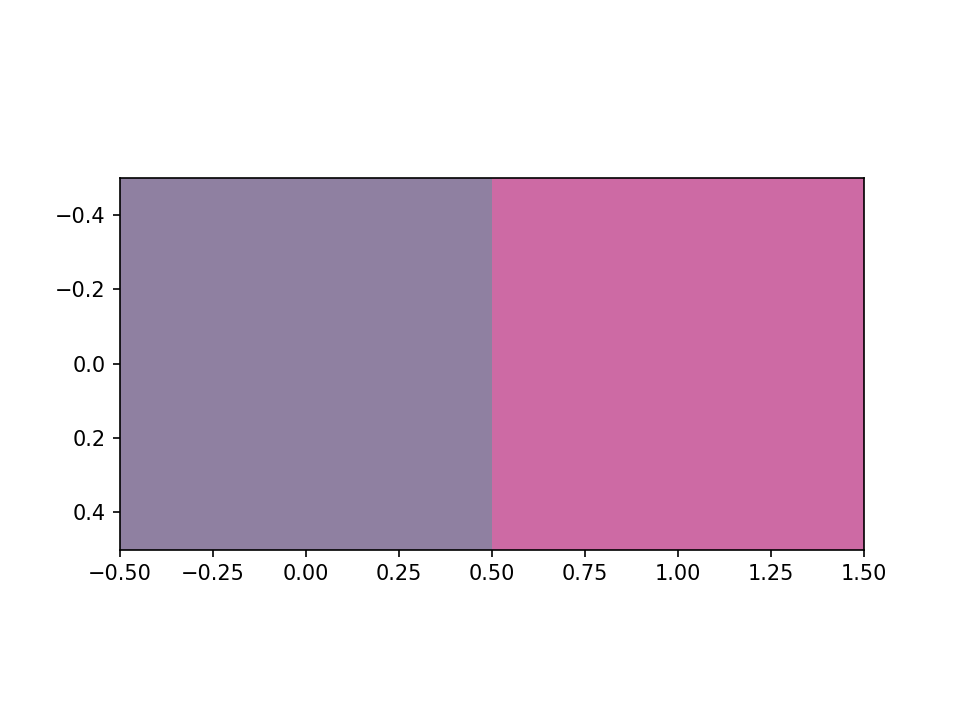

In [25]:
m_h=loadmat(mhfile[0])['m_h_result'][0]
m_e=loadmat(mefile[0])['m_e_result'][0]
M=np.concatenate((m_h.reshape(3,1),m_e.reshape(3,1)),axis=1)
M
display_M(M)

In [72]:
s_h=loadmat(sig_hfile[0])['sigma_h_result'][0]
s_e=loadmat(sig_efile[0])['sigma_e_result'][0]
print(s_h,s_e)
np.concatenate((s_h,s_e))



[0.02741364] [0.02607968]


array([0.02741364, 0.02607968], dtype=float32)

<IPython.core.display.Javascript object>


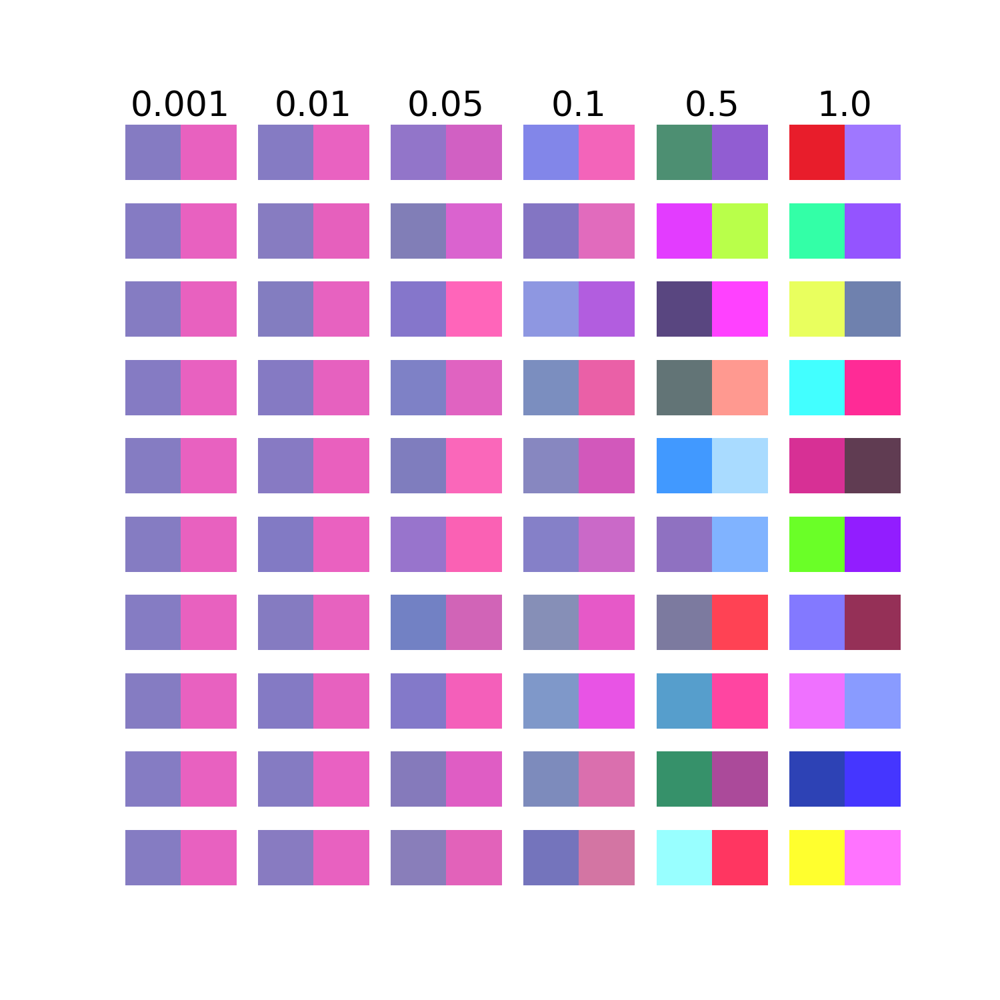

In [88]:
#This is the one we always use: (Ruifrok Landini)
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#This is the real one
M_Ruifrok_real=np.array([[0.65  , 0.07  , 0.27],
       [0.70  , 0.99  , 0.57       ],
       [0.29  , 0.57  , 0.78]])



#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:3]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
n_col=len(v1_list)
n_row=10
plt.figure(figsize=(10,10))
for v,v1 in enumerate(v1_list):
    var=v1*np.ones([1,3])
    for i in range(n_row):

#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),0,None)
#         Hgauss=Hgauss/np.linalg.norm(Hgauss)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),0,None)
#         Egauss=Egauss/np.linalg.norm(Egauss)
        
        #Muestreo puro de la normal
        Hgauss=np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1])
        Egauss=np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1])


        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        index=(n_col)*i+v+1
        plt.subplot(n_row,n_col,index)
#         plt.figure()
        display_M(Mgauss)
        plt.axis('off')
        if i==0:
            plt.title(v1,fontsize=25)
#         plt.title(Mgauss)

<IPython.core.display.Javascript object>


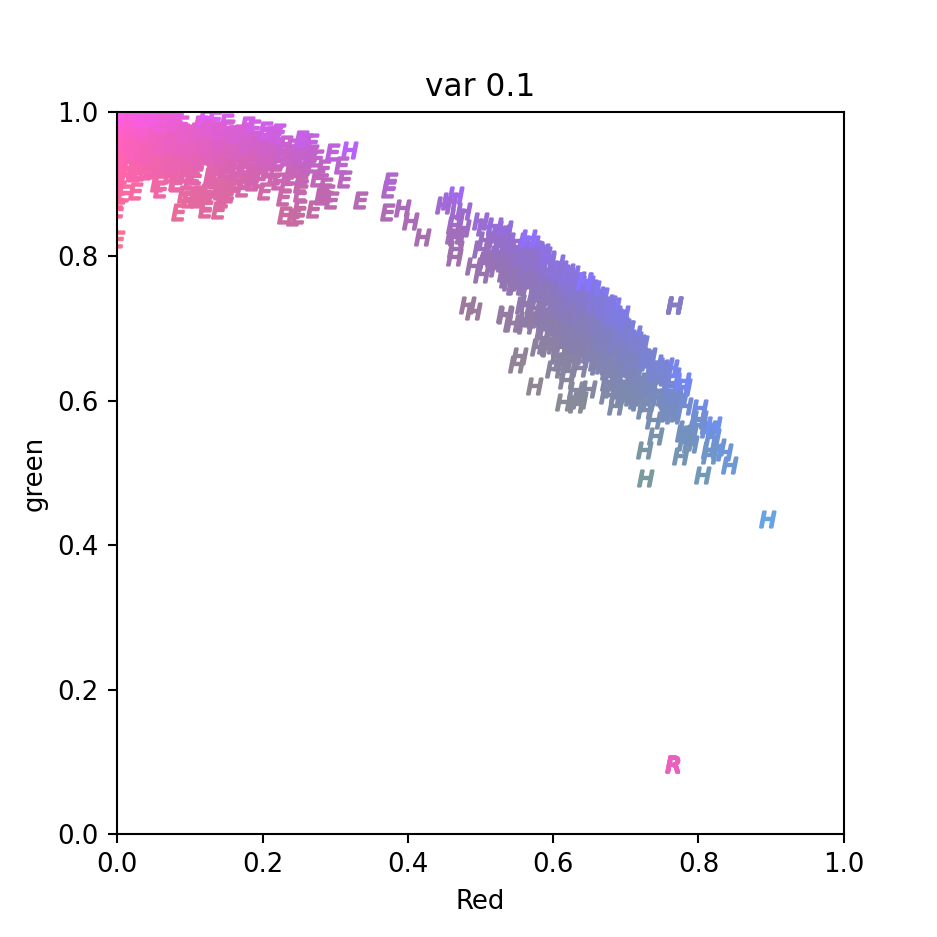

In [9]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
v1_list=[1e-1]
n_col=len(v1_list)
n_row=1
n_samples=500
# plt.figure(figsize=(10,10))
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot()
# ax = fig.add_subplot(projection='3d')
ax.set_xlabel('Red')
ax.set_ylabel('green')

ax.set_xlim(0,1)
ax.set_ylim(0,1)
# 3D
# ax.set_zlabel('Blue')
# ax.set_zlim(0,1)
for v,v1 in enumerate(v1_list):
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),0,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
        Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),0,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
        Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
        ax.scatter(Mgauss[0,0],Mgauss[1,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[1,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        ax.set_title('var '+str(v1))
#         3D
#         ax.scatter(Mgauss[0,0],Mgauss[1,0],Mgauss[2,0], color=od2rgb(Mgauss[:,0])/255)    
#         ax.scatter(Mgauss[0,1],Mgauss[1,1],Mgauss[2,1], color=od2rgb(Mgauss[:,1])/255)

<IPython.core.display.Javascript object>


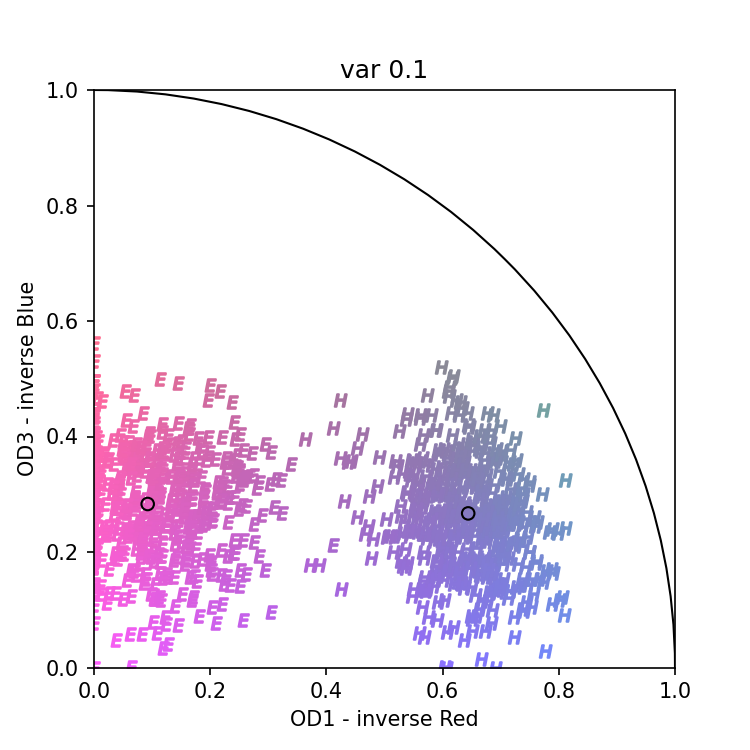

In [62]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
v1_list=[1e-1]
n_col=len(v1_list)
n_row=1
n_samples=500
# plt.figure(figsize=(10,10))
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot()
# ax = fig.add_subplot(projection='3d')
ax.set_xlabel('OD1 - inverse Red')
ax.set_ylabel('OD3 - inverse Blue')

ax.set_xlim(0,1)
ax.set_ylim(0,1)
# 3D
# ax.set_zlabel('Blue')
# ax.set_zlim(0,1)




for v,v1 in enumerate(v1_list):
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),0,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
        Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),0,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
        Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
        ax.scatter(Mgauss[0,0],Mgauss[2,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[2,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        ax.set_title('var '+str(v1))
#         3D
#         ax.scatter(Mgauss[0,0],Mgauss[1,0],Mgauss[2,0], color=od2rgb(Mgauss[:,0])/255)    
#         ax.scatter(Mgauss[0,1],Mgauss[1,1],Mgauss[2,1], color=od2rgb(Mgauss[:,1])/255)

# ax.scatter(M_Ruifrok[0,0],M_Ruifrok[2,0],marker='*',color=od2rgb(M_Ruifrok[:,0])/255)
# ax.scatter(M_Ruifrok[0,1],M_Ruifrok[2,1],marker='*',color=od2rgb(M_Ruifrok[:,1])/255) 
ax.scatter(M_Ruifrok[0,0],M_Ruifrok[2,0],facecolors='none', edgecolors='k')
ax.scatter(M_Ruifrok[0,1],M_Ruifrok[2,1],marker='o',facecolors='none', edgecolors='k') 
# facecolors='none', edgecolors='r'
r1=plt.Circle((0,0),1, fill=False)
ax.add_patch(r1)

<IPython.core.display.Javascript object>


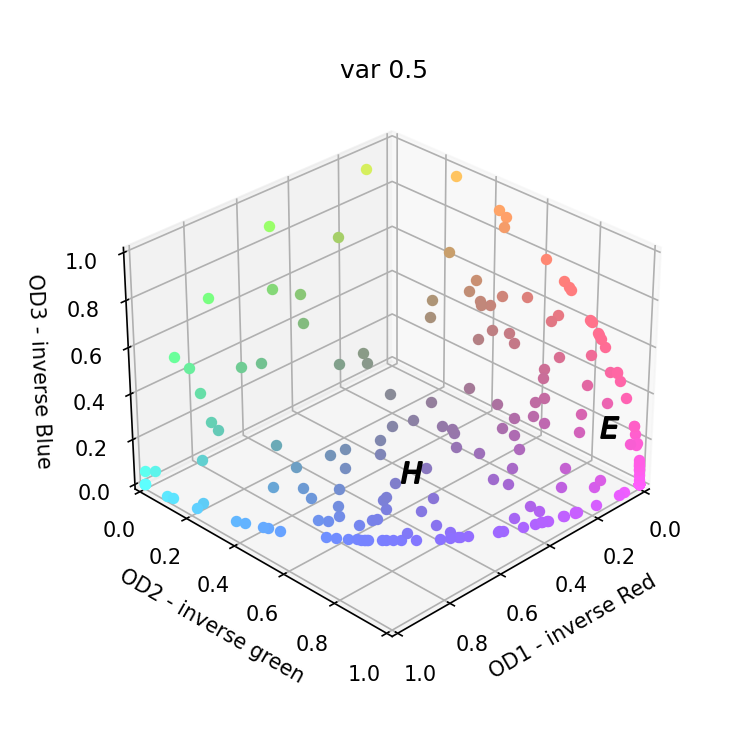

/tmp/ipykernel_245527/4140609986.py:40: RuntimeWarning: invalid value encountered in true_divide
  Egauss=Egauss/np.linalg.norm(Egauss)


In [84]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
v1_list=[5e-1]

n_col=len(v1_list)
n_row=1
n_samples=100
# plt.figure(figsize=(10,10))
fig = plt.figure(figsize=(5, 5))
# ax = fig.add_subplot()
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('OD1 - inverse Red')
ax.set_ylabel('OD2 - inverse green')

ax.set_xlim(0,1)
ax.set_ylim(0,1)
# 3D
ax.set_zlabel('OD3 - inverse Blue')
ax.set_zlim(0,1)
eps=1e-2
# plt.circle()

for v,v1 in enumerate(v1_list):
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),0,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
        Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),0,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
        Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
#         ax.scatter(Mgauss[0,0],Mgauss[1,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
#         ax.scatter(Mgauss[0,1],Mgauss[1,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        
#         3D
        ax.scatter(Mgauss[0,0],Mgauss[1,0],Mgauss[2,0], color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[1,1],Mgauss[2,1], color=od2rgb(Mgauss[:,1])/255)
        
    ax.view_init(elev=30., azim=45)
    ax.scatter(M_Ruifrok[0,0]+eps,M_Ruifrok[1,0]+eps,M_Ruifrok[2,0]+eps, marker='$H$', s=100, color='k')   # , facecolors='none', edgecolors='k'
    ax.scatter(M_Ruifrok[0,1]+eps,M_Ruifrok[1,1]+eps,M_Ruifrok[2,1]+eps, marker='$E$', s=100, color='k')   # , facecolors='none', edgecolors='k'
        
    ax.set_title('var '+str(v1))


# Sin restricciones

<IPython.core.display.Javascript object>


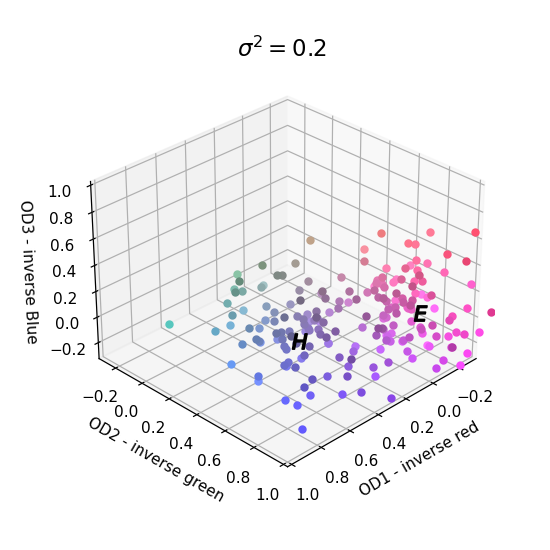

In [78]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
v1_list=[2e-1]

n_col=len(v1_list)
n_row=1
n_samples=100
# plt.figure(figsize=(10,10))
fig = plt.figure(figsize=(5, 5))
# ax = fig.add_subplot()
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('OD1 - inverse red')
ax.set_ylabel('OD2 - inverse green')

ax.set_xlim(-0.3,1)
ax.set_ylim(-0.3,1)
# 3D
ax.set_zlabel('OD3 - inverse Blue')
ax.set_zlim(-0.3,1)

# plt.circle()

for v,v1 in enumerate(v1_list):
    eps=2*v1
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
#         Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
#         Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
#         ax.scatter(Mgauss[0,0],Mgauss[1,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
#         ax.scatter(Mgauss[0,1],Mgauss[1,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        
#         3D
        ax.scatter(Mgauss[0,0],Mgauss[1,0],Mgauss[2,0], color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[1,1],Mgauss[2,1], color=od2rgb(Mgauss[:,1])/255)
        
    ax.view_init(elev=30., azim=45)
    ax.scatter(M_Ruifrok[0,0]+eps,M_Ruifrok[1,0]+eps,M_Ruifrok[2,0]+eps, marker='$H$', s=100, color='k')   # , facecolors='none', edgecolors='k'
    ax.scatter(M_Ruifrok[0,1]+eps,M_Ruifrok[1,1]+eps,M_Ruifrok[2,1]+eps, marker='$E$', s=100, color='k')   # , facecolors='none', edgecolors='k'
        
    ax.set_title(r'$\sigma^2=$'+str(v1),fontsize=15)
    fig.savefig('Prior_M_sig_' +str(v1)+ '.pdf', bbox_inches='tight')


<IPython.core.display.Javascript object>


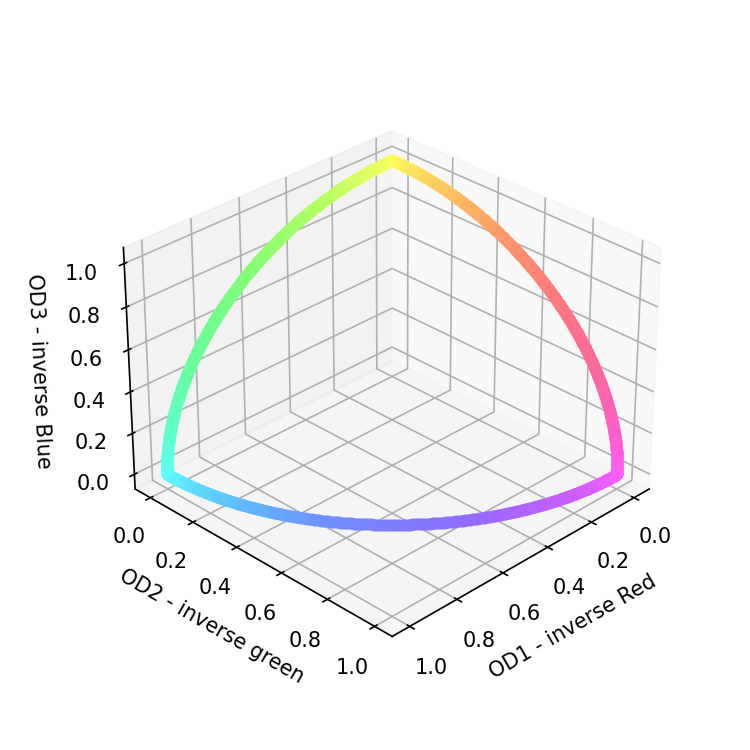

In [80]:
step=np.linspace(0,1,1000)
fig = plt.figure(figsize=(5, 5))
# ax = fig.add_subplot()
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('OD1 - inverse Red')
ax.set_ylabel('OD2 - inverse green')

# ax.set_xlim(0,1)
# ax.set_ylim(0,1)
# 3D
ax.set_zlabel('OD3 - inverse Blue')
# ax.set_zlim(0,1)
eps=1e-2

for s in step[0:]:
    to_plot=np.array([0,s,1-s])
    to_plot=to_plot/np.linalg.norm(to_plot)

    ax.scatter(to_plot[0],to_plot[1],to_plot[2], color=od2rgb(to_plot)/255) 
    to_plot=np.roll(to_plot,1)

    ax.scatter(to_plot[0],to_plot[1],to_plot[2], color=od2rgb(to_plot)/255) 
    to_plot=np.roll(to_plot,1)

    ax.scatter(to_plot[0],to_plot[1],to_plot[2], color=od2rgb(to_plot)/255) 
#     ax.scatter(0,s,1-s, color=od2rgb(np.array([0,s,1-s]))/255)  
#     ax.scatter(0,s,1-s, color=od2rgb(np.array([0,s,1-s]))/255)   

ax.view_init(elev=30., azim=45)



In [75]:
to_plot

array([0., 1., 0.])

In [69]:
s=0.3
to_plot=np.array([0,s,1-s])
print(to_plot)
print(np.roll(to_plot,1))
print(np.roll(to_plot,2))

[0.  0.3 0.7]
[0.7 0.  0.3]
[0.3 0.7 0. ]


<IPython.core.display.Javascript object>


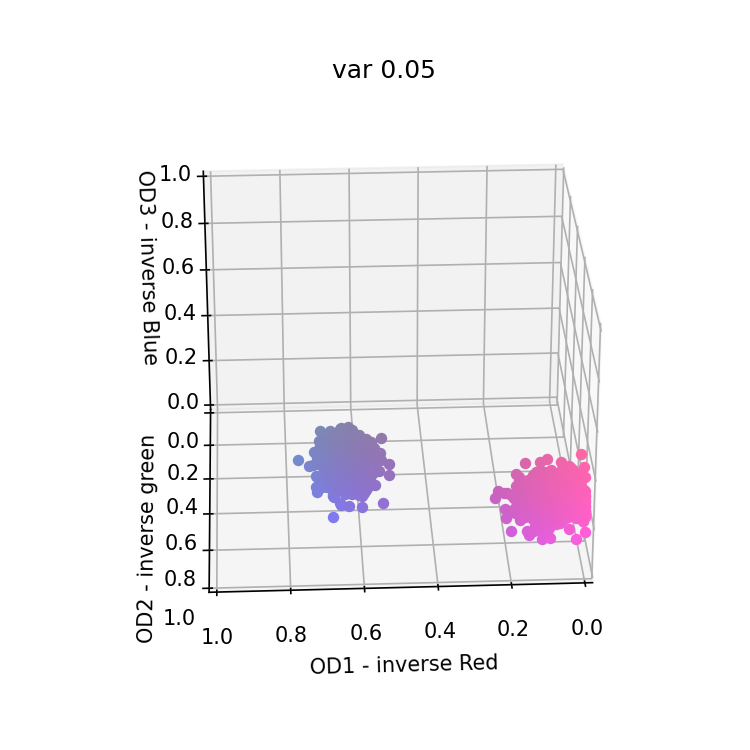

In [6]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
v1_list=[5e-2]
n_col=len(v1_list)
n_row=1
n_samples=500
# plt.figure(figsize=(10,10))
fig = plt.figure(figsize=(5, 5))
# ax = fig.add_subplot()
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('OD1 - inverse Red')
ax.set_ylabel('OD2 - inverse green')

ax.set_xlim(0,1)
ax.set_ylim(0,1)
# 3D
ax.set_zlabel('OD3 - inverse Blue')
ax.set_zlim(0,1)

# plt.circle()

for v,v1 in enumerate(v1_list):
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),0,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
        Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),0,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
        Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
#         ax.scatter(Mgauss[0,0],Mgauss[1,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
#         ax.scatter(Mgauss[0,1],Mgauss[1,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        ax.set_title('var '+str(v1))
#         3D
        ax.scatter(Mgauss[0,0],Mgauss[1,0],Mgauss[2,0], color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[1,1],Mgauss[2,1], color=od2rgb(Mgauss[:,1])/255)

<IPython.core.display.Javascript object>


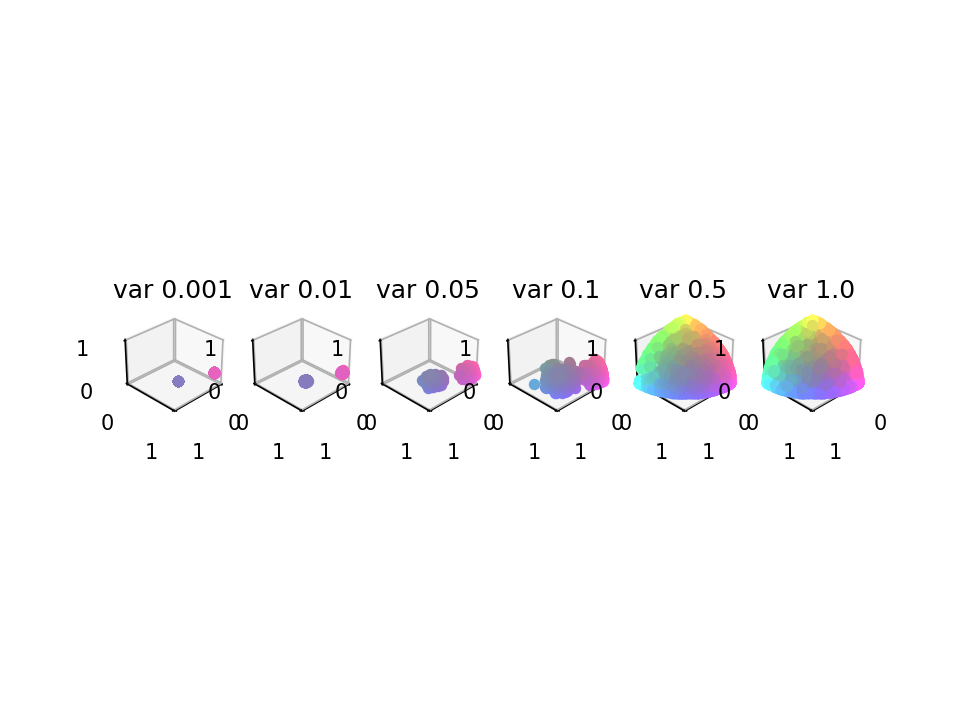

/tmp/ipykernel_245527/1862136609.py:38: RuntimeWarning: invalid value encountered in true_divide
  Hgauss=Hgauss/np.linalg.norm(Hgauss)
/tmp/ipykernel_245527/1862136609.py:41: RuntimeWarning: invalid value encountered in true_divide
  Egauss=Egauss/np.linalg.norm(Egauss)


In [86]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
# v1_list=[5e-2]
n_col=len(v1_list)
n_row=1
n_samples=500
# plt.figure(figsize=(10,10))
# fig = plt.figure(figsize=(5, 5))
# # ax = fig.add_subplot()
# ax = fig.add_subplot(projection='3d')
# ax.set_xlabel('OD1 - inverse Red')
# ax.set_ylabel('OD2 - inverse green')

# ax.set_xlim(0,1)
# ax.set_ylim(0,1)
# # 3D
# ax.set_zlabel('OD3 - inverse Blue')
# ax.set_zlim(0,1)

fig, axs = plt.subplots(1, n_col, subplot_kw=dict(projection="3d"))

# plt.circle()

for v,v1 in enumerate(v1_list):
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),0,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
        Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),0,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
        Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
#         ax.scatter(Mgauss[0,0],Mgauss[1,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
#         ax.scatter(Mgauss[0,1],Mgauss[1,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        axs[v].set_title('var '+str(v1))
#         3D
        axs[v].scatter(Mgauss[0,0],Mgauss[1,0],Mgauss[2,0], color=od2rgb(Mgauss[:,0])/255)    
        axs[v].scatter(Mgauss[0,1],Mgauss[1,1],Mgauss[2,1], color=od2rgb(Mgauss[:,1])/255)
    
    axs[v].set_xlim(0,1)
    axs[v].set_ylim(0,1)
    axs[v].set_zlim(0,1)
    axs[v].view_init(elev=30., azim=45)

In [10]:
axs[0]

<Axes3DSubplot:>

<IPython.core.display.Javascript object>


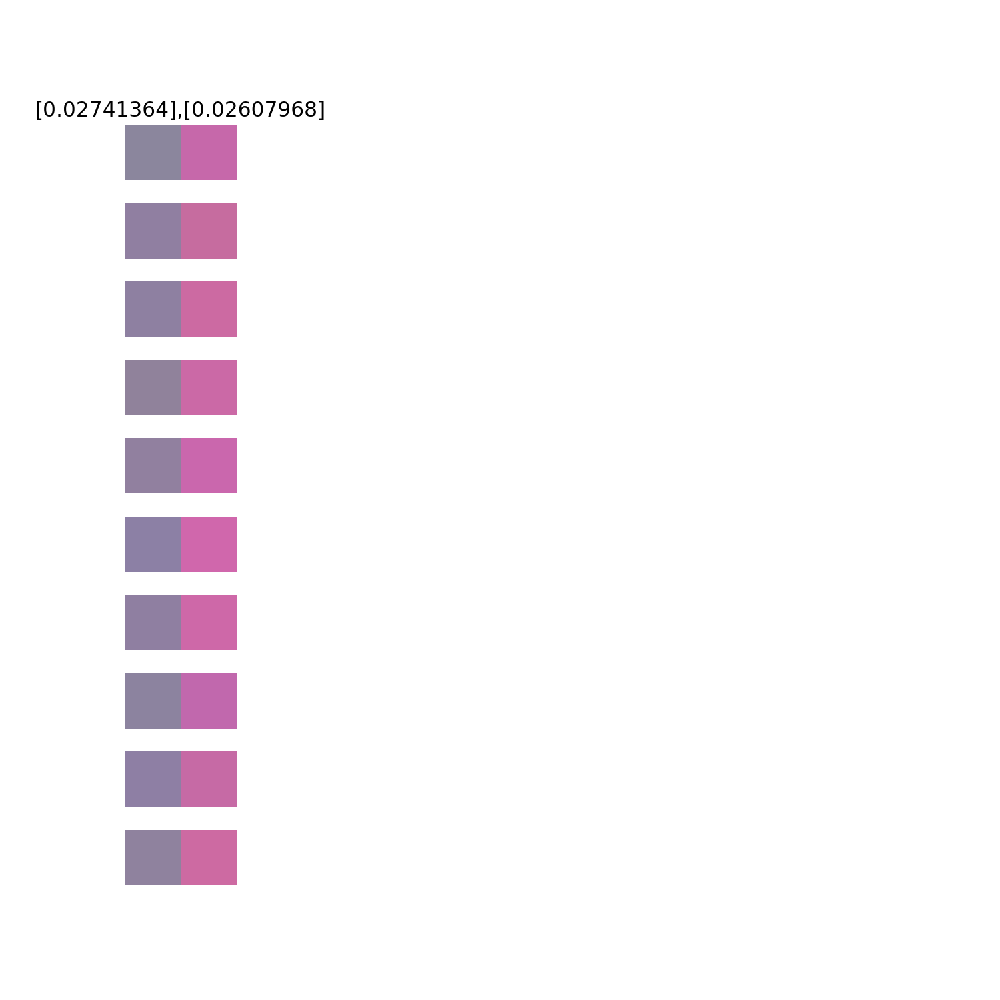

In [40]:
plt.figure(figsize=(10,10))
var_h=s_h*np.ones([1,3])
var_e=s_e*np.ones([1,3])
n_row=10
v=0
for i in range(n_row):

    Hgauss=np.clip(np.random.normal(loc=M[:,0], scale=var_h).reshape([3,1]),0,None)
    Hgauss=Hgauss/np.linalg.norm(Hgauss)
    Egauss=np.clip(np.random.normal(loc=M[:,1], scale=var_e).reshape([3,1]),0,None)
    Egauss=Egauss/np.linalg.norm(Egauss)

    Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
    index=(n_col)*i+v+1
    plt.subplot(n_row,n_col,index)
#         plt.figure()
    display_M(Mgauss)
    plt.axis('off')
    if i==0:
        plt.title(str(s_h)+','+str(s_e),fontsize=15)
#         plt.title(Mgauss)

<IPython.core.display.Javascript object>


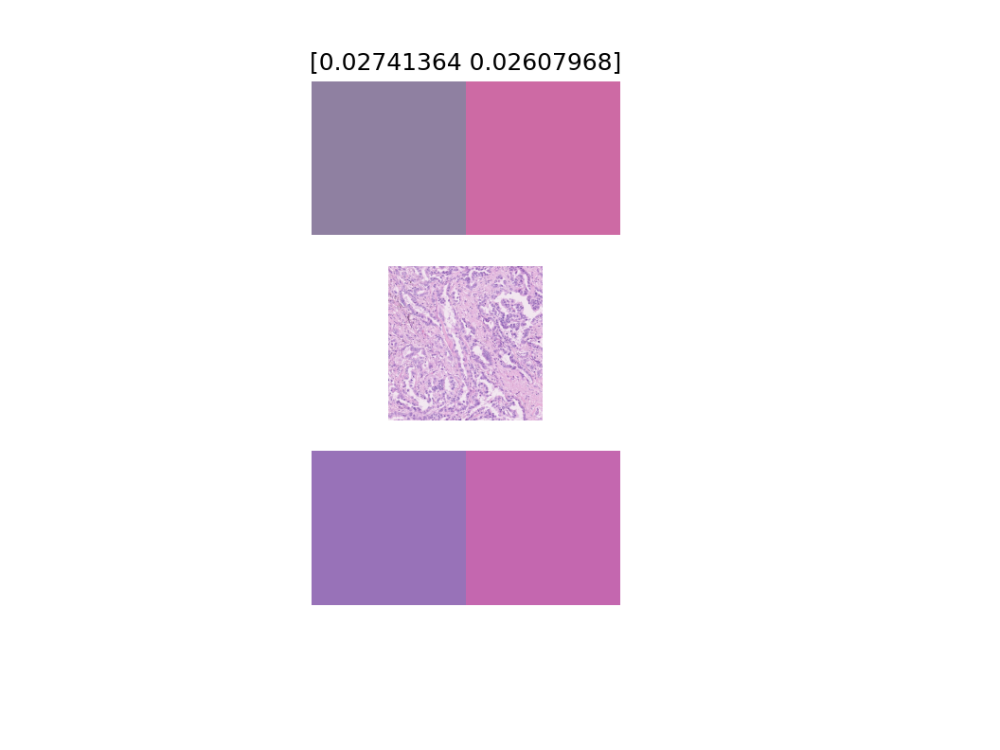

<IPython.core.display.Javascript object>


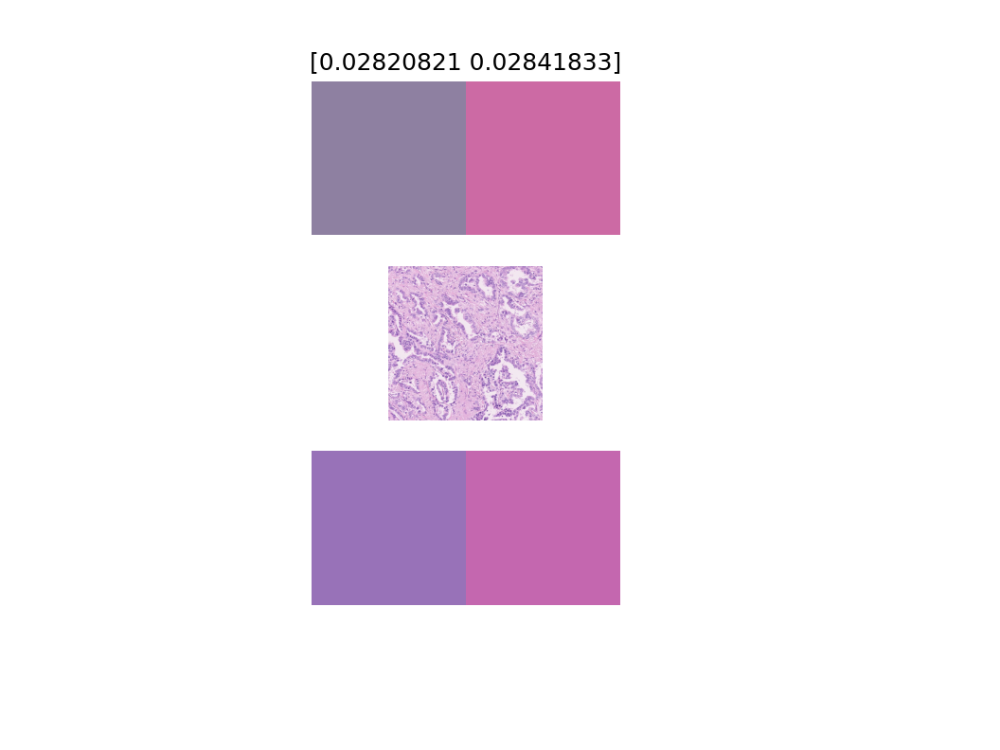

<IPython.core.display.Javascript object>


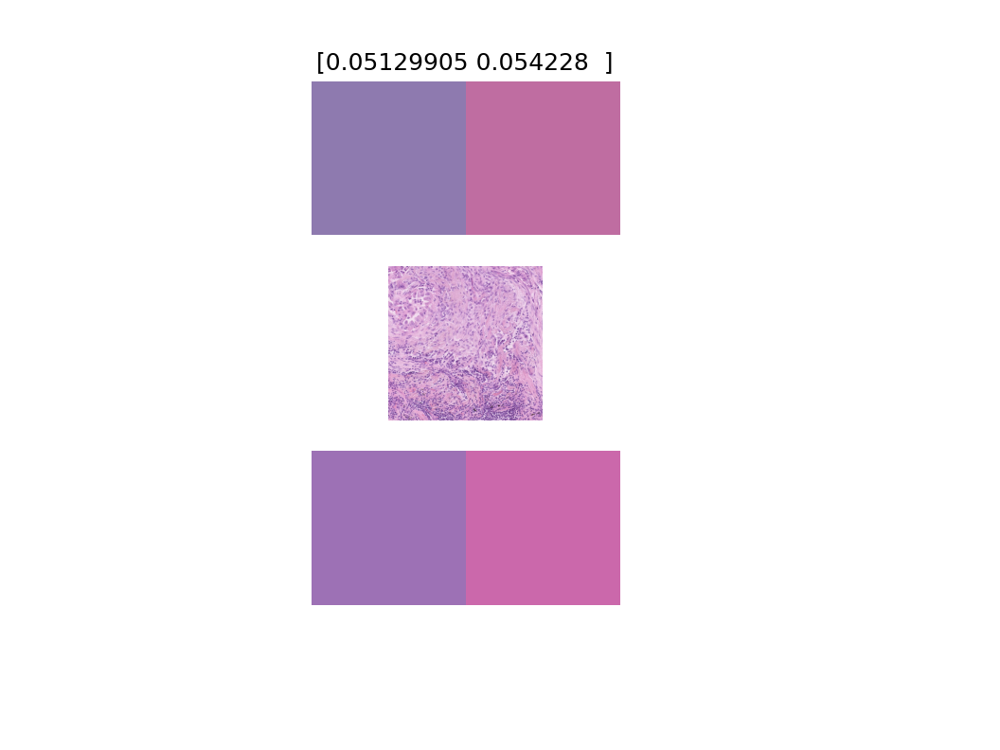

<IPython.core.display.Javascript object>


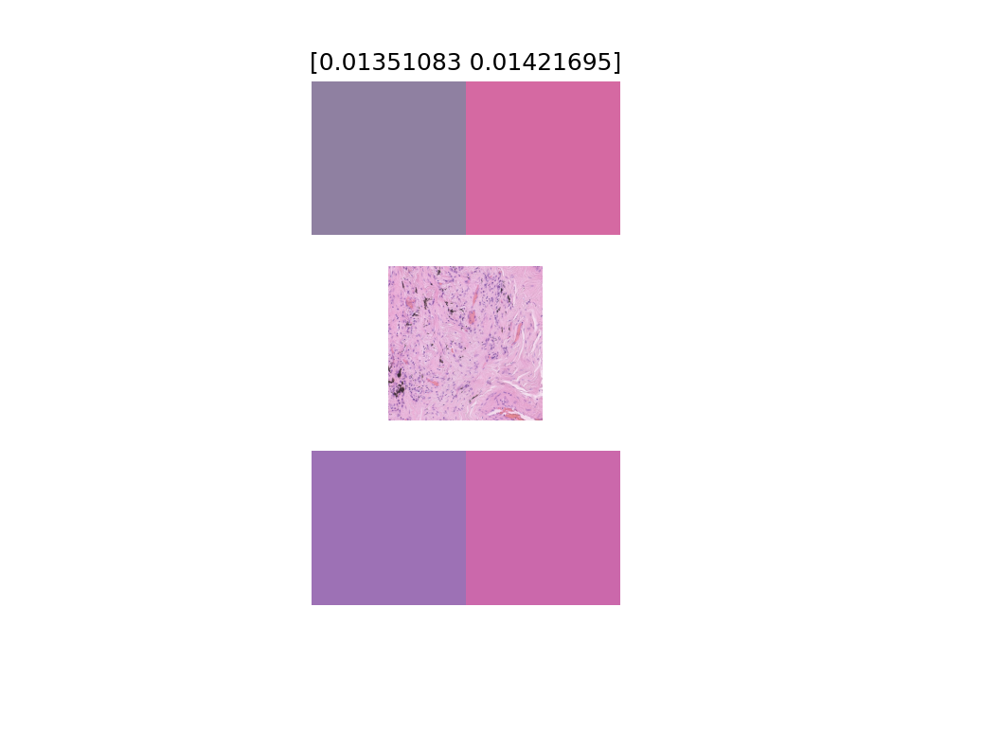

<IPython.core.display.Javascript object>


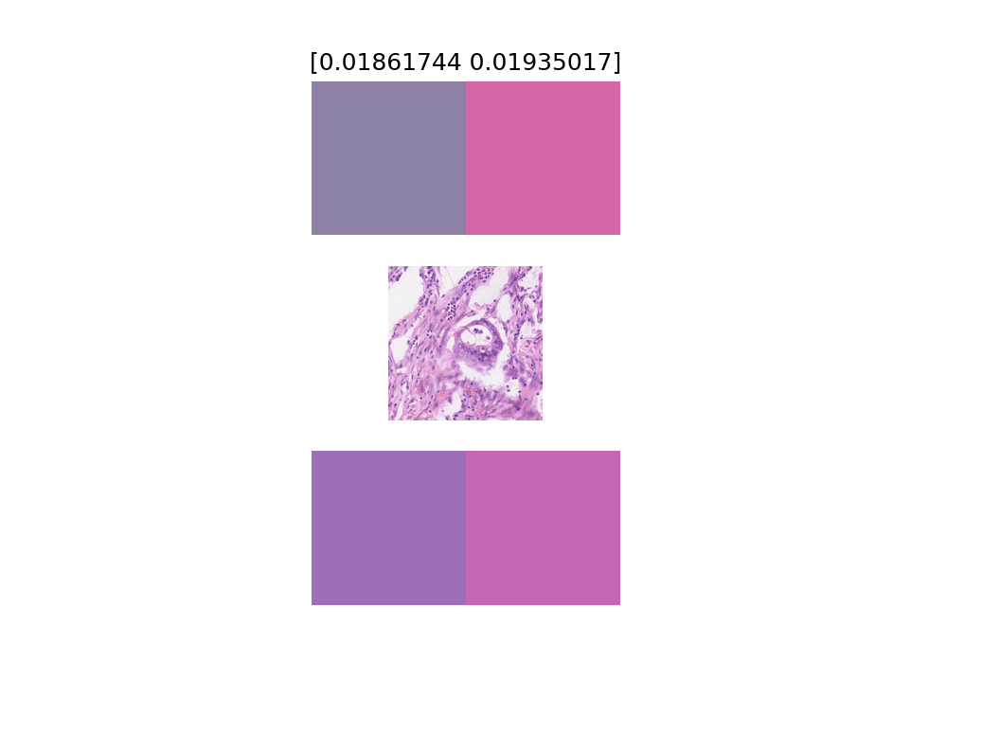

<IPython.core.display.Javascript object>


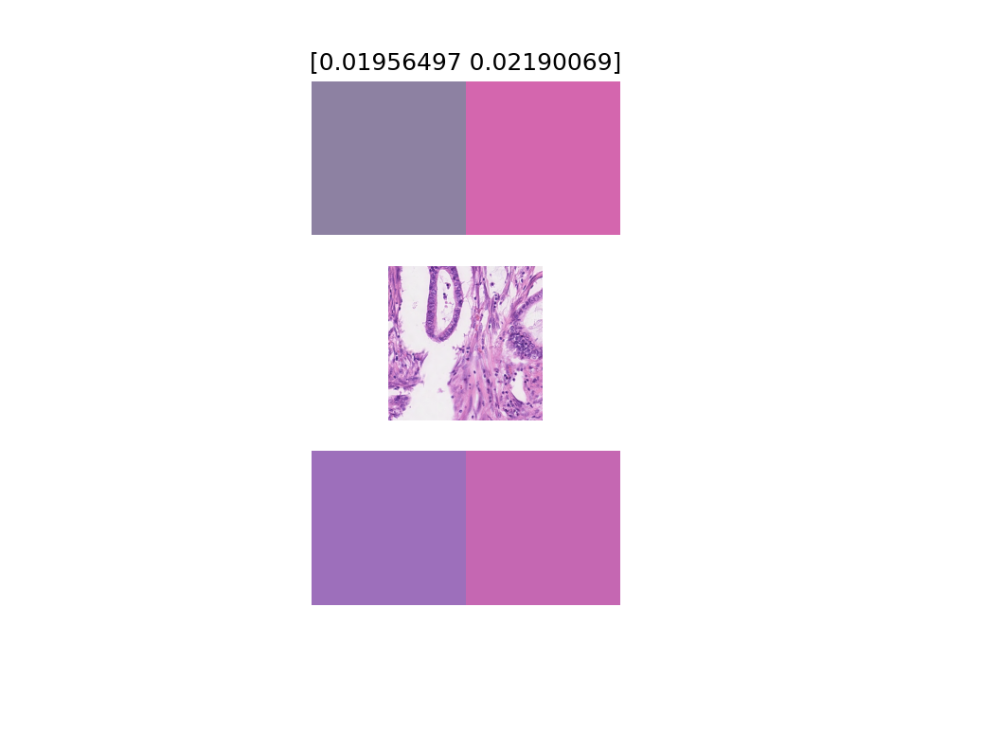

<IPython.core.display.Javascript object>


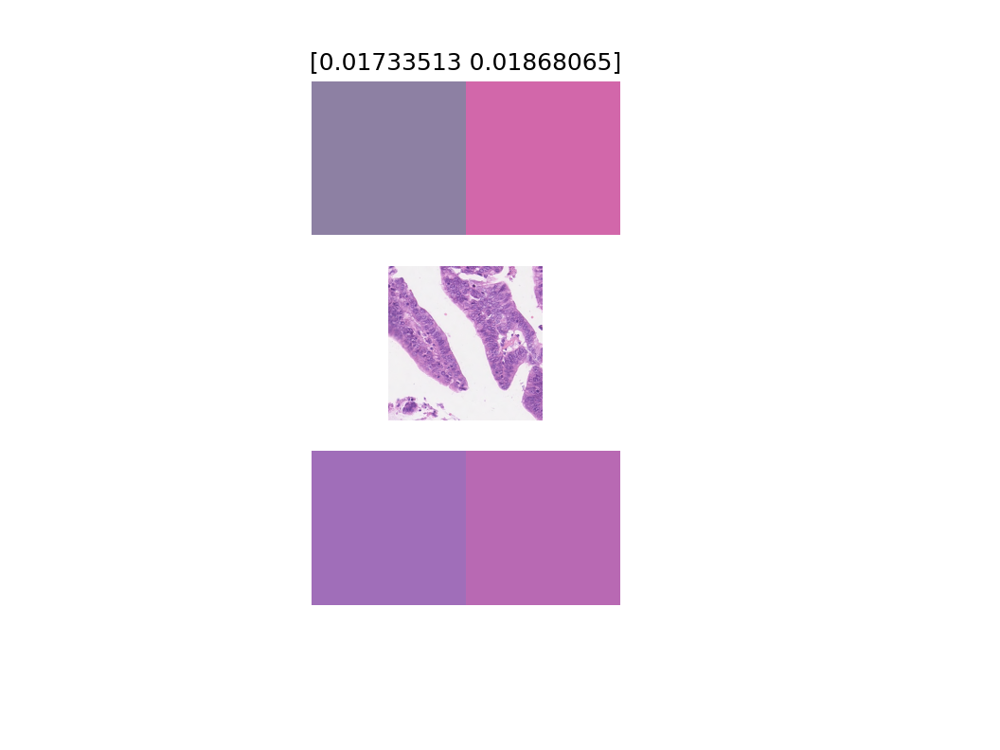

<IPython.core.display.Javascript object>


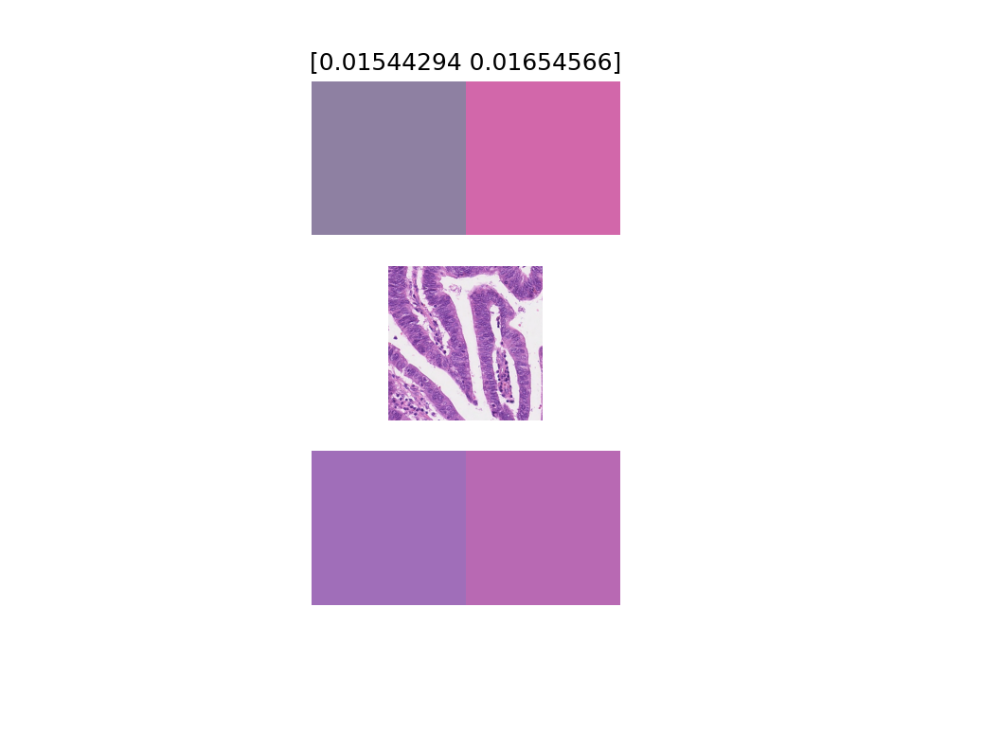

<IPython.core.display.Javascript object>


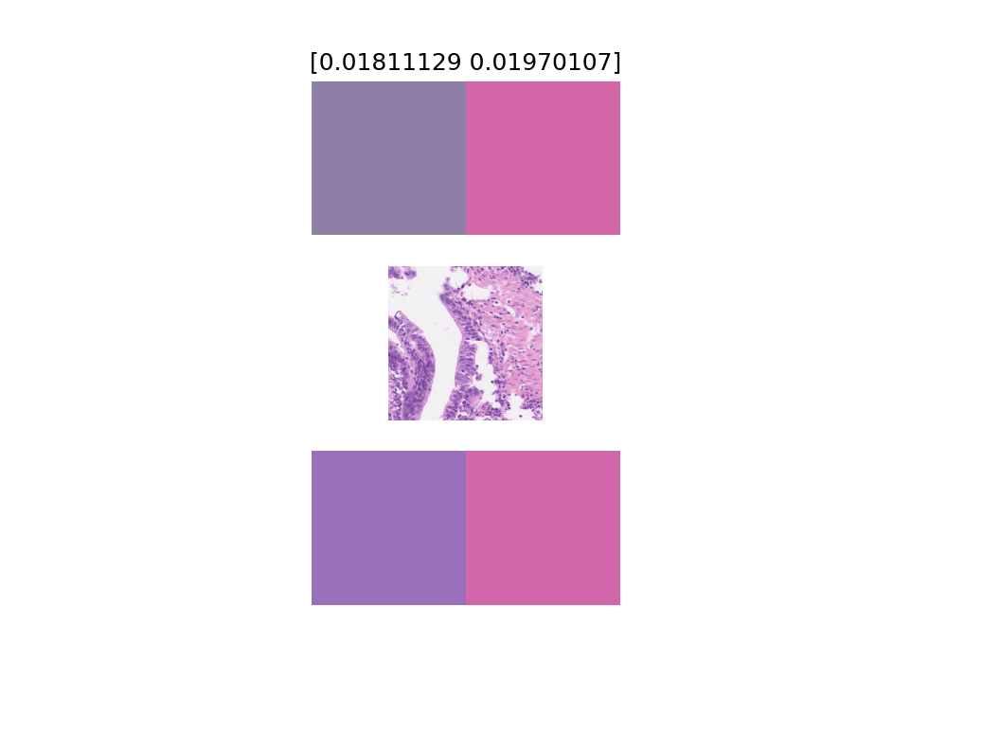

<IPython.core.display.Javascript object>


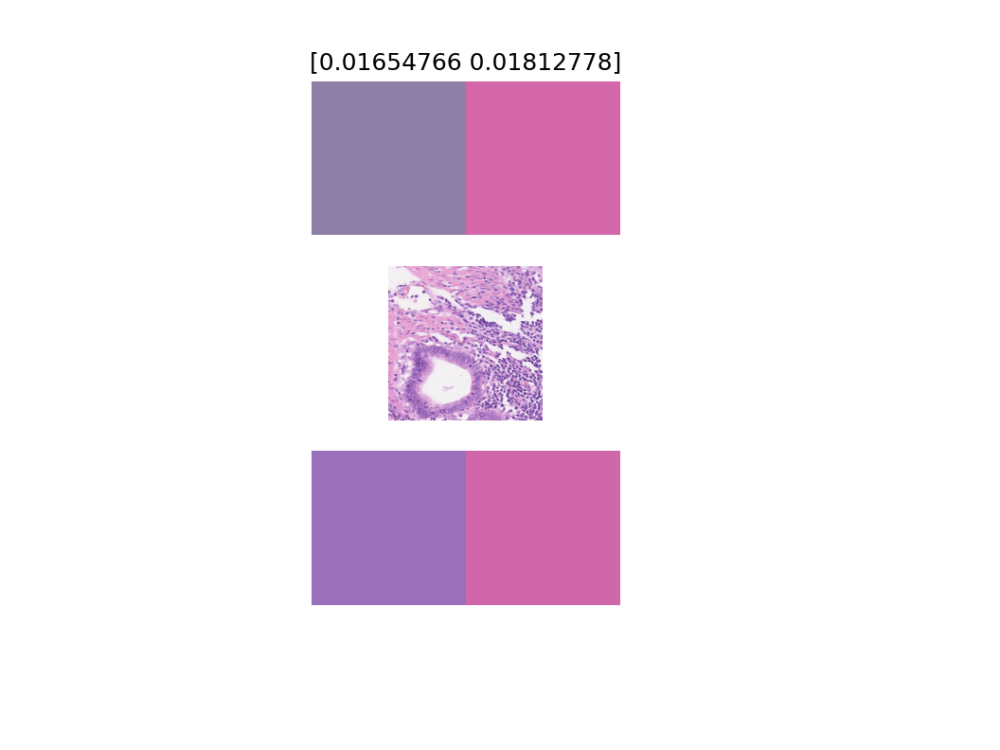

<IPython.core.display.Javascript object>


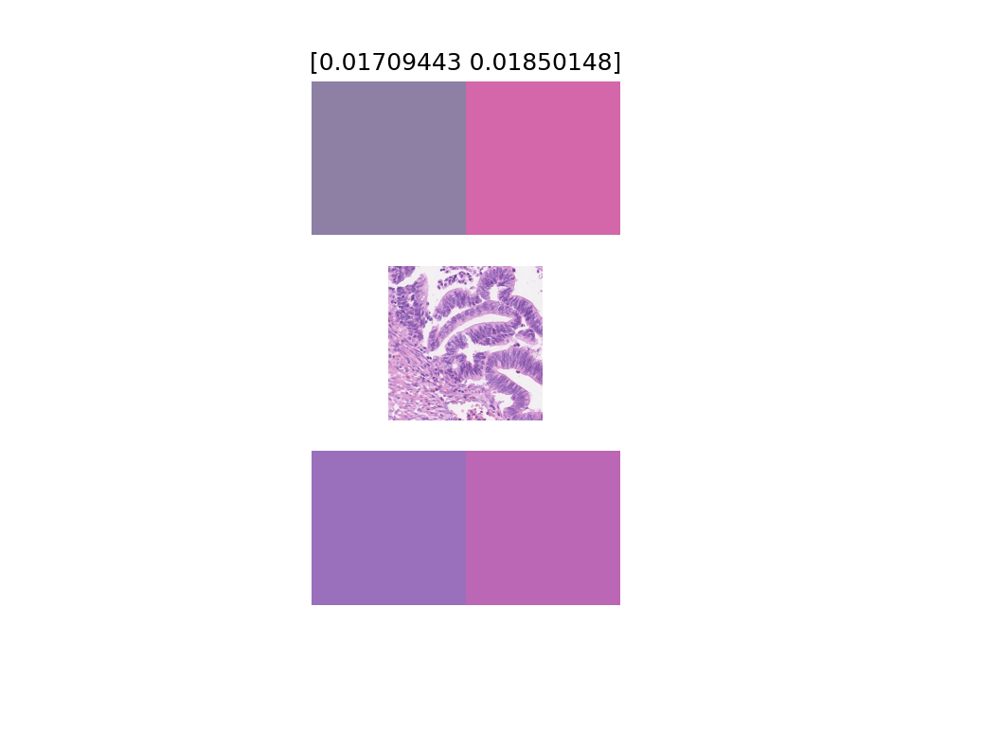

<IPython.core.display.Javascript object>


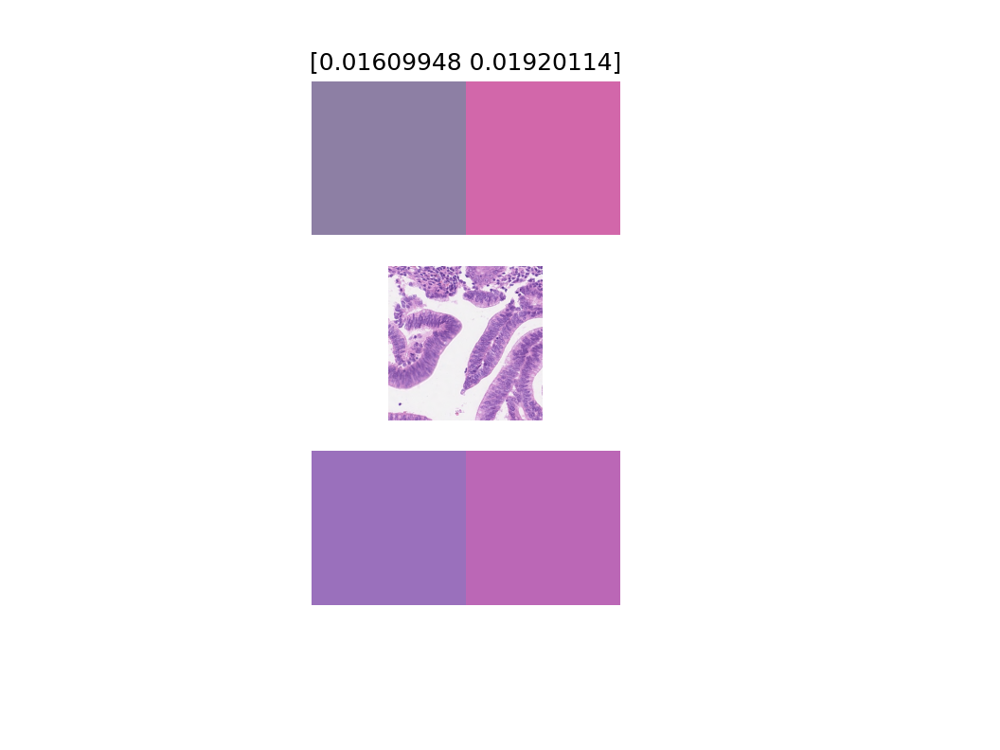

<IPython.core.display.Javascript object>


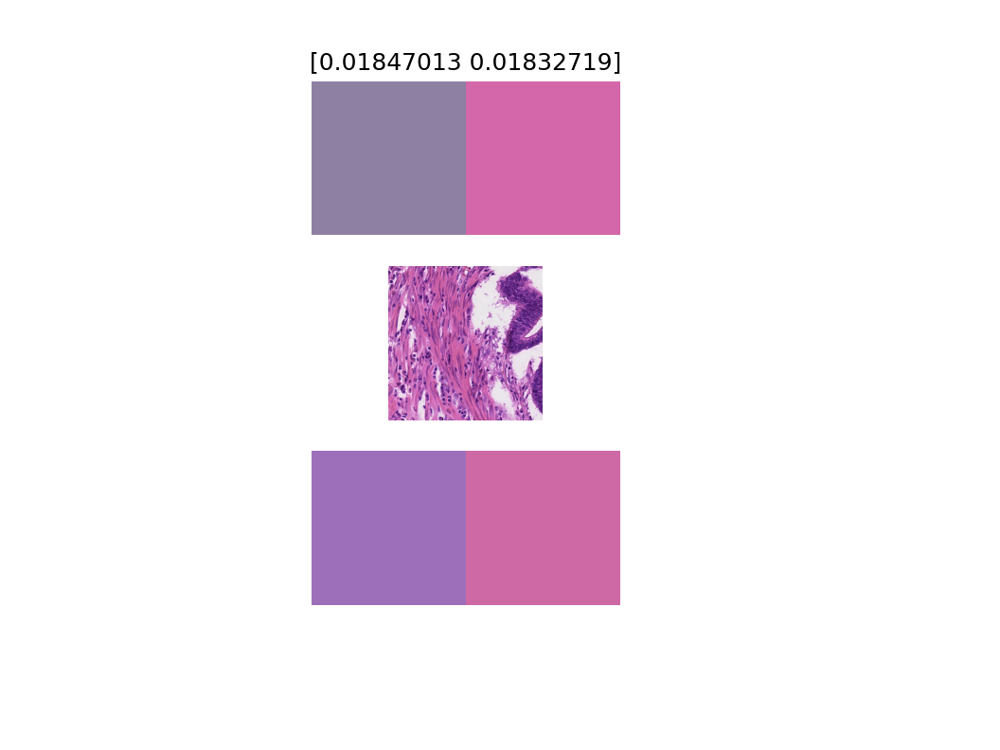

<IPython.core.display.Javascript object>


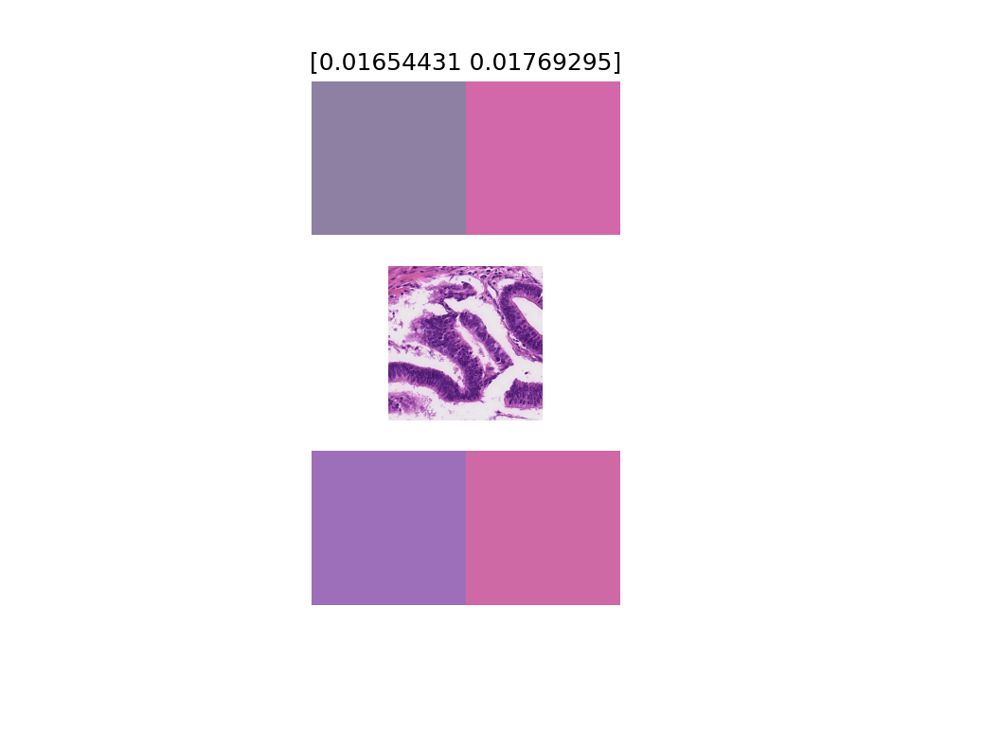

<IPython.core.display.Javascript object>


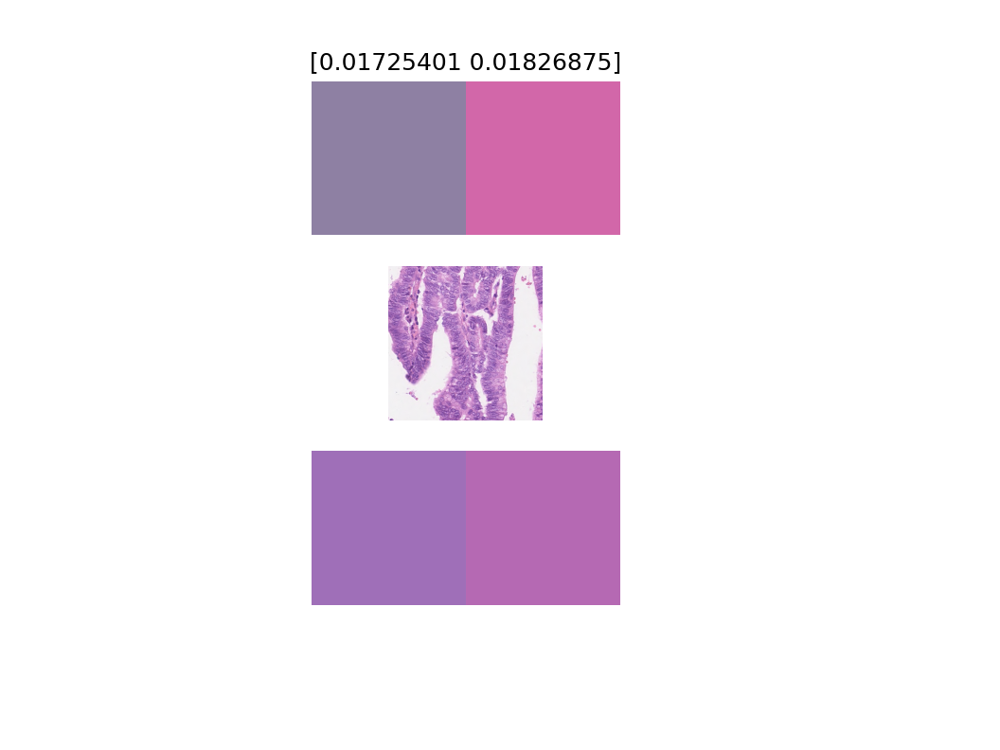

<IPython.core.display.Javascript object>


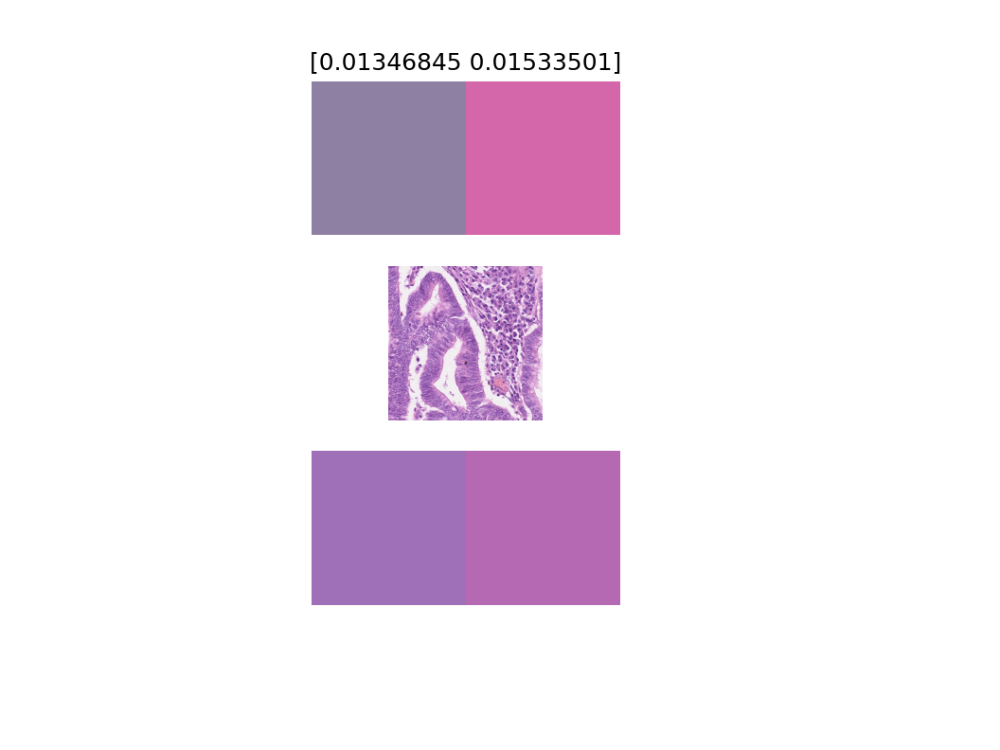

<IPython.core.display.Javascript object>


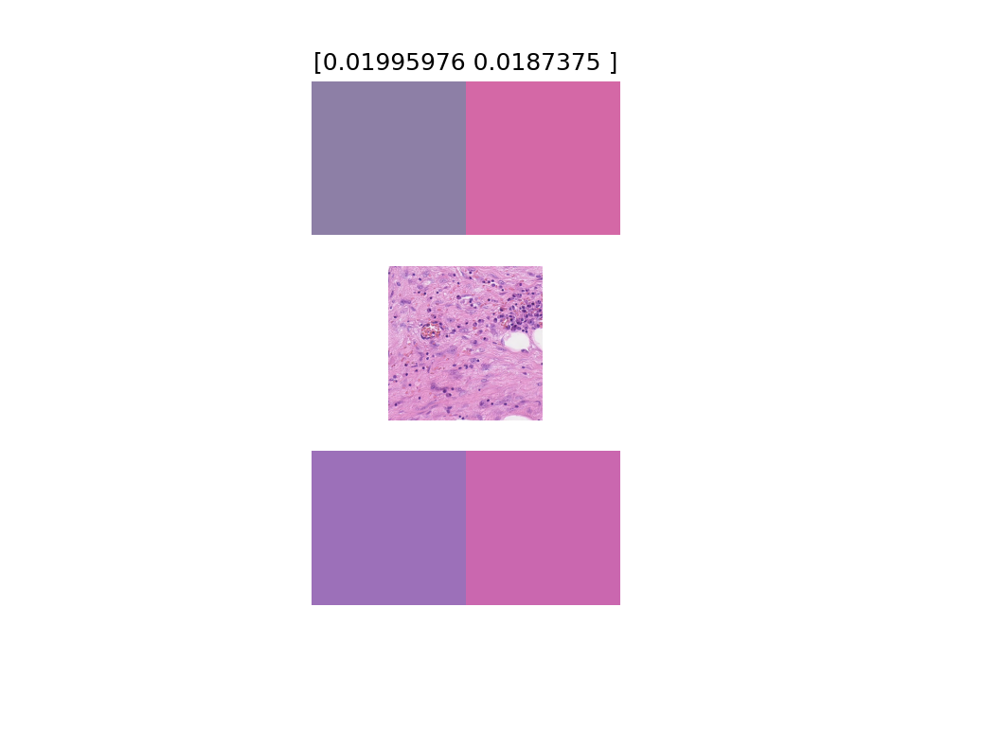

<IPython.core.display.Javascript object>


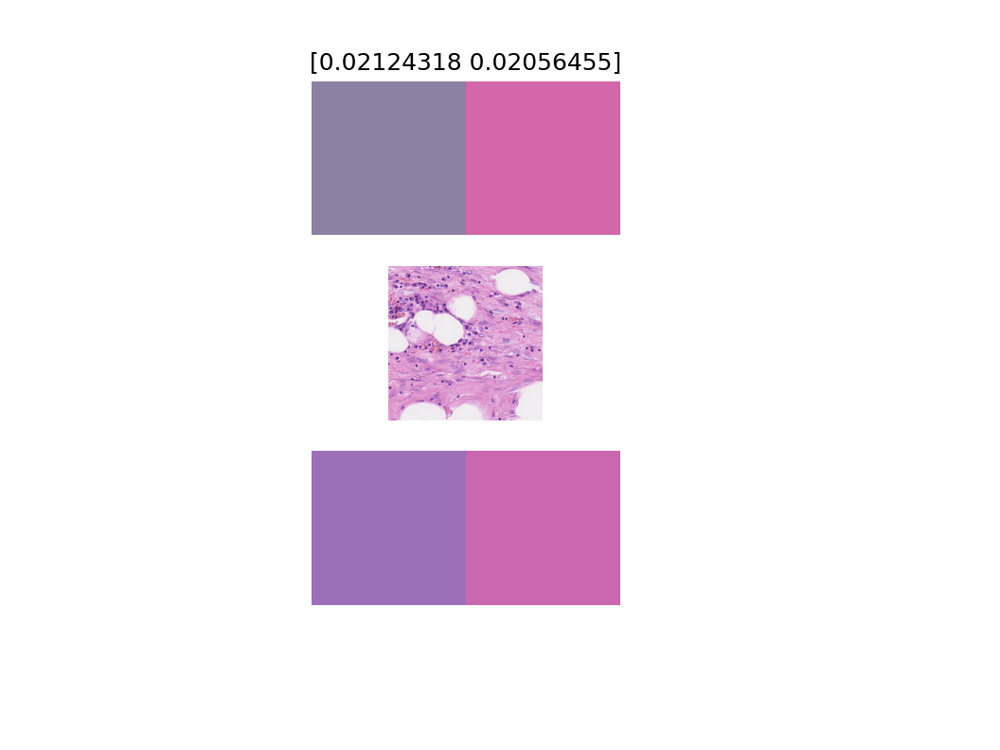

<IPython.core.display.Javascript object>


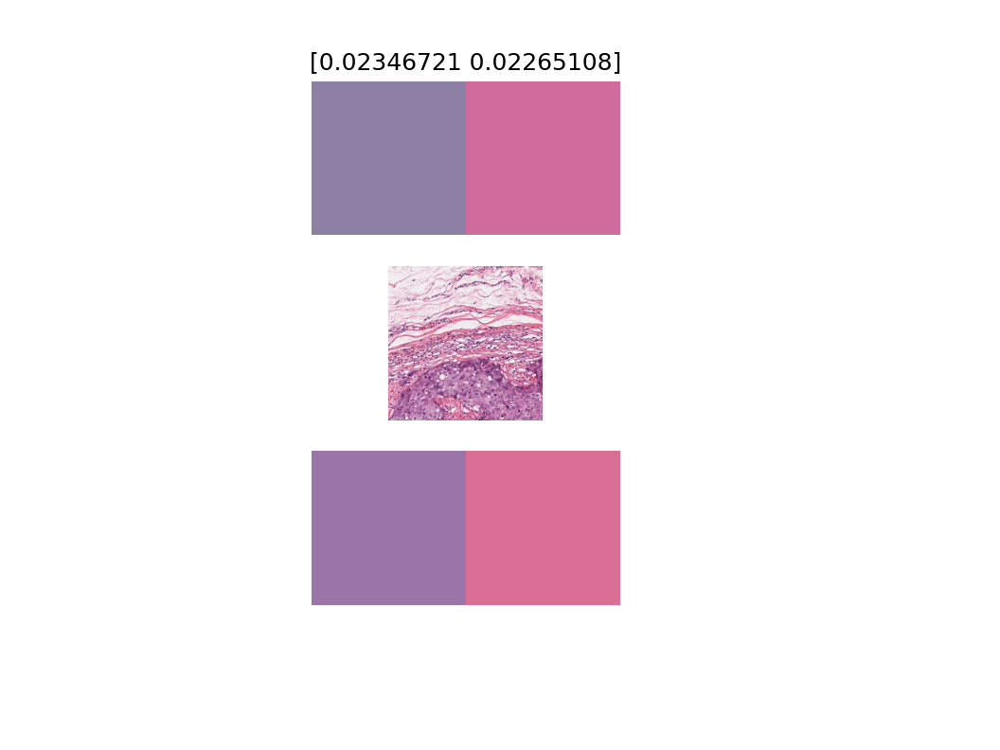

<IPython.core.display.Javascript object>


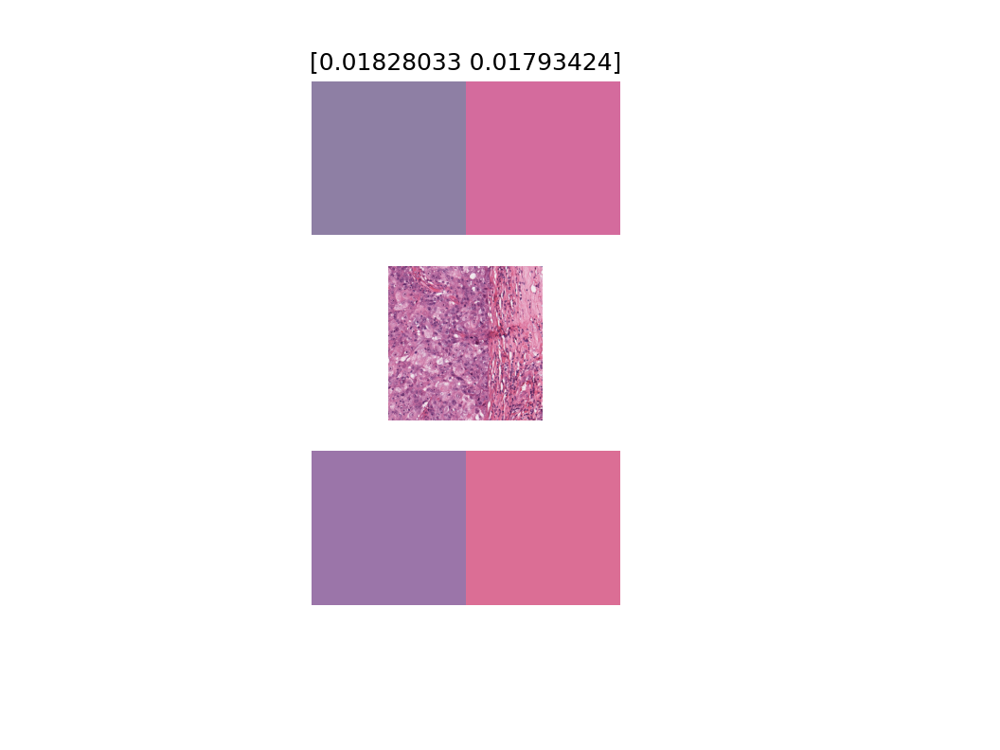

/tmp/ipykernel_4160135/1801445027.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig,ax= plt.subplots(2,2)


<IPython.core.display.Javascript object>


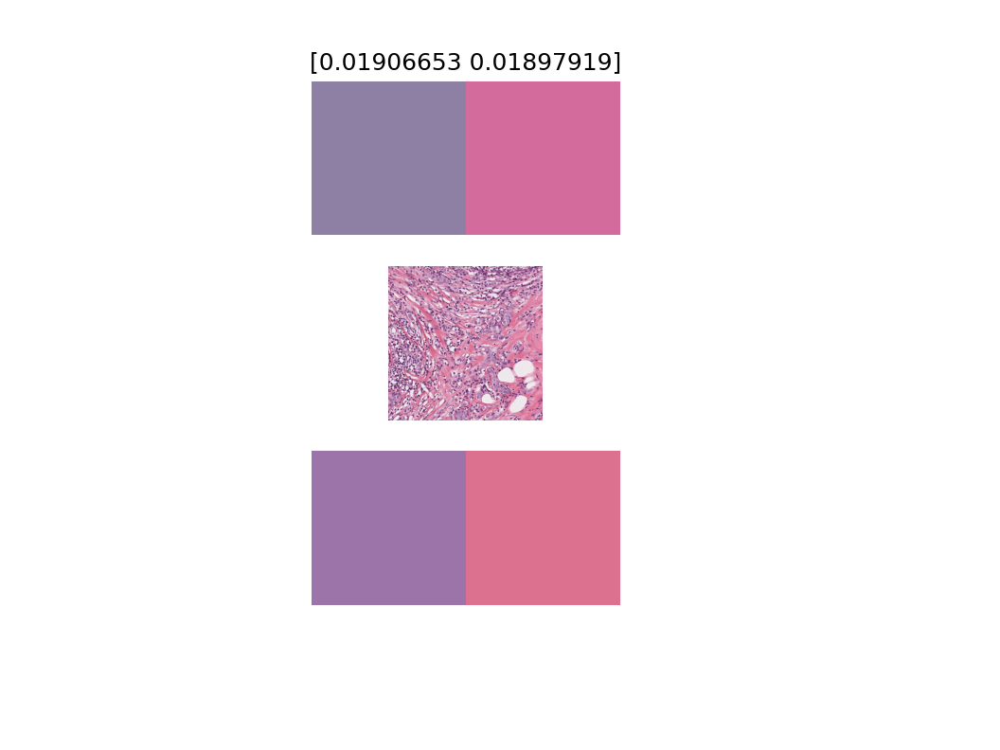

<IPython.core.display.Javascript object>


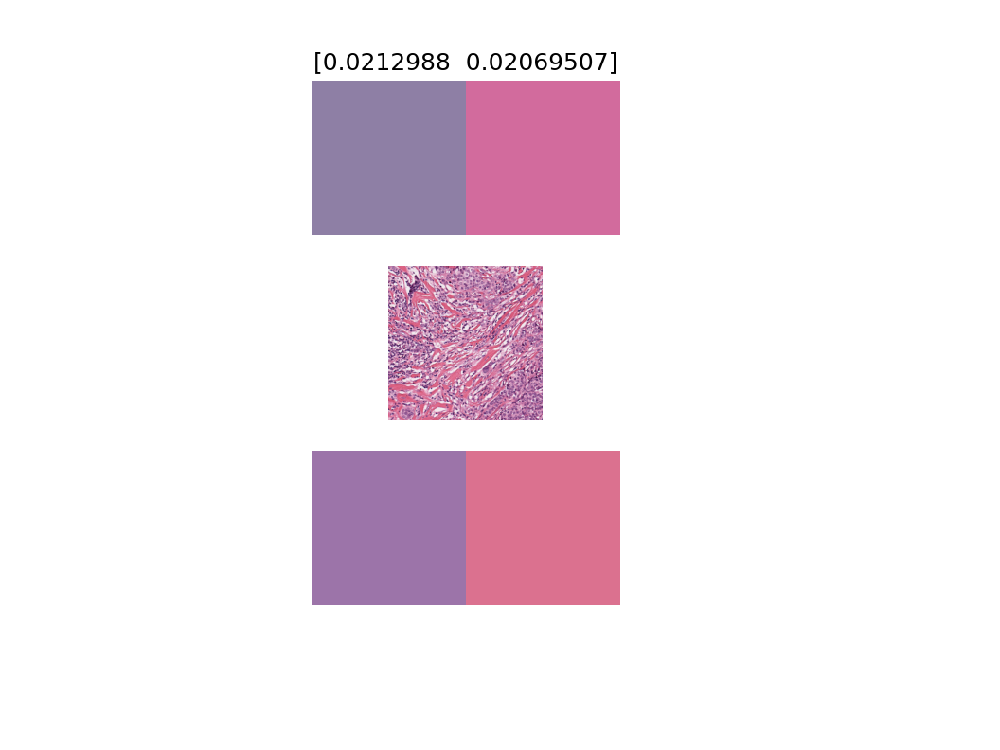

<IPython.core.display.Javascript object>


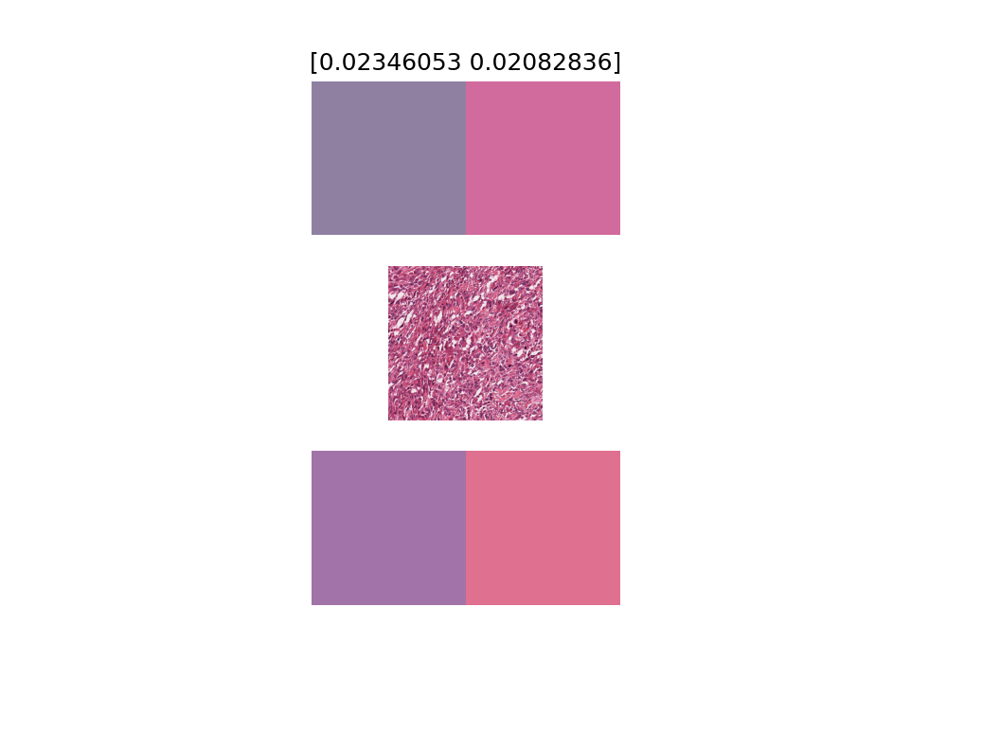

<IPython.core.display.Javascript object>


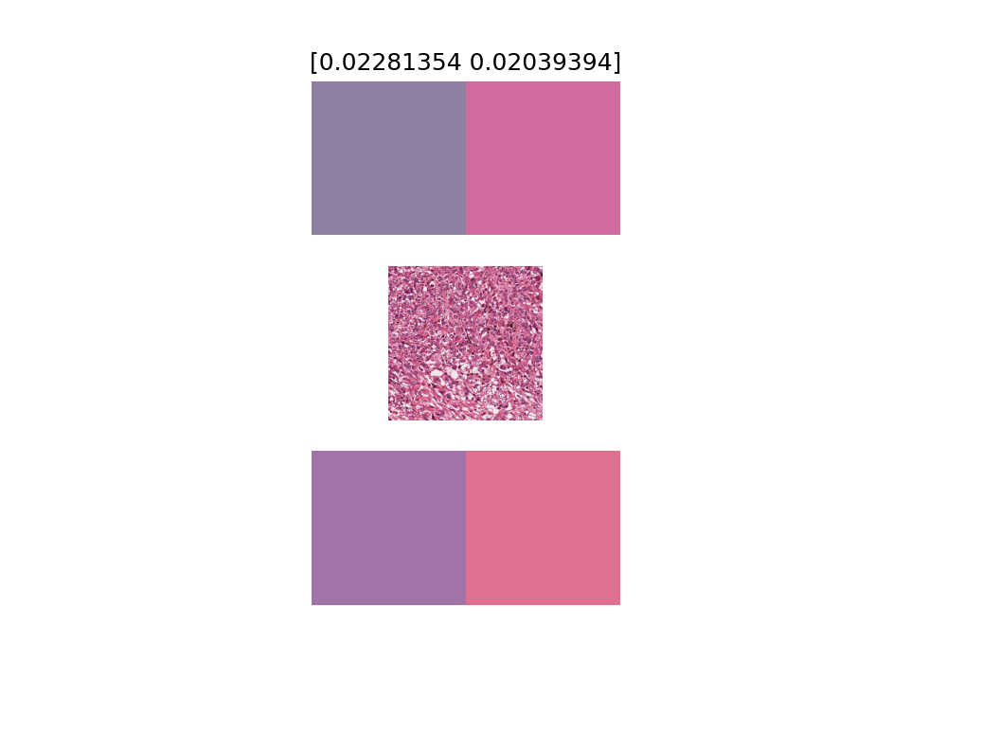

In [108]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
for patch_file in image_patches[0:]:
    fig,ax= plt.subplots(2,2)
#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)
    
    patch = plt.imread(patch_file)
    
    GT_file=patch_file.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    patch_id=GT_file.rsplit('/',2)[1]
    M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
    
    #Showing eveerything
    plt.subplot(311), display_M(M), plt.axis('off')
    plt.title(sigma)
#     plt.subplot(222), draw_M_distribution(M,sigma)
    plt.subplot(312),plt.imshow(patch), plt.axis('off')
    plt.subplot(313), display_M(M_GT), plt.axis('off')
    
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

In [94]:
od2rgb(M[:,0])/255

array([0.56078431, 0.50196078, 0.63137255])

In [104]:


drawing_h_circle=plt.Circle(M[0:2,0],s_h,color=od2rgb(M[:,0])/255)
e_circle=plt.Circle(M[0:2,1],s_e,color=od2rgb(M[:,1])/255)
# figure,axes=plt.subplots()
plt.subplot(122).set_aspect(1)
plt.subplot(122).add_artist(drawing_h_circle)
plt.subplot(122).add_artist(e_circle)
plt.show



<function matplotlib.pyplot.show(block=None)>

In [109]:
def draw_M_distribution(M,sigma):
    
    drawing_h_circle=plt.Circle(M[0:2,0],sigma[0],color=od2rgb(M[:,0])/255)
    e_circle=plt.Circle(M[0:2,1],sigma[1],color=od2rgb(M[:,1])/255)
    figure,axes=plt.subplots()
    axes.set_aspect(1)
    axes.add_artist(drawing_h_circle)
    axes.add_artist(e_circle)
    plt.show
    
def display_M(M):
    ns=M.shape[1]
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    plt.imshow(Mdisp)

<IPython.core.display.Javascript object>


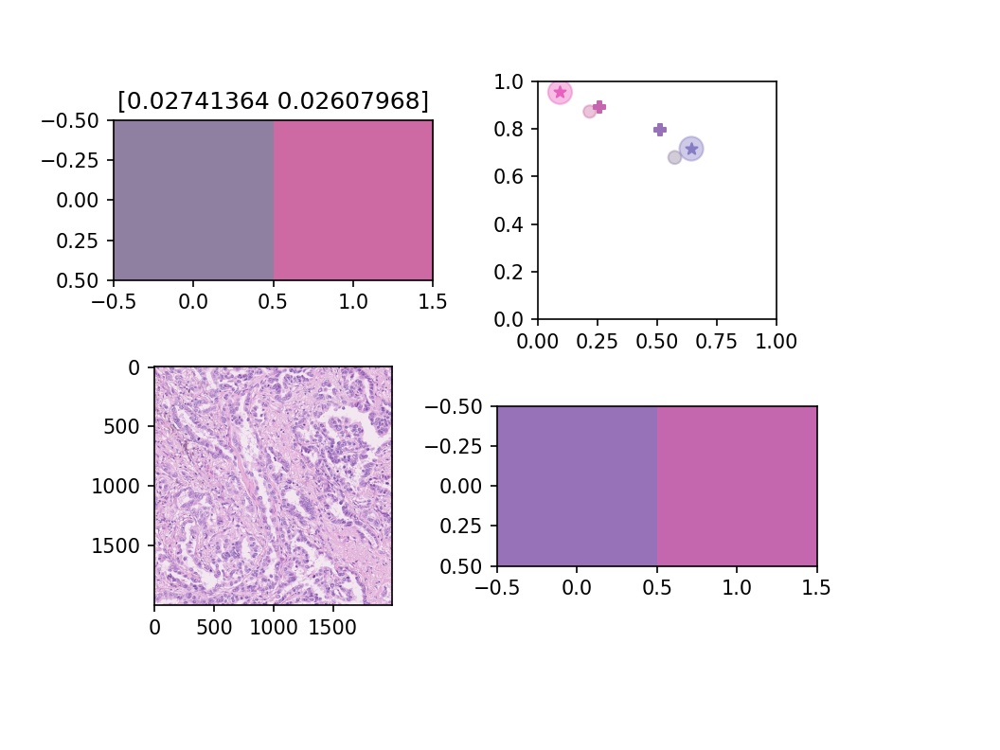

<IPython.core.display.Javascript object>


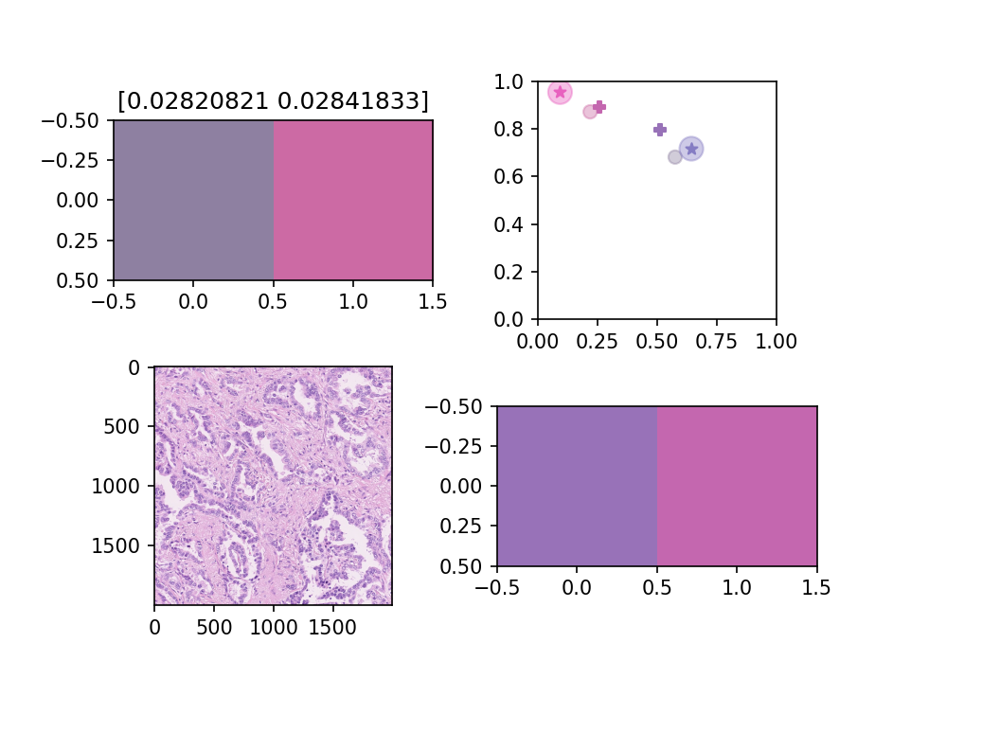

<IPython.core.display.Javascript object>


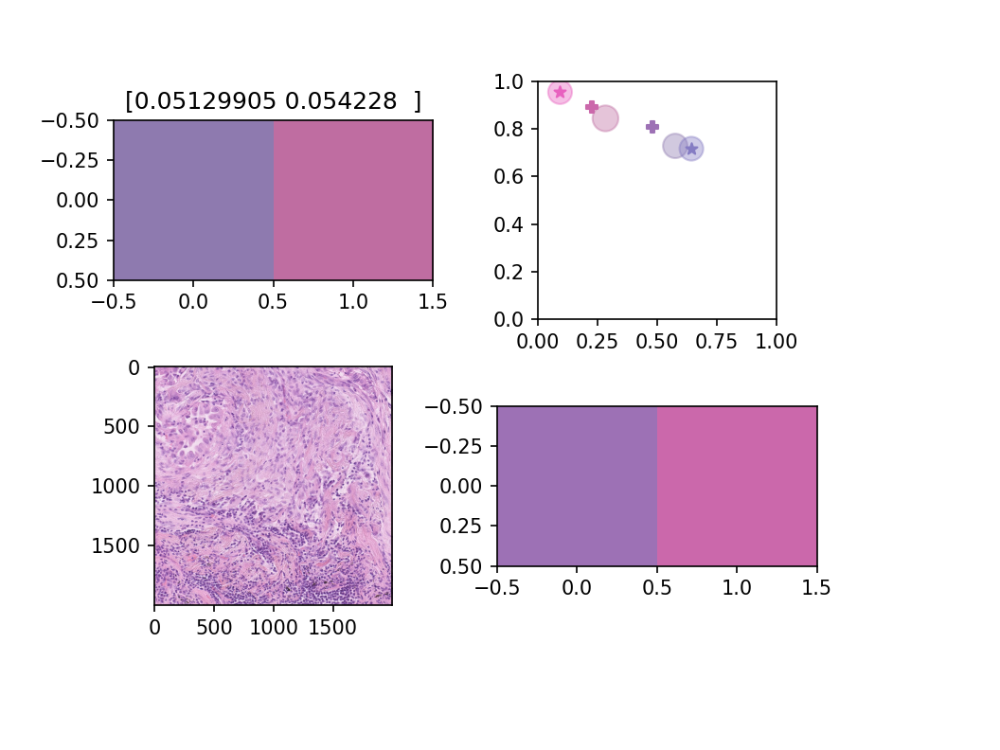

<IPython.core.display.Javascript object>


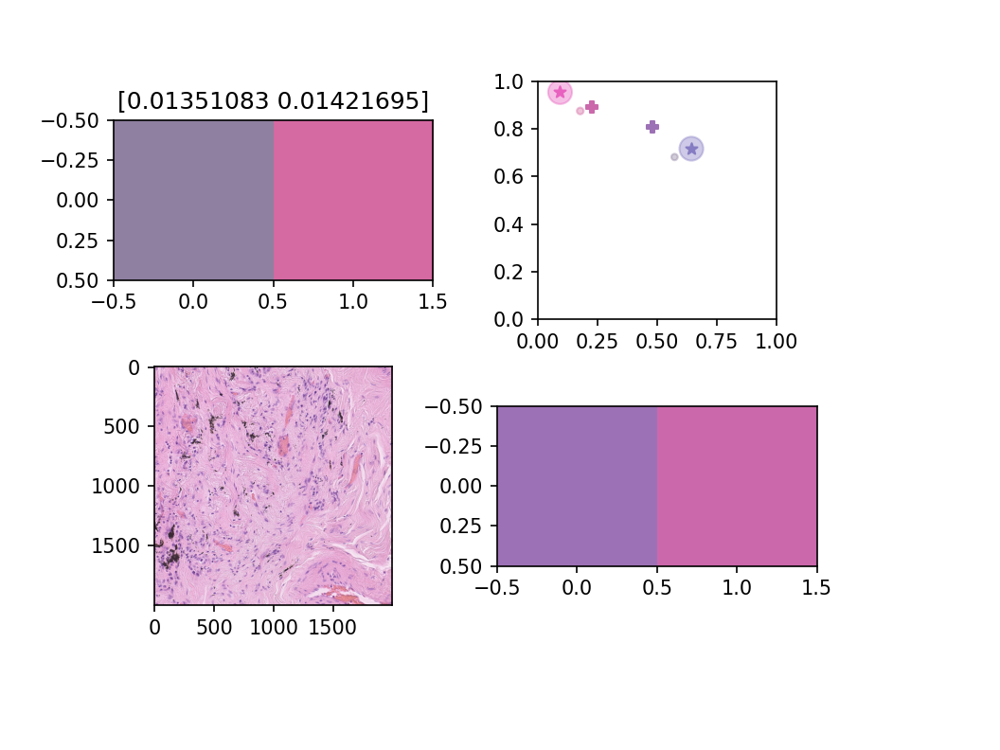

<IPython.core.display.Javascript object>


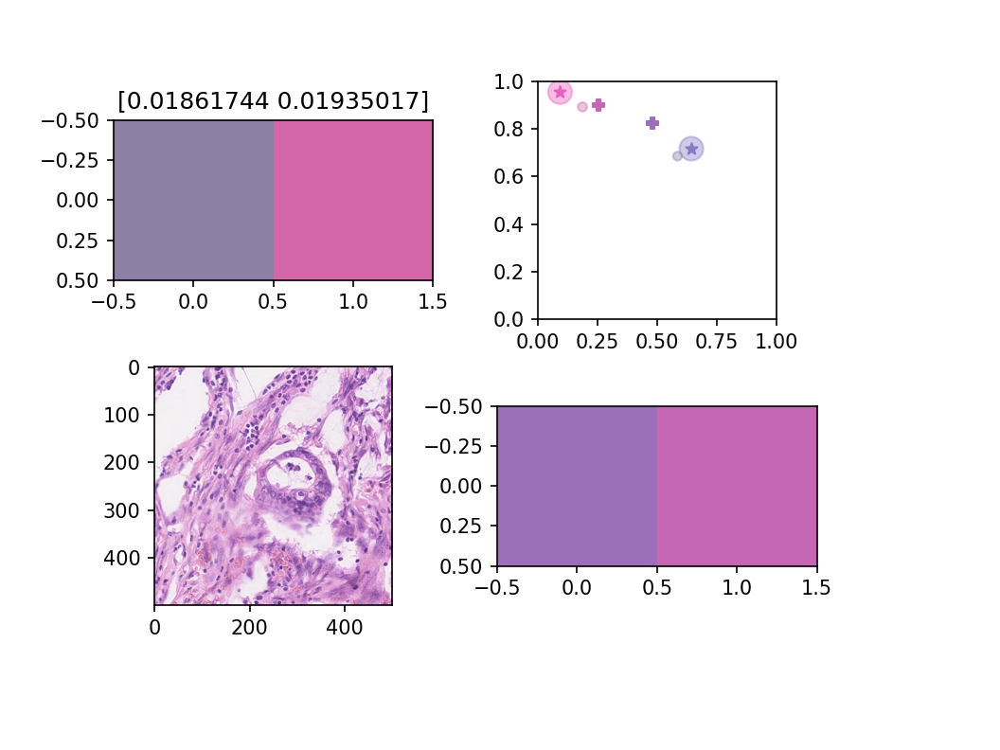

<IPython.core.display.Javascript object>


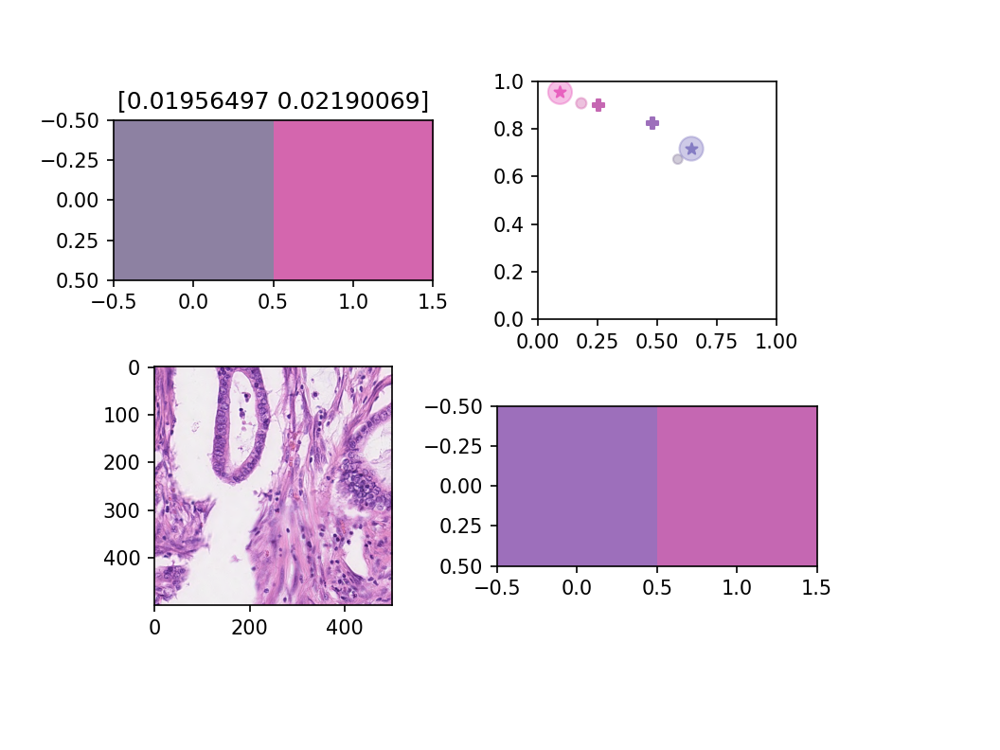

<IPython.core.display.Javascript object>


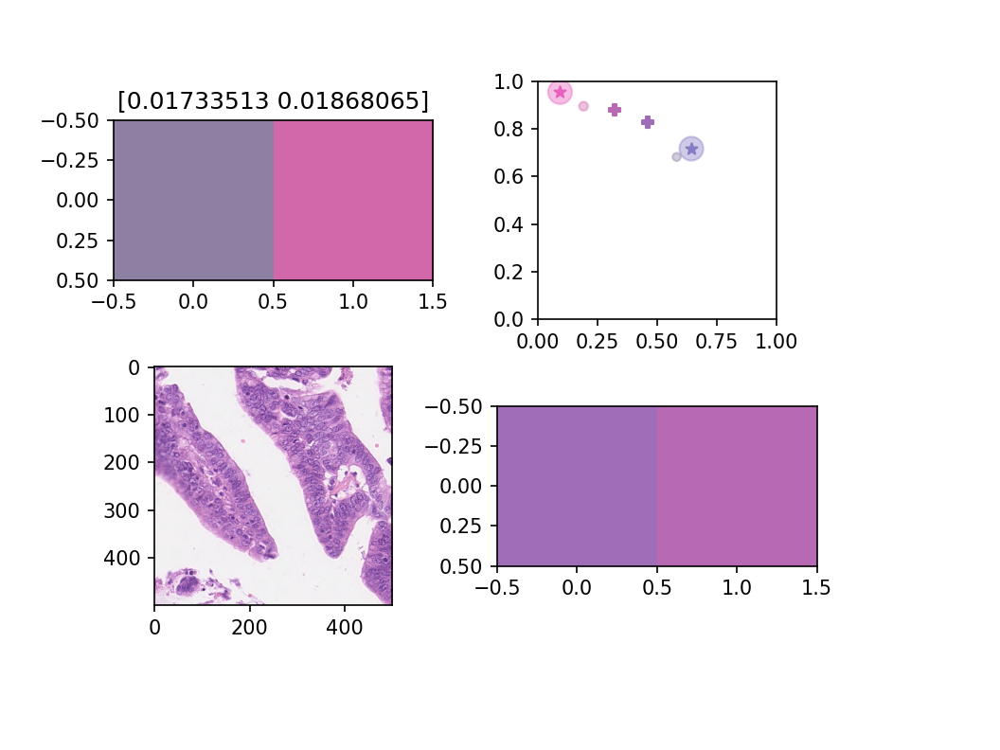

<IPython.core.display.Javascript object>


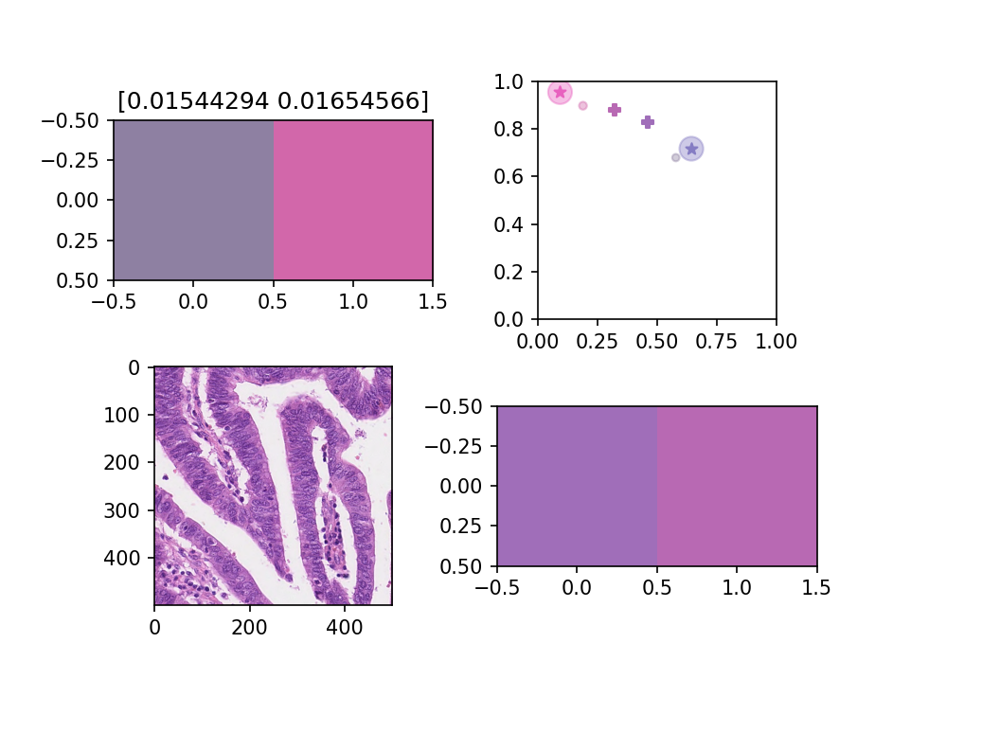

<IPython.core.display.Javascript object>


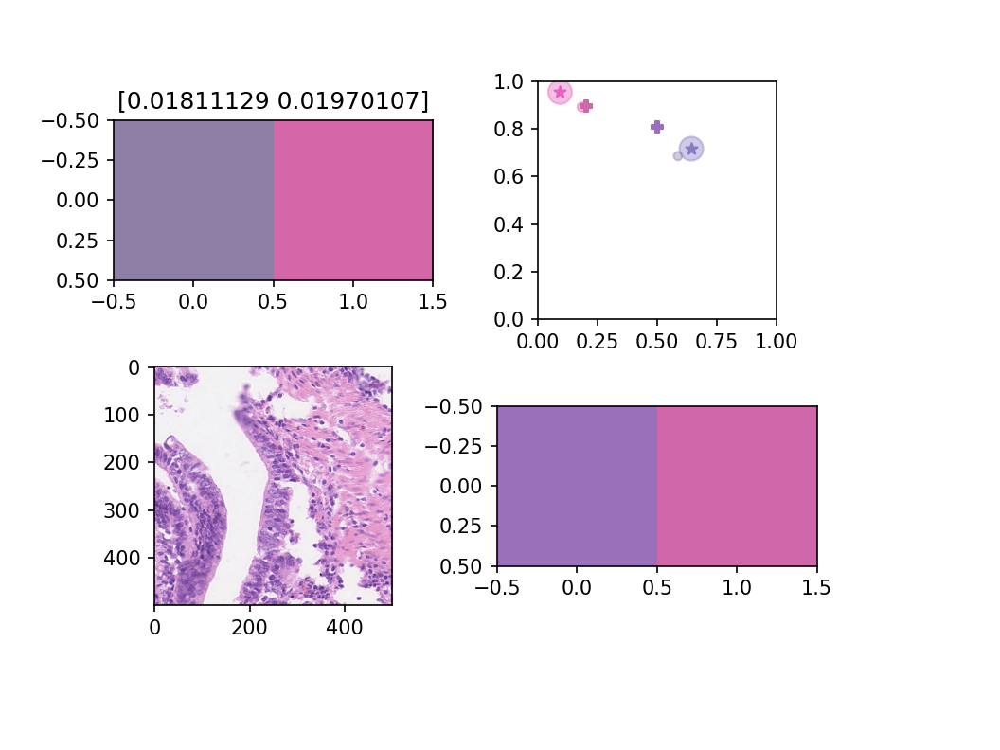

<IPython.core.display.Javascript object>


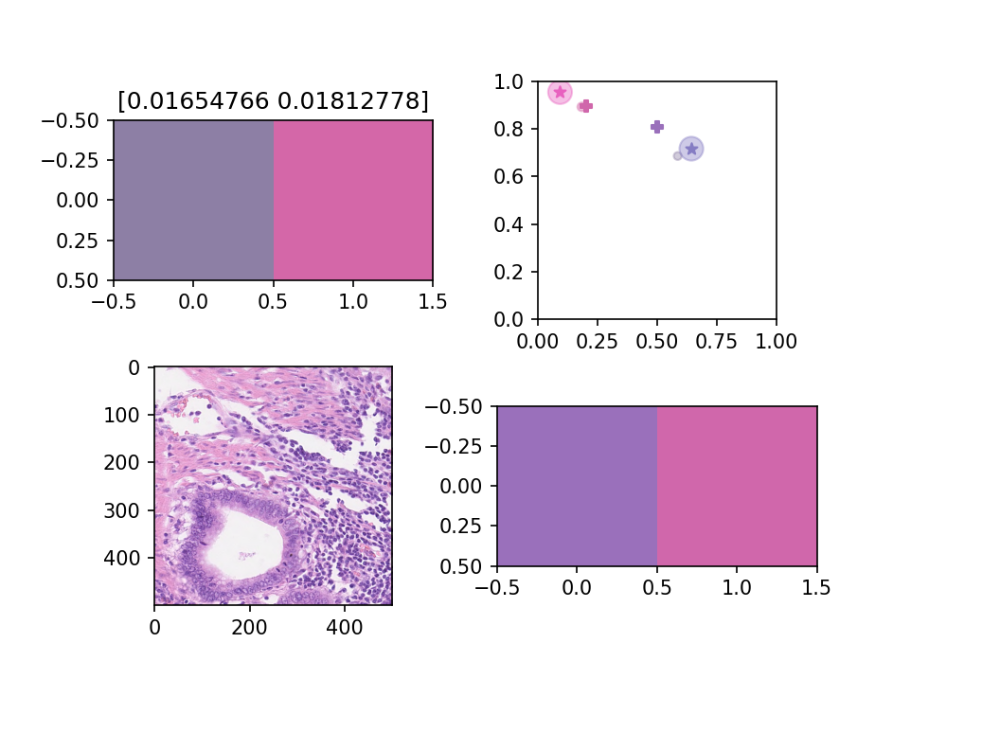

<IPython.core.display.Javascript object>


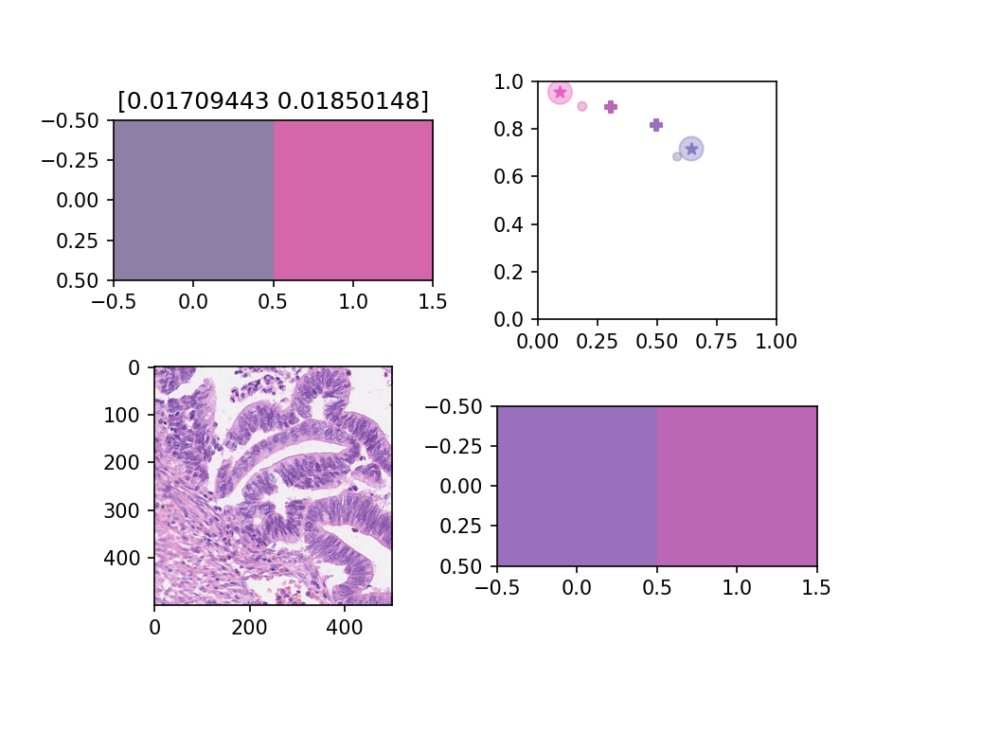

<IPython.core.display.Javascript object>


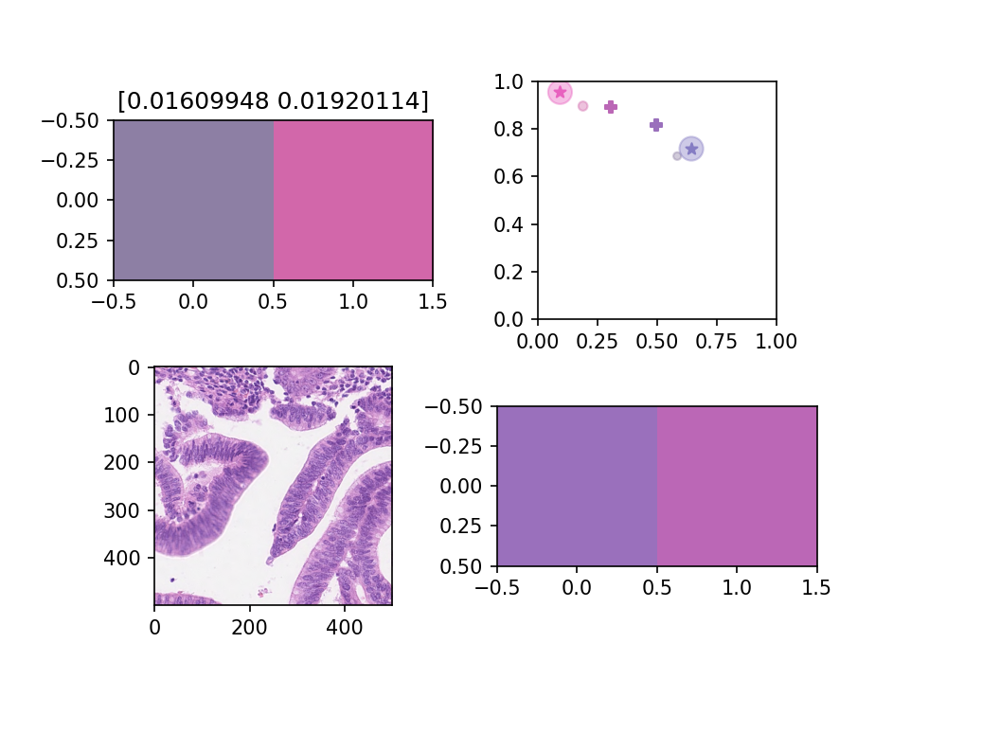

<IPython.core.display.Javascript object>


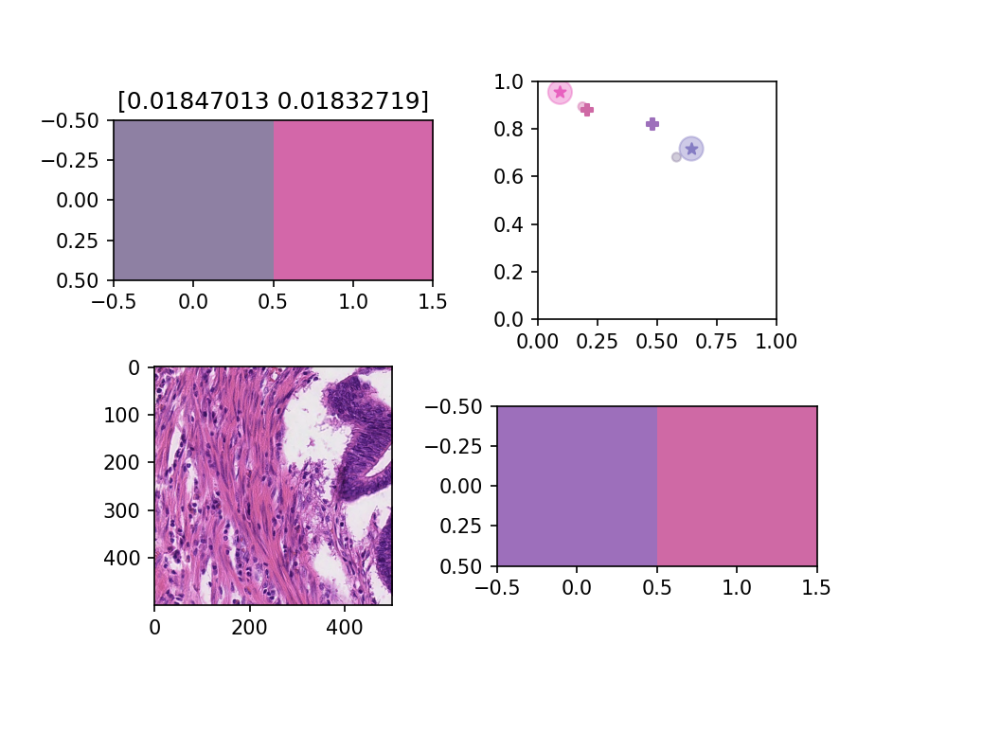

<IPython.core.display.Javascript object>


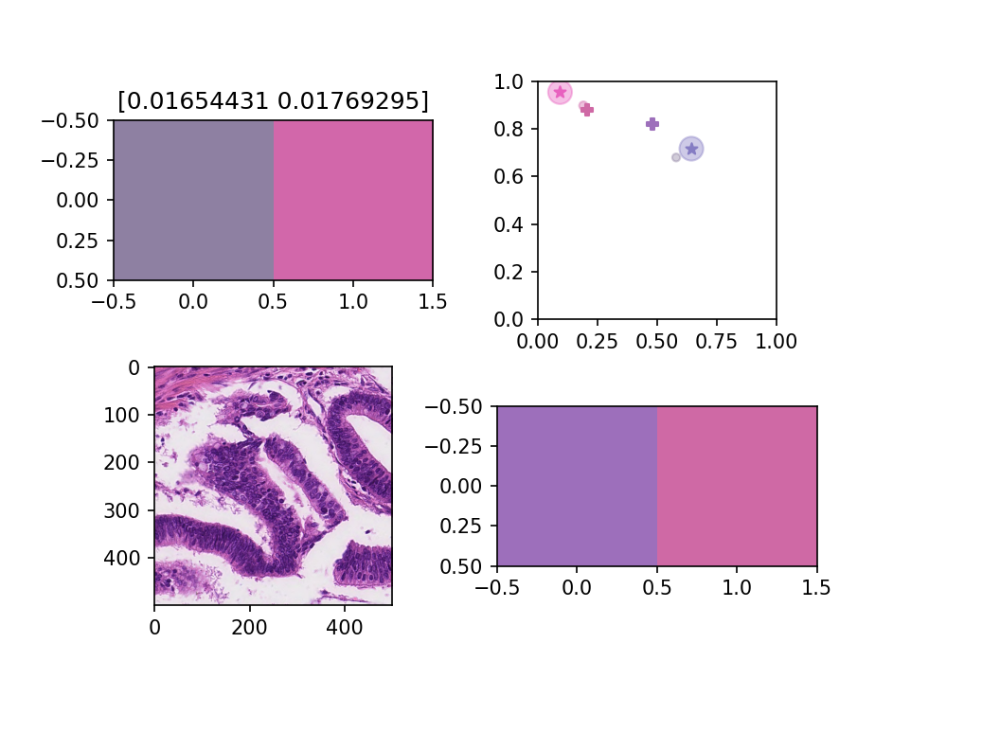

<IPython.core.display.Javascript object>


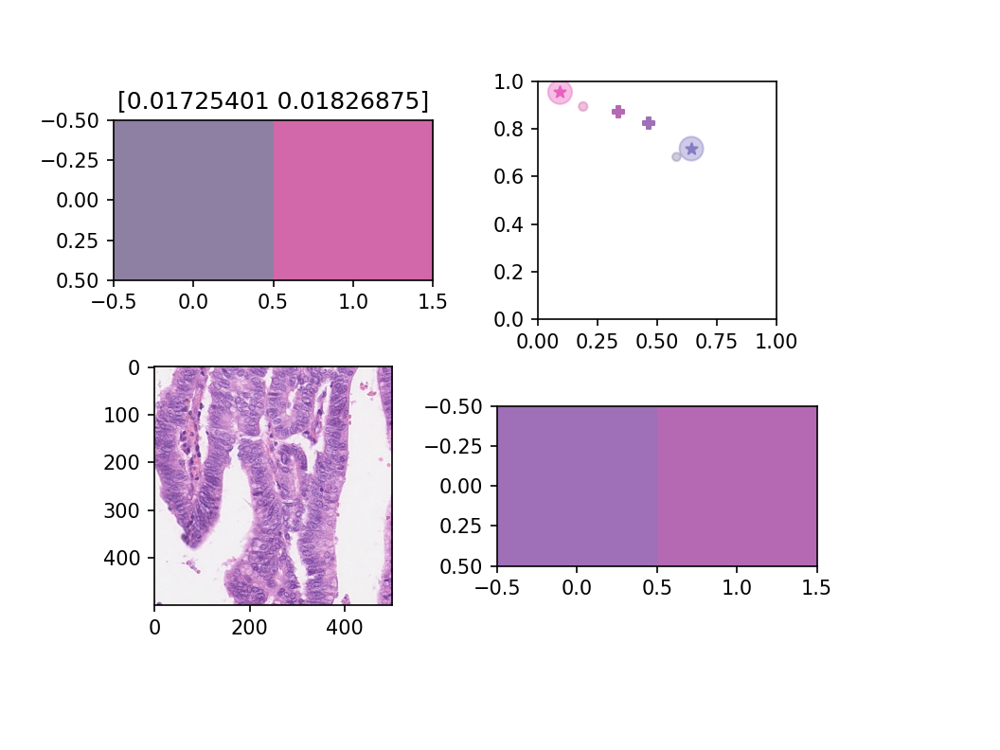

<IPython.core.display.Javascript object>


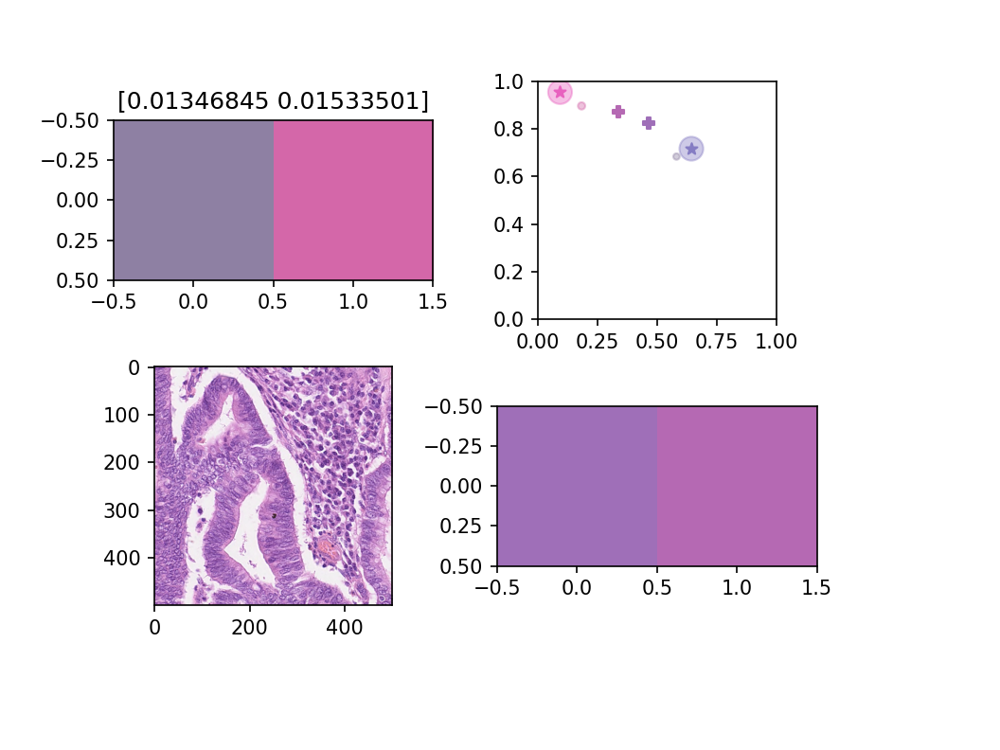

<IPython.core.display.Javascript object>


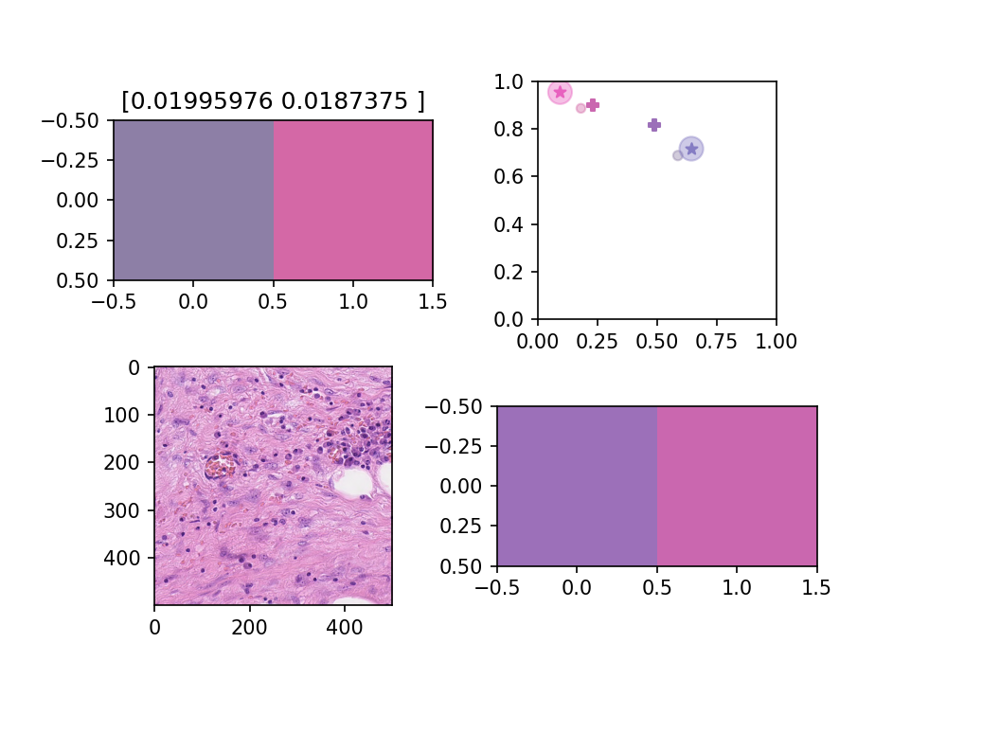

<IPython.core.display.Javascript object>


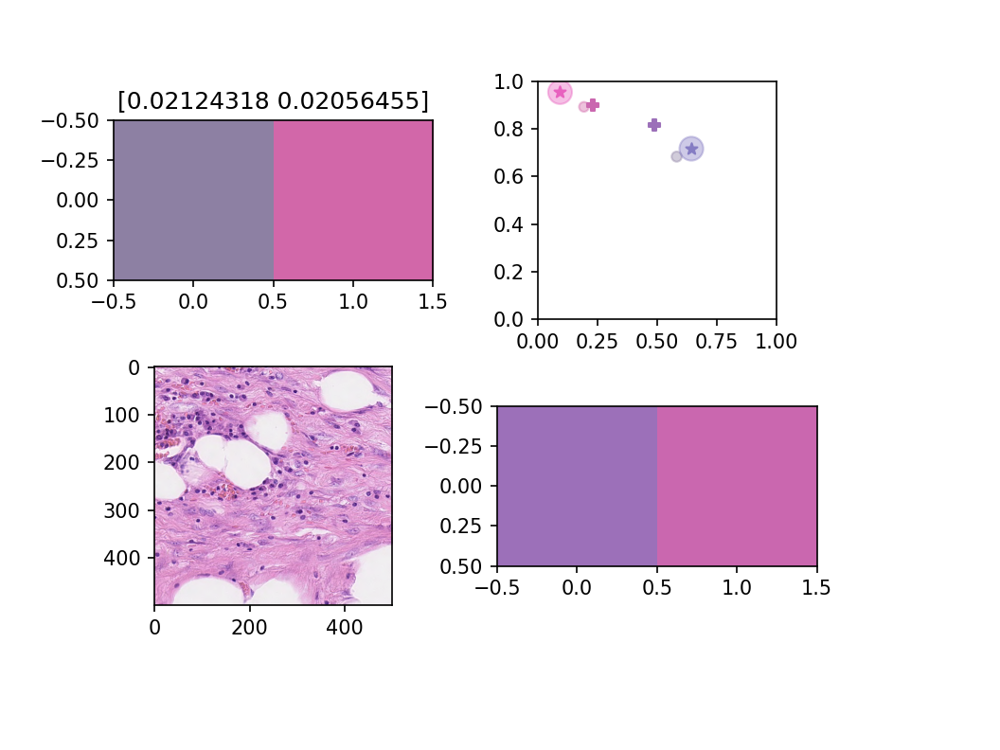

<IPython.core.display.Javascript object>


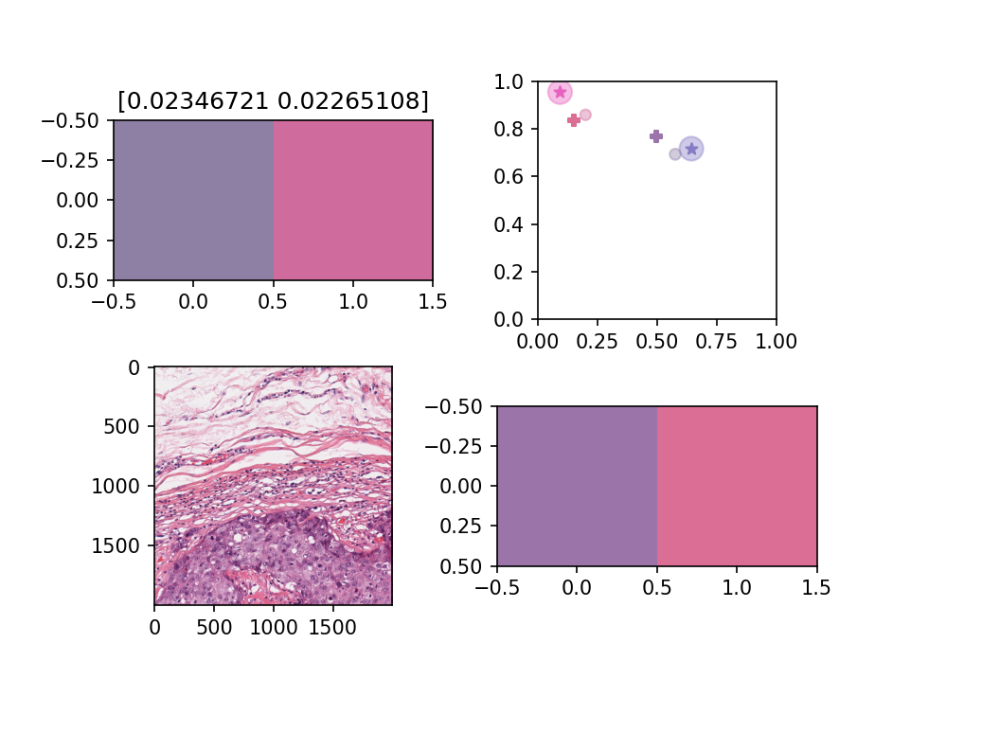

<IPython.core.display.Javascript object>


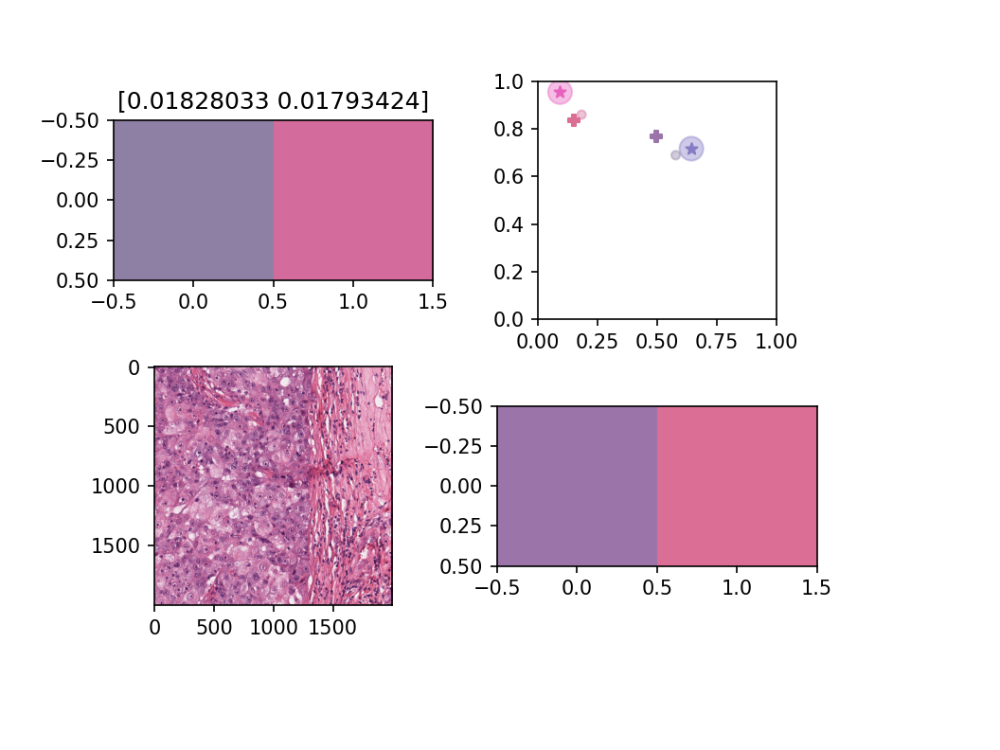

<IPython.core.display.Javascript object>


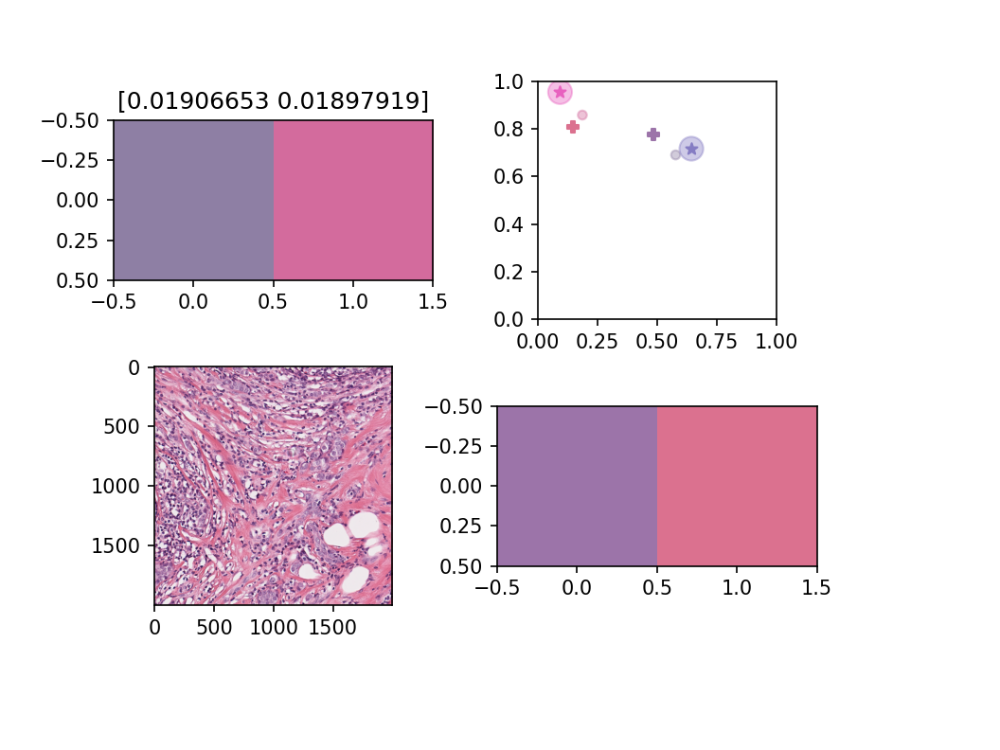

<IPython.core.display.Javascript object>


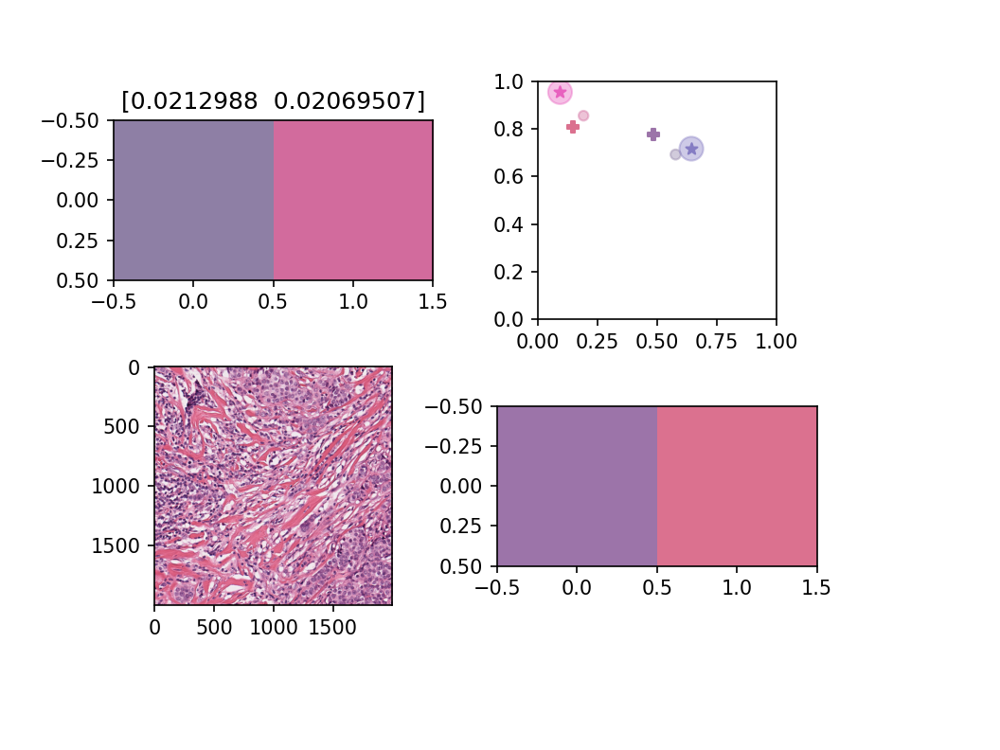

<IPython.core.display.Javascript object>


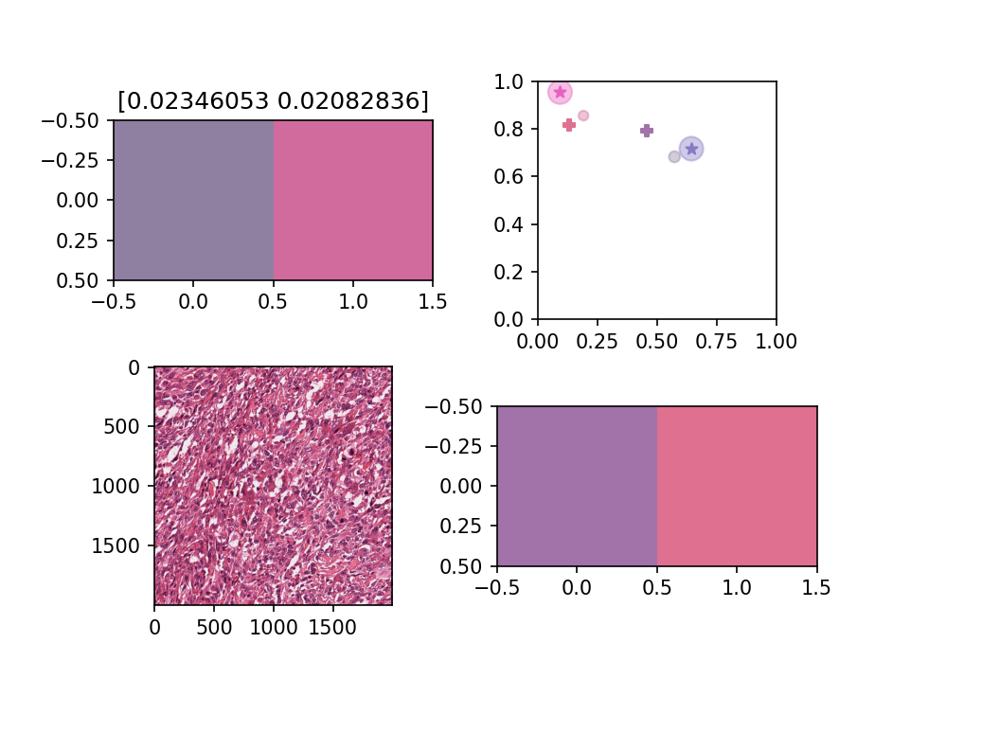

<IPython.core.display.Javascript object>


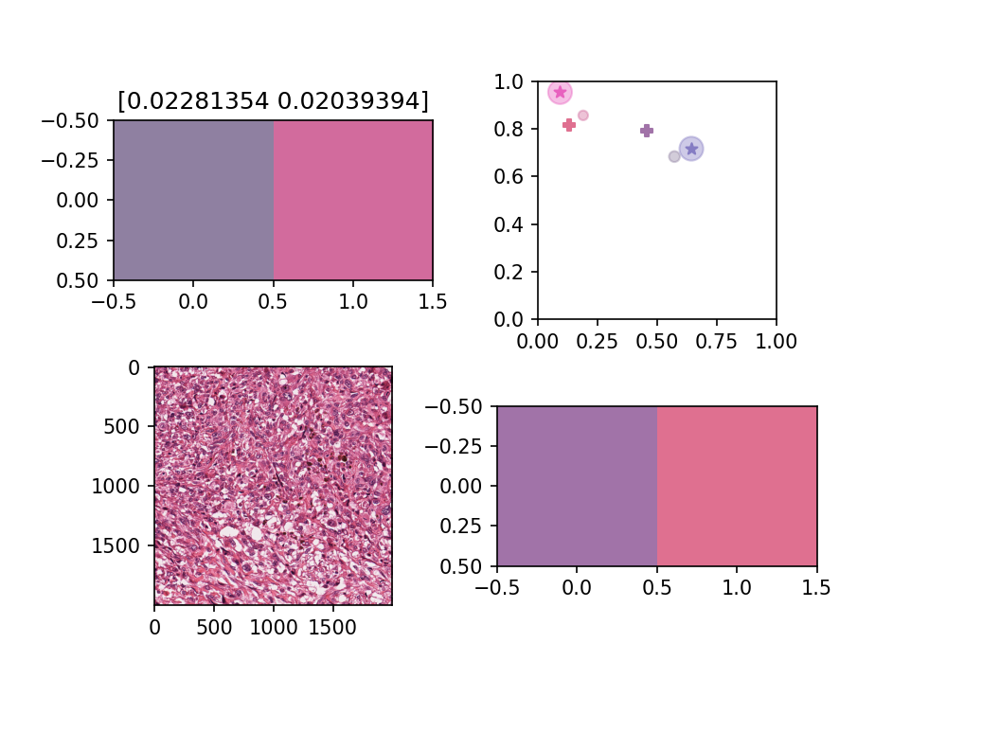

In [133]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2
for patch_file in image_patches[0:]:
    fig,ax= plt.subplots(2,2)
#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    
    
    h_circle=plt.Circle(M[0:2,0],sigma[0],color=od2rgb(M[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M[0:2,1],sigma[1],color=od2rgb(M[:,1])/255,alpha=0.4)

    
    
    patch = plt.imread(patch_file)
    
    GT_file=patch_file.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    patch_id=GT_file.rsplit('/',2)[1]
    M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
    Mdisp_GT=M_GT.T.reshape(1,ns,3)
    Mdisp_GT=od2rgb(Mdisp_GT).astype('int')
    
    
    
    #Showing eveerything
    ax[0,0].imshow(Mdisp)
    ax[0,0].set_title(sigma)
    
    ax[0,1].set_aspect(1)
    ax[0,1].add_artist(h_circle)
    ax[0,1].add_artist(e_circle)
    
    #Draw prior
    h_circle=plt.Circle(M_Ruifrok[0:2,0],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M_Ruifrok[0:2,1],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
    ax[0,1].add_artist(h_circle)
    ax[0,1].add_artist(e_circle)
    ax[0,1].scatter(M_Ruifrok[0,0],M_Ruifrok[1,0],marker='*',color=od2rgb(M_Ruifrok[:,0])/255)
    ax[0,1].scatter(M_Ruifrok[0,1],M_Ruifrok[1,1],marker='*',color=od2rgb(M_Ruifrok[:,1])/255)

    
    #Draw gt
    ax[0,1].scatter(M_GT[0,0],M_GT[1,0],marker='P',color=od2rgb(M_GT[:,0])/255)
    ax[0,1].scatter(M_GT[0,1],M_GT[1,1],marker='P',color=od2rgb(M_GT[:,1])/255)
    ax[0,1].set_xlim(0,1)
    ax[0,1].set_ylim(0,1)

    ax[1,0].imshow(patch)
    ax[1,1].imshow(Mdisp_GT)
    
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

<IPython.core.display.Javascript object>


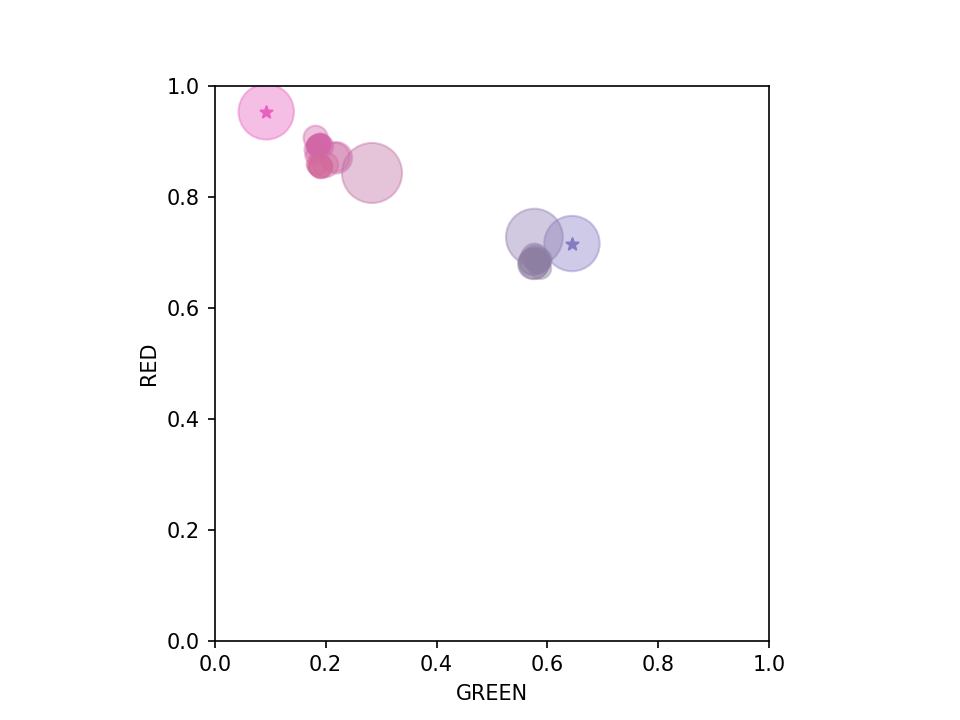

In [131]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2
fig,ax= plt.subplots()
ax.set_aspect(1)

ax.set_ylabel('RED')
ax.set_xlabel('GREEN')

h_circle=plt.Circle(M_Ruifrok[0:2,0],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
e_circle=plt.Circle(M_Ruifrok[0:2,1],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
ax.add_artist(h_circle)
ax.add_artist(e_circle)
ax.scatter(M_Ruifrok[0,0],M_Ruifrok[1,0],marker='*',color=od2rgb(M_Ruifrok[:,0])/255)
ax.scatter(M_Ruifrok[0,1],M_Ruifrok[1,1],marker='*',color=od2rgb(M_Ruifrok[:,1])/255)
ax.set_xlim(0,1)
ax.set_ylim(0,1)
for patch_file in image_patches[0:]:

#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    
    
    h_circle=plt.Circle(M[0:2,0],sigma[0],color=od2rgb(M[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M[0:2,1],sigma[1],color=od2rgb(M[:,1])/255,alpha=0.4)

    

    ax.add_artist(h_circle)
    ax.add_artist(e_circle)
    

    
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

In [40]:
np.linalg.norm(3)

3.0

<IPython.core.display.Javascript object>


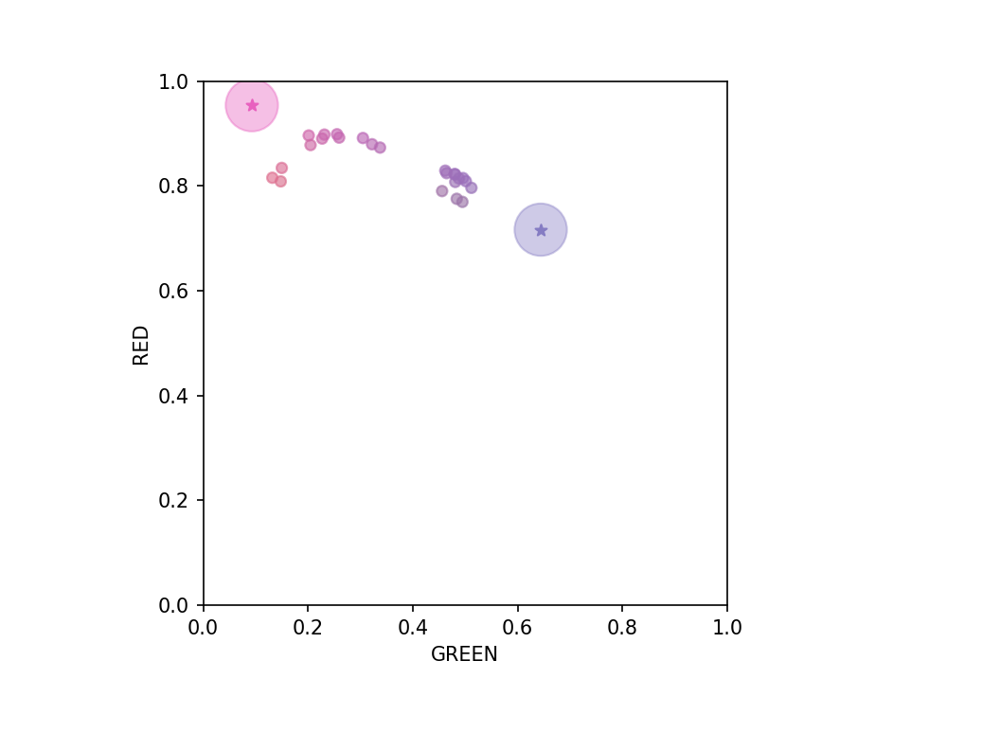

In [140]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2
fig,ax= plt.subplots()
ax.set_aspect(1)

ax.set_ylabel('RED')
ax.set_xlabel('GREEN')

h_circle=plt.Circle(M_Ruifrok[0:2,0],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
e_circle=plt.Circle(M_Ruifrok[0:2,1],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
ax.add_artist(h_circle)
ax.add_artist(e_circle)
ax.scatter(M_Ruifrok[0,0],M_Ruifrok[1,0],marker='*',color=od2rgb(M_Ruifrok[:,0])/255)
ax.scatter(M_Ruifrok[0,1],M_Ruifrok[1,1],marker='*',color=od2rgb(M_Ruifrok[:,1])/255)
ax.set_xlim(0,1)
ax.set_ylim(0,1)

for patch_file in image_patches[0:]:

#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    

    GT_file=patch_file.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    patch_id=GT_file.rsplit('/',2)[1]
    M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
    
    h_circle=plt.Circle(M_GT[0:2,0],0.01,color=od2rgb(M_GT[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M_GT[0:2,1],0.01,color=od2rgb(M_GT[:,1])/255,alpha=0.4)

    

    ax.add_artist(h_circle)
    ax.add_artist(e_circle)
    

    
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

In [138]:
print(od2rgb(M_GT))

print(M_GT)

[[161 223]
 [115 112]
 [168 144]]
[[0.45592696 0.13188943]
 [0.79024809 0.81566237]
 [0.40943689 0.56329396]]


<IPython.core.display.Javascript object>


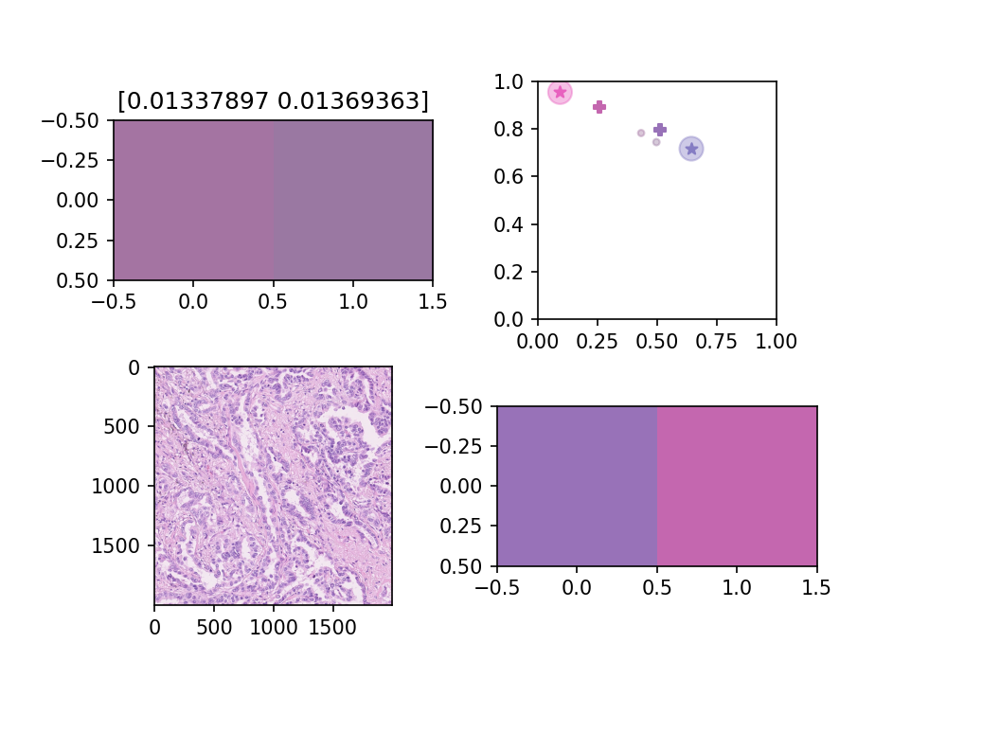

<IPython.core.display.Javascript object>


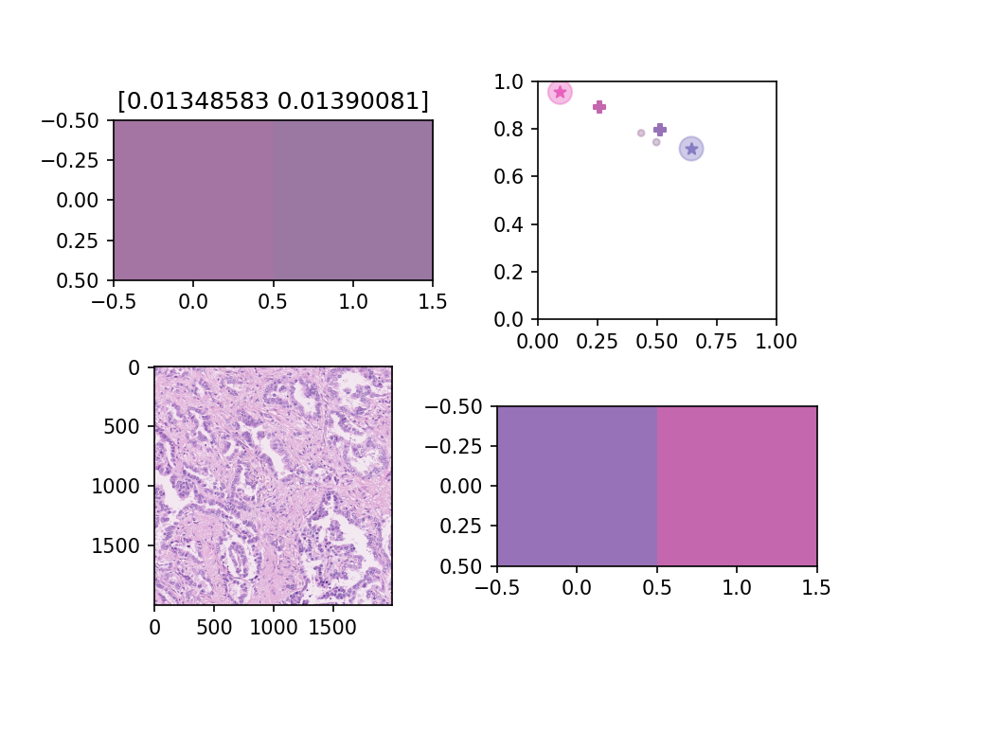

<IPython.core.display.Javascript object>


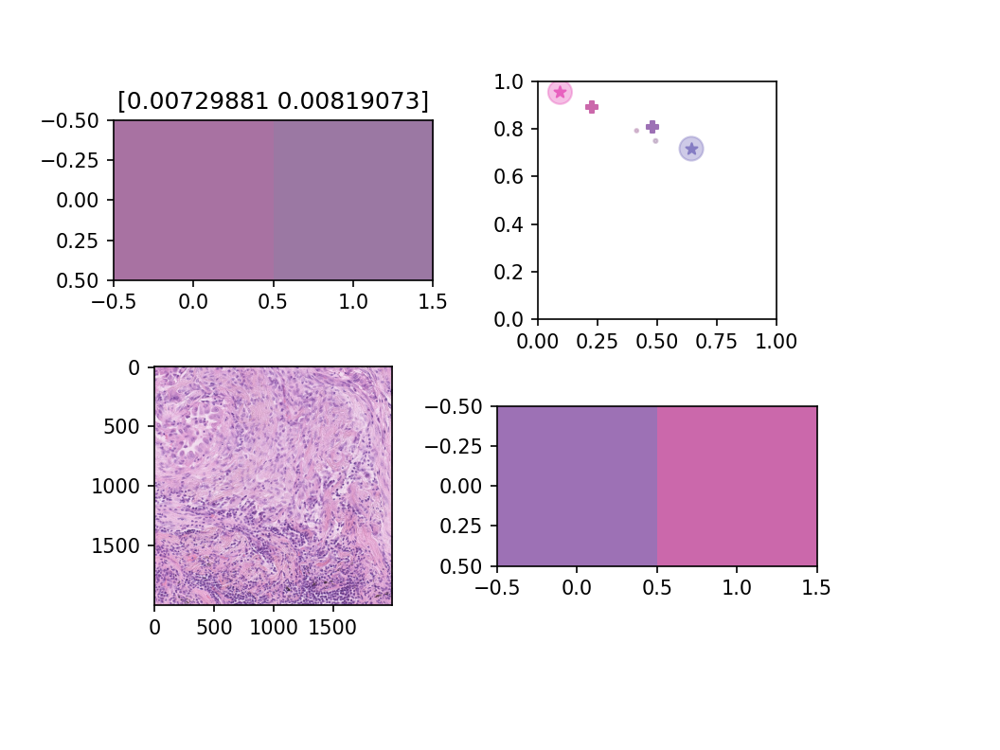

<IPython.core.display.Javascript object>


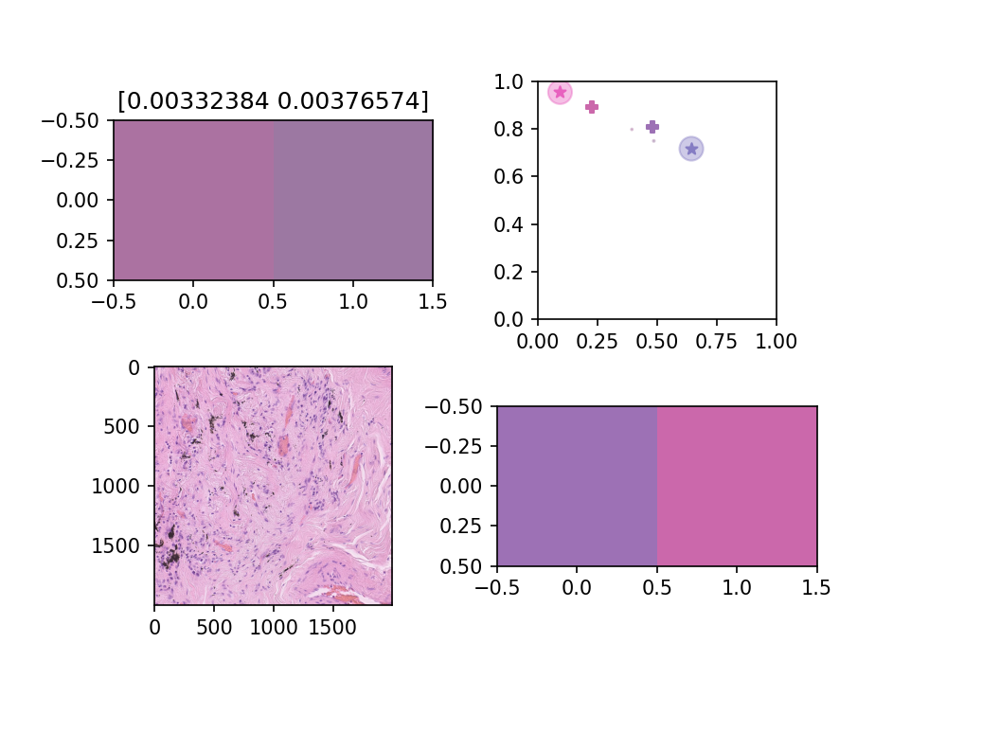

<IPython.core.display.Javascript object>


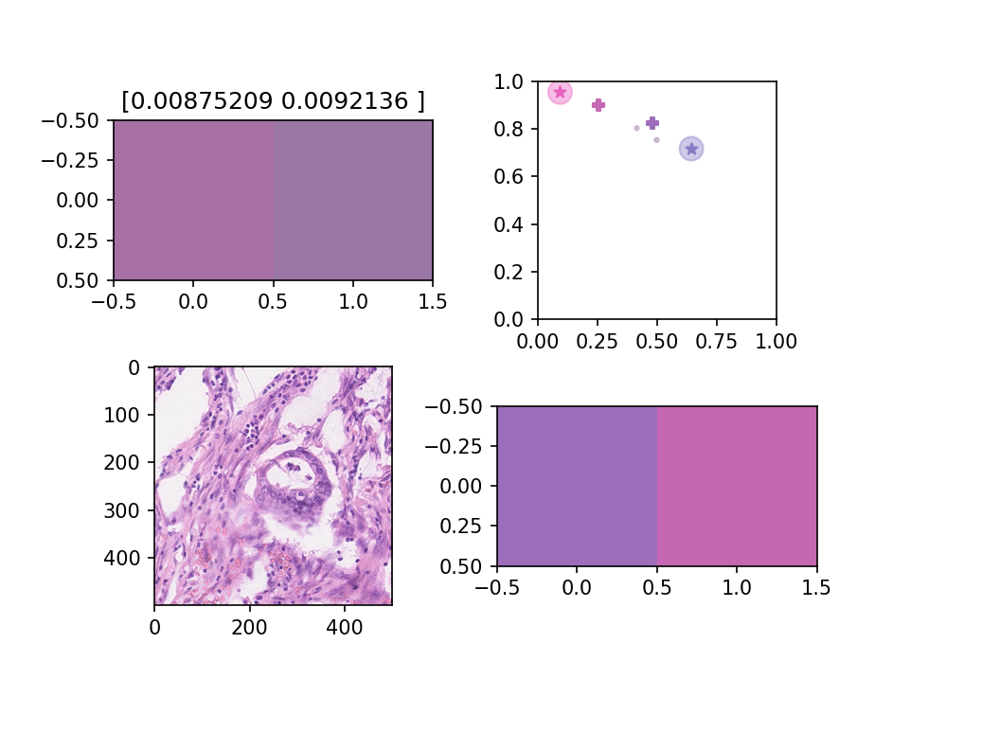

<IPython.core.display.Javascript object>


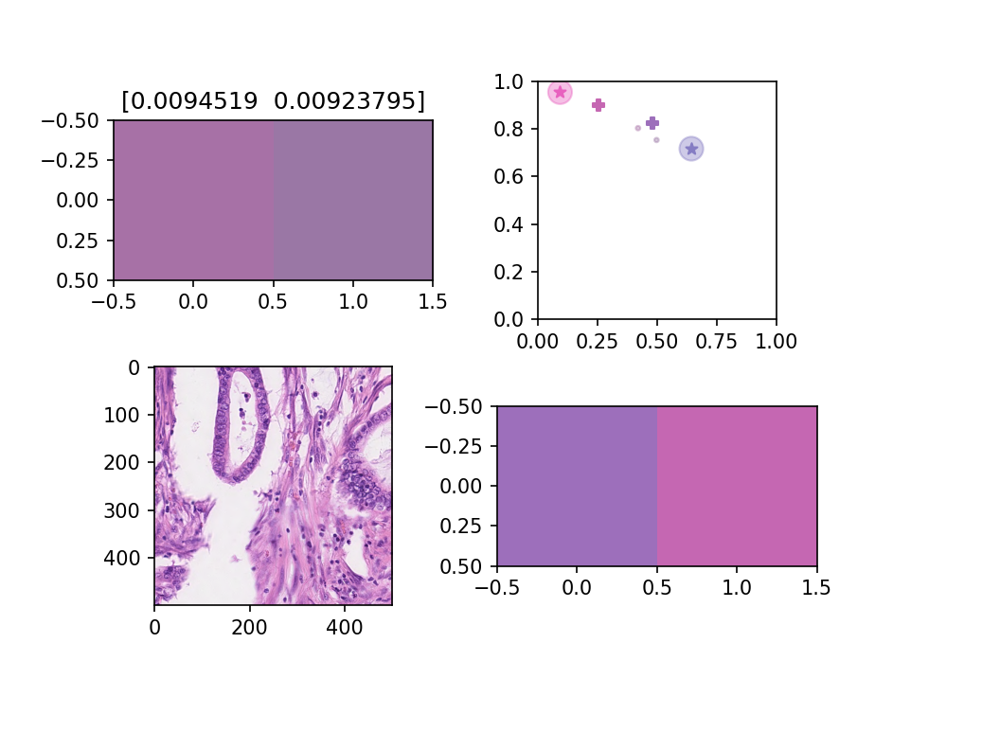

<IPython.core.display.Javascript object>


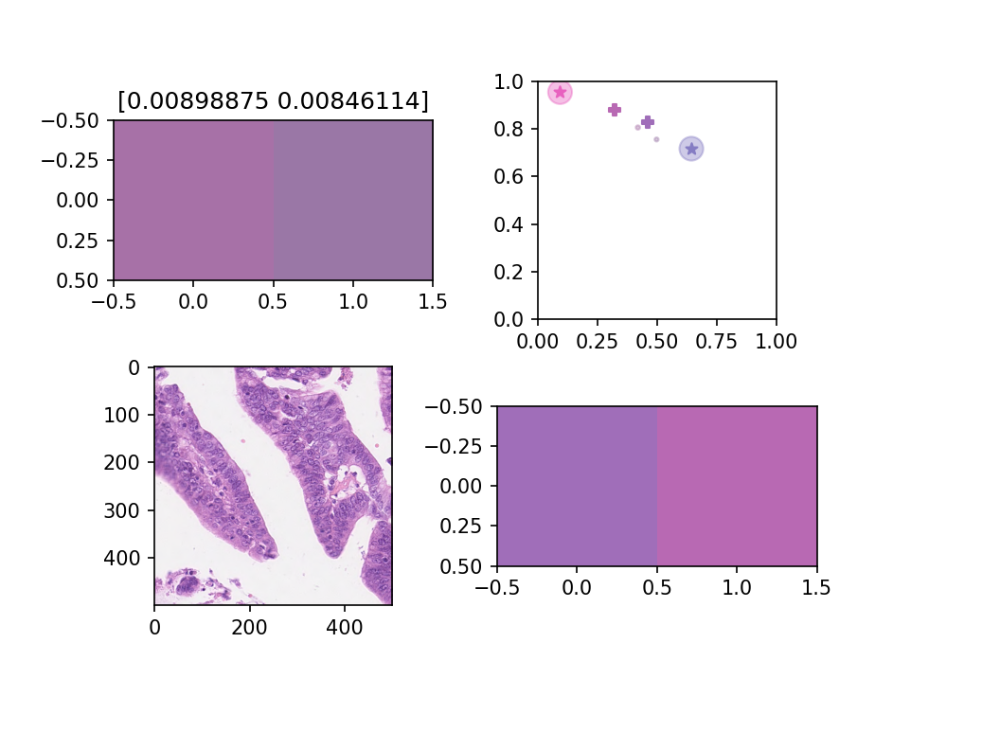

<IPython.core.display.Javascript object>


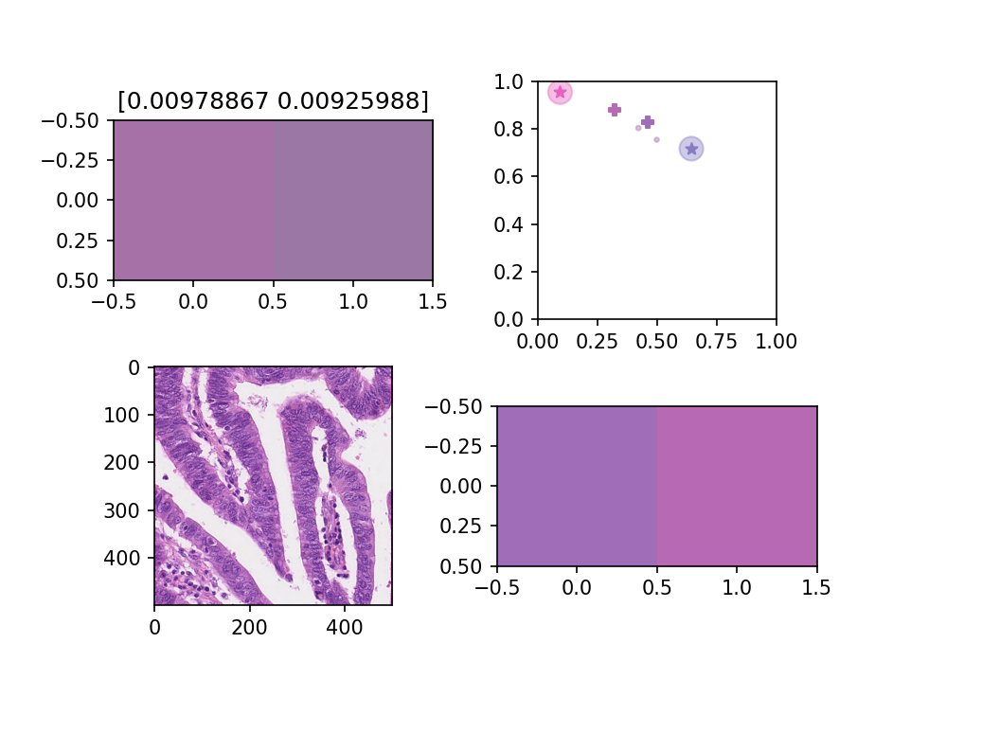

<IPython.core.display.Javascript object>


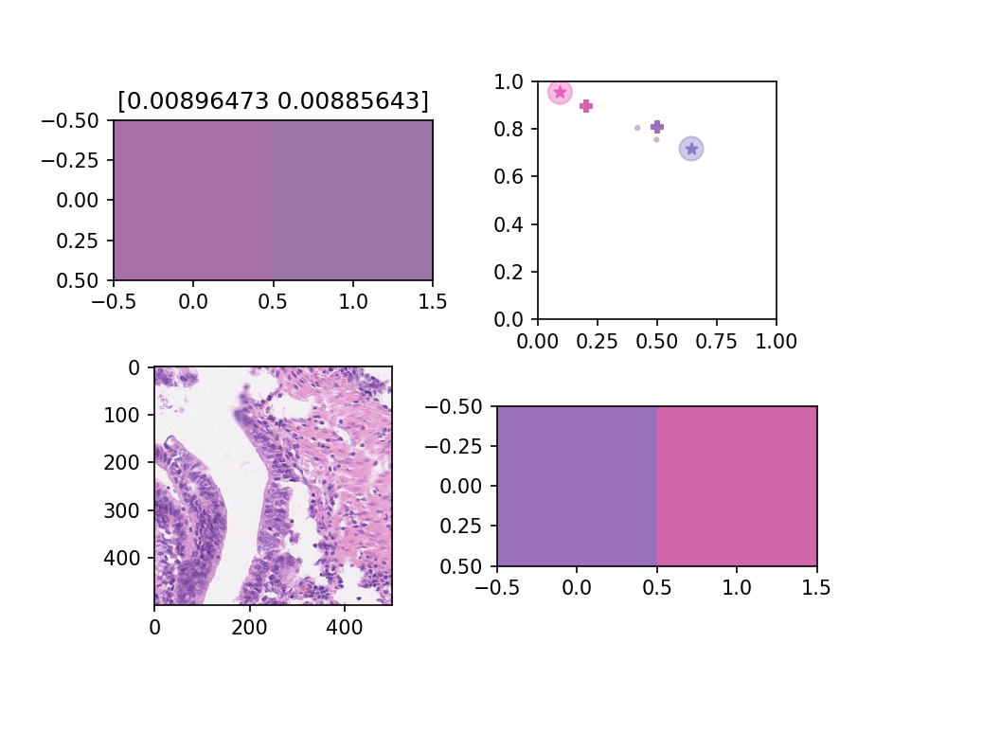

<IPython.core.display.Javascript object>


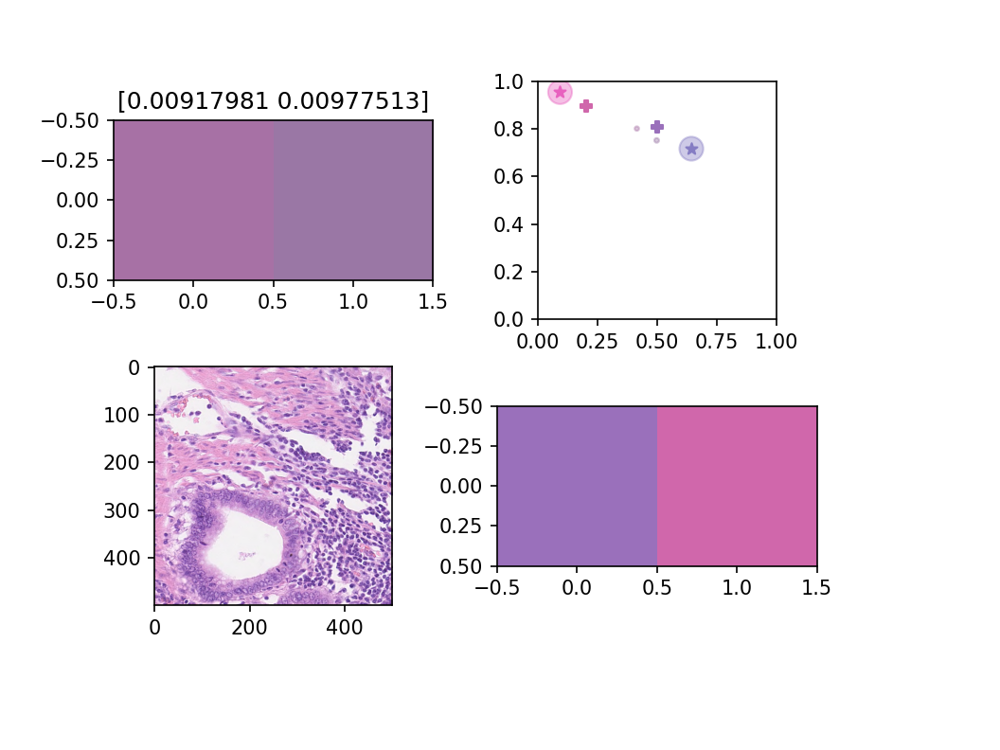

<IPython.core.display.Javascript object>


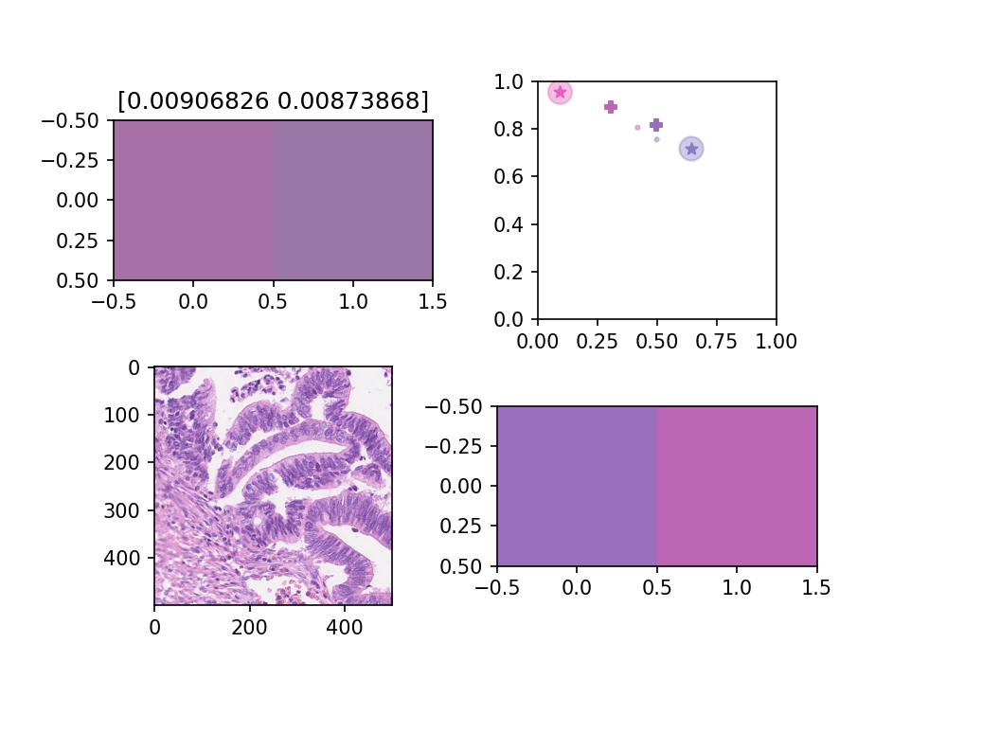

<IPython.core.display.Javascript object>


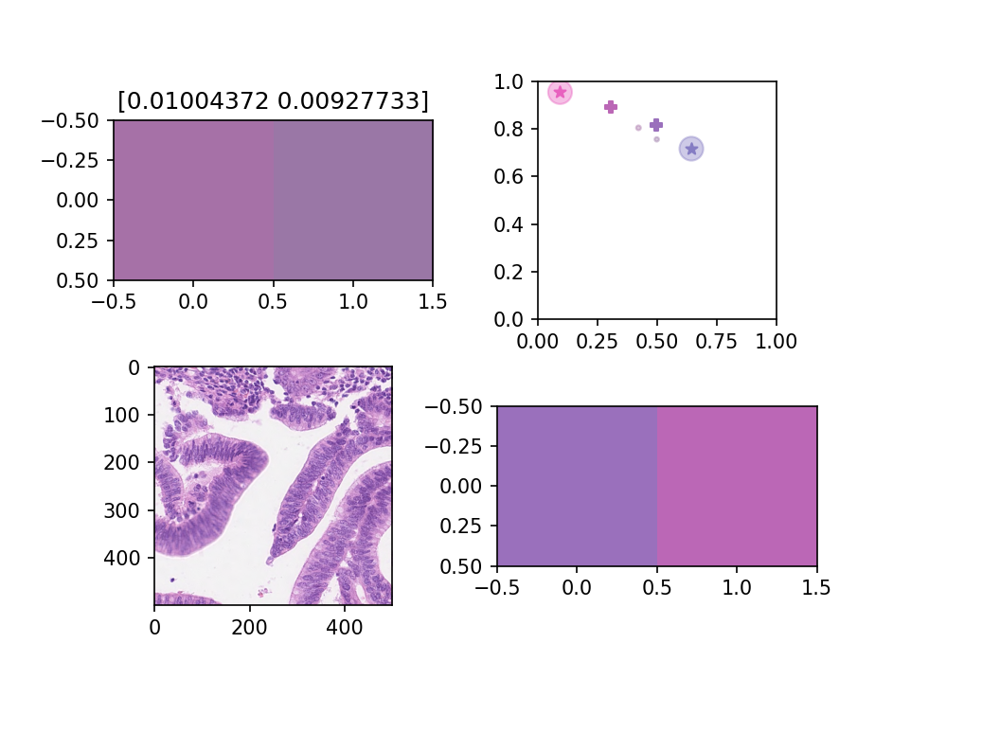

<IPython.core.display.Javascript object>


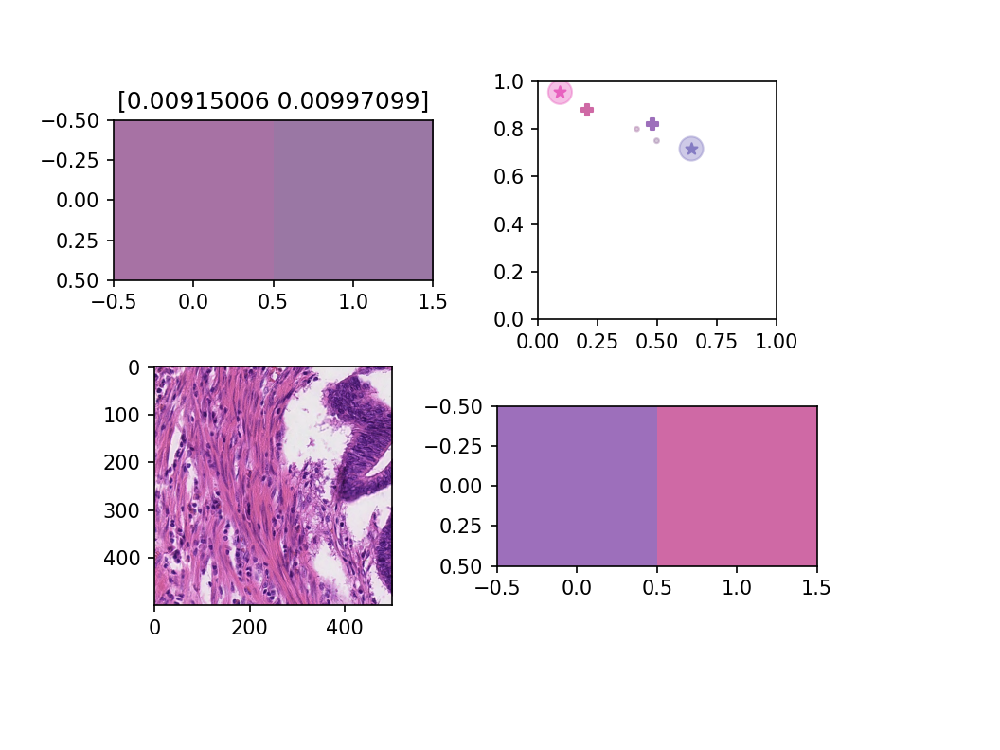

<IPython.core.display.Javascript object>


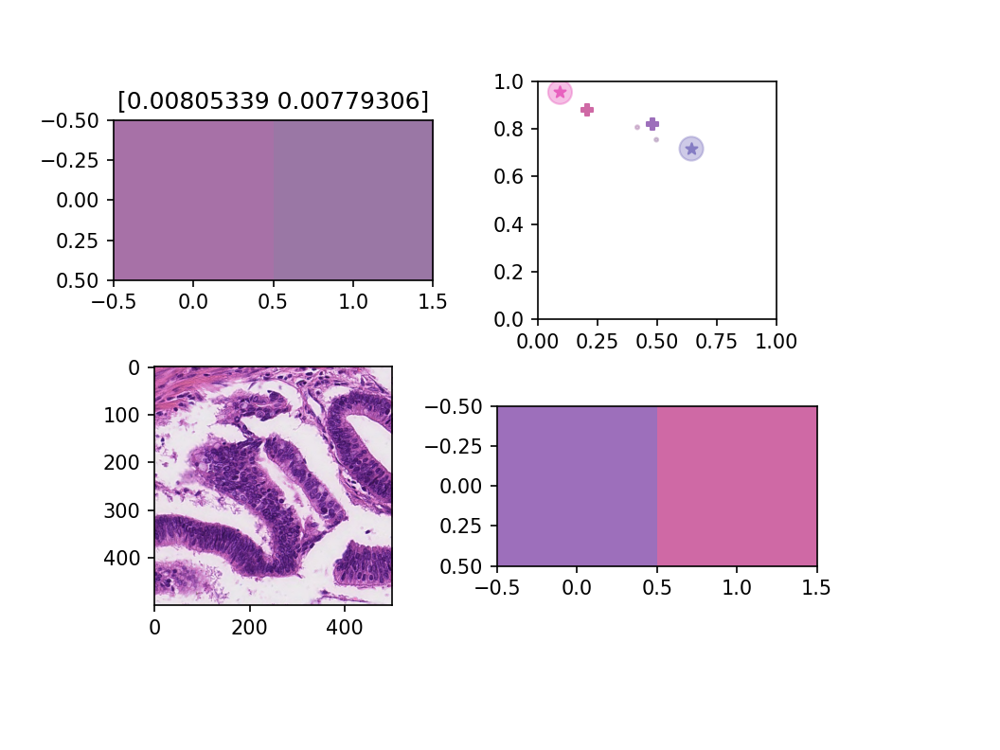

<IPython.core.display.Javascript object>


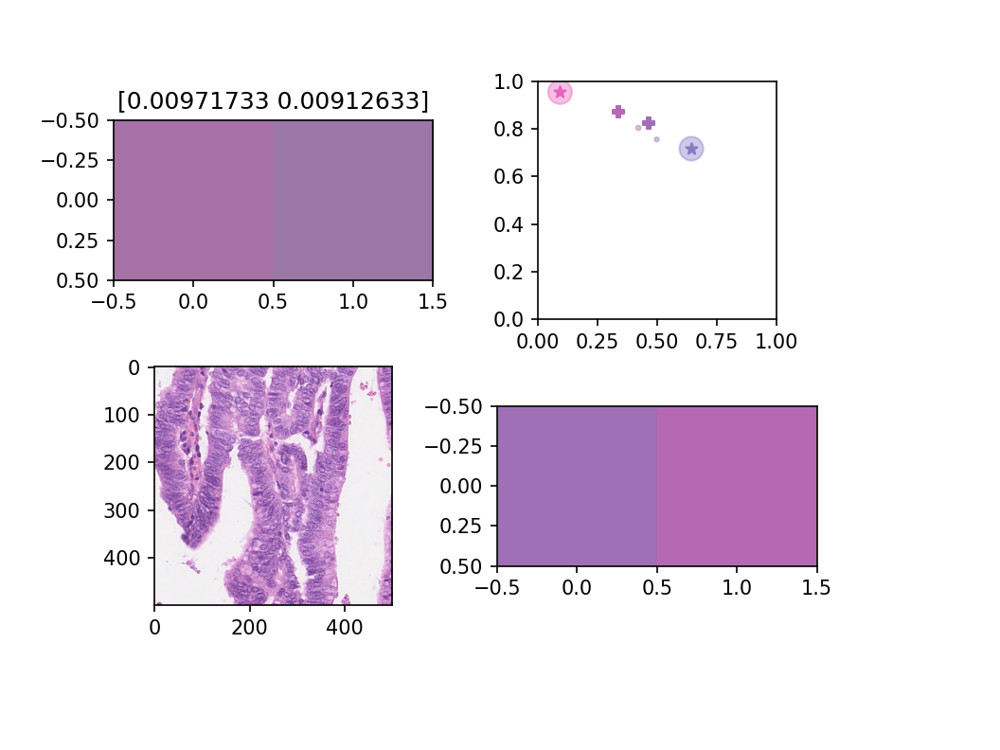

<IPython.core.display.Javascript object>


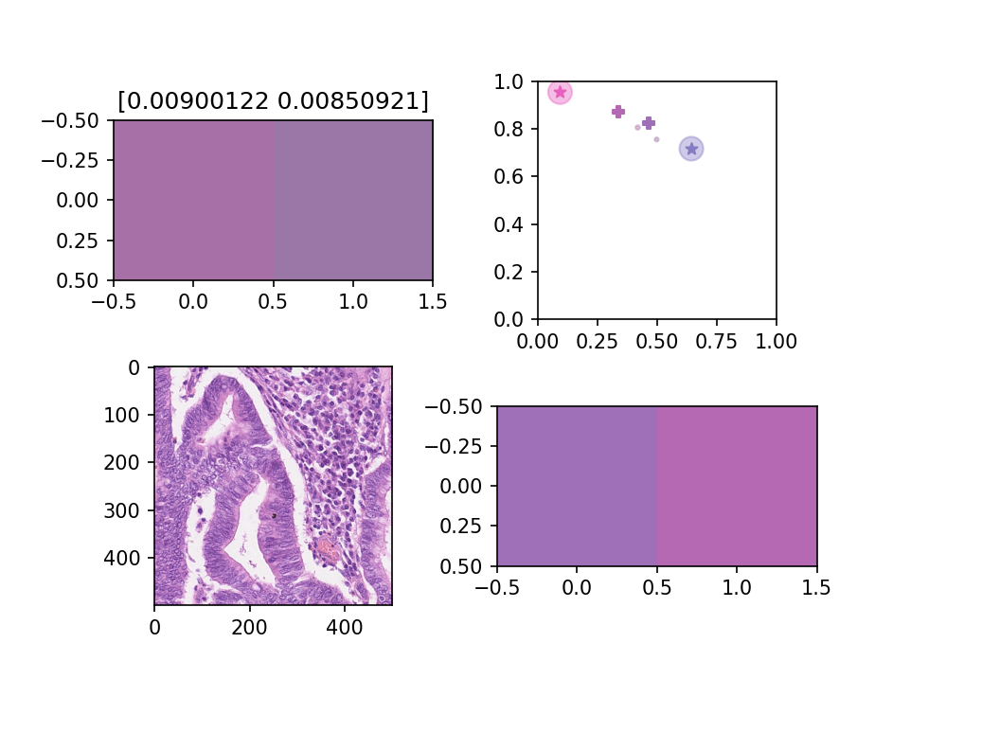

<IPython.core.display.Javascript object>


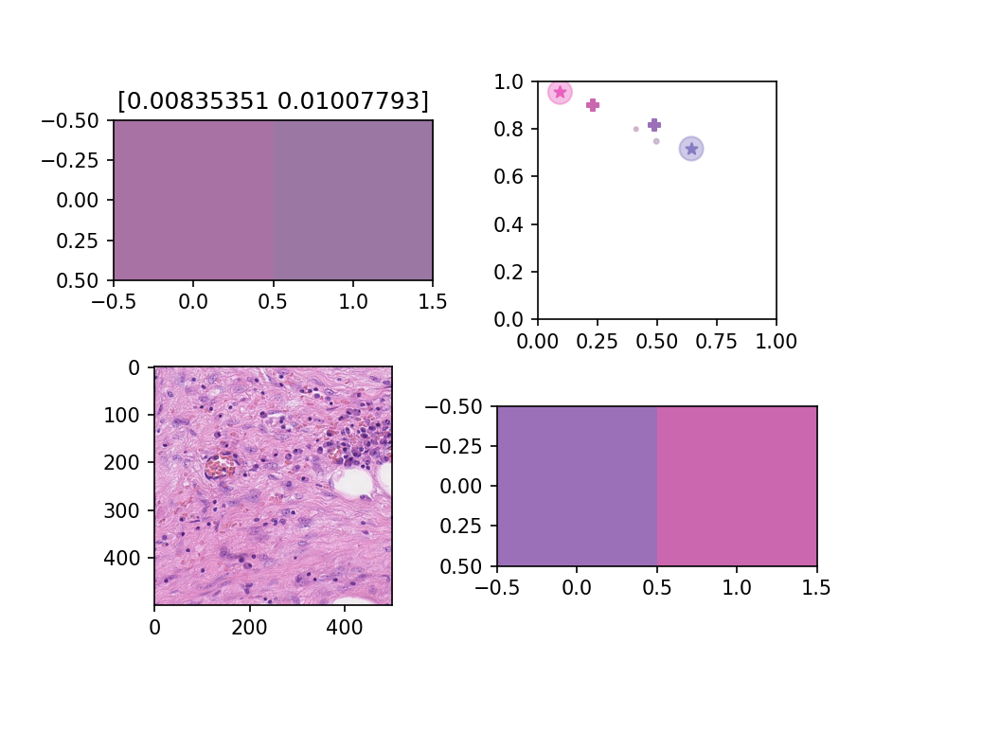

<IPython.core.display.Javascript object>


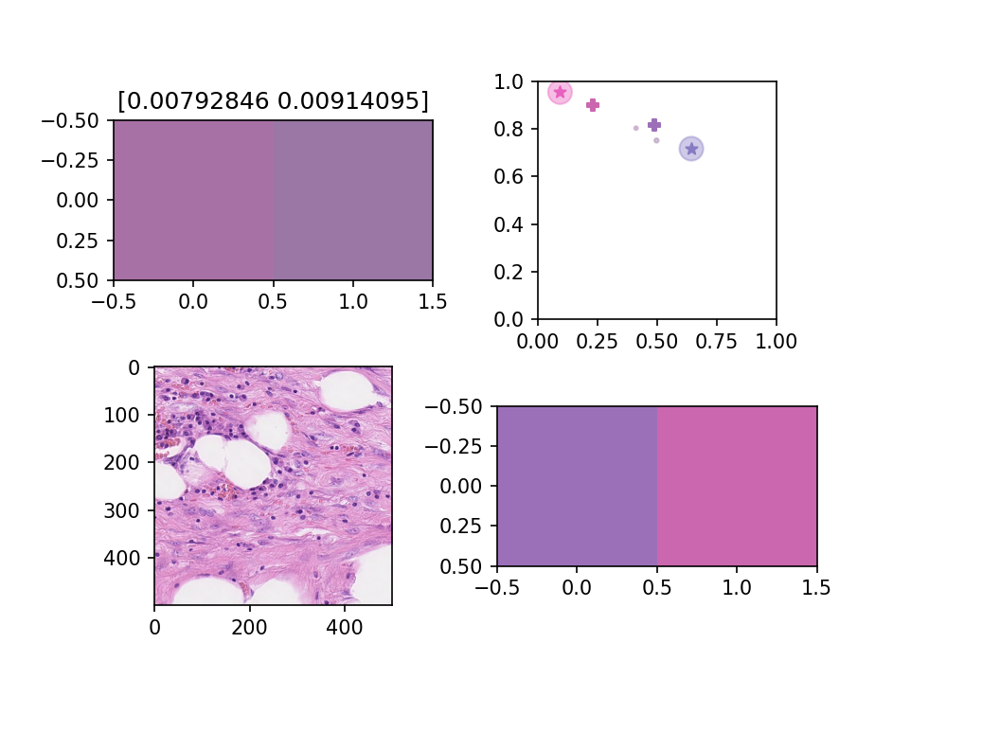

<IPython.core.display.Javascript object>


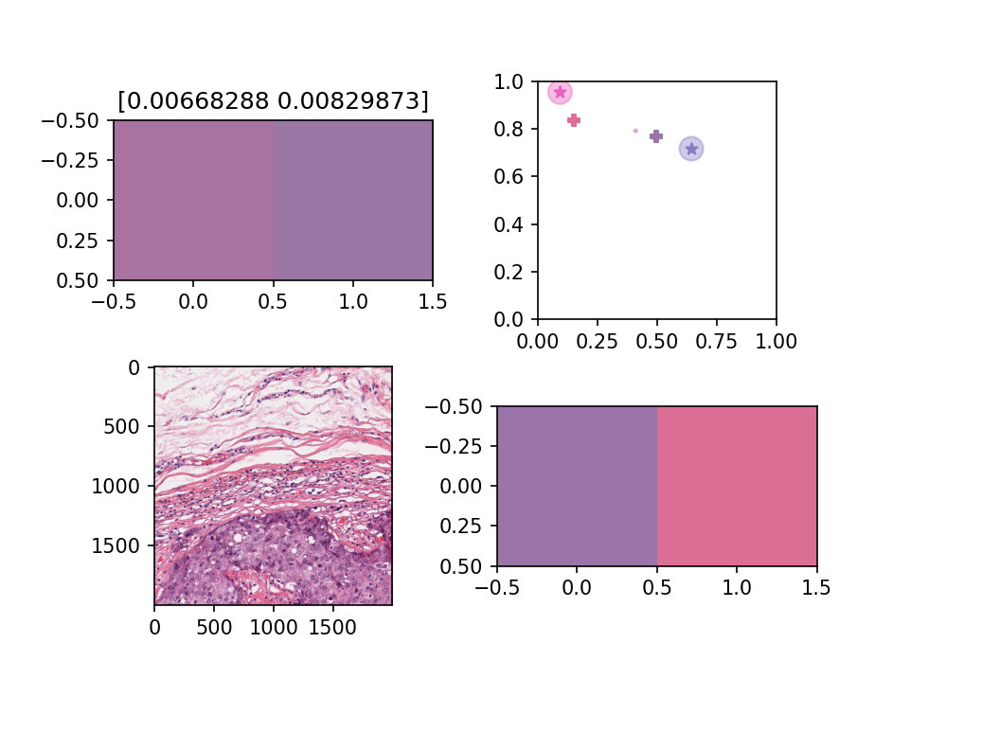

<IPython.core.display.Javascript object>


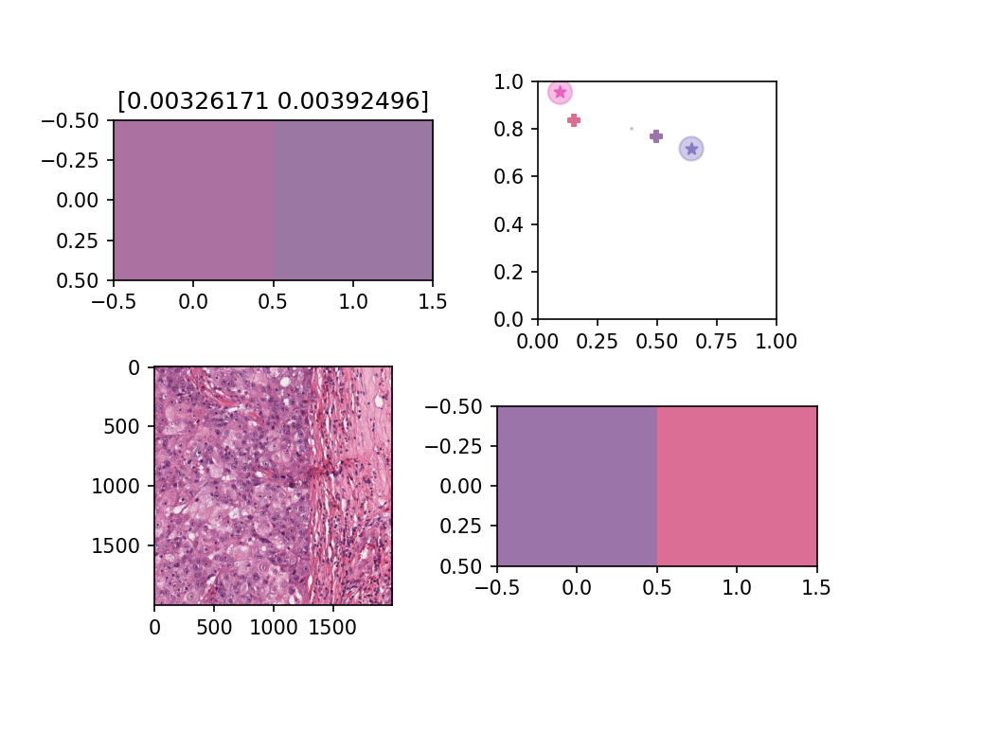

<IPython.core.display.Javascript object>


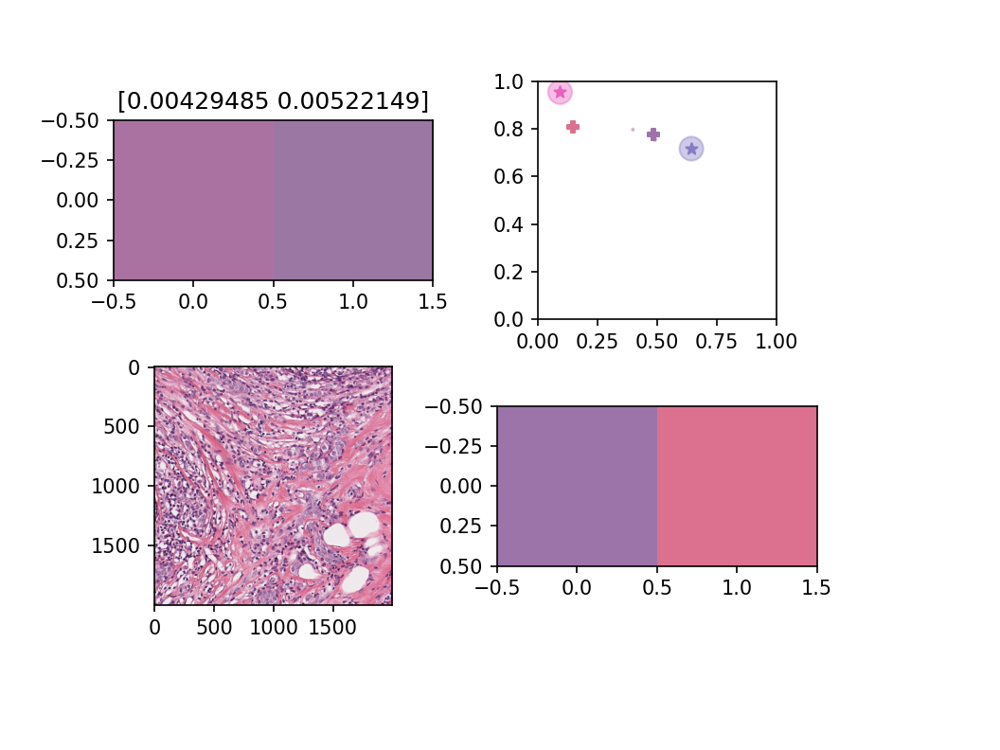

<IPython.core.display.Javascript object>


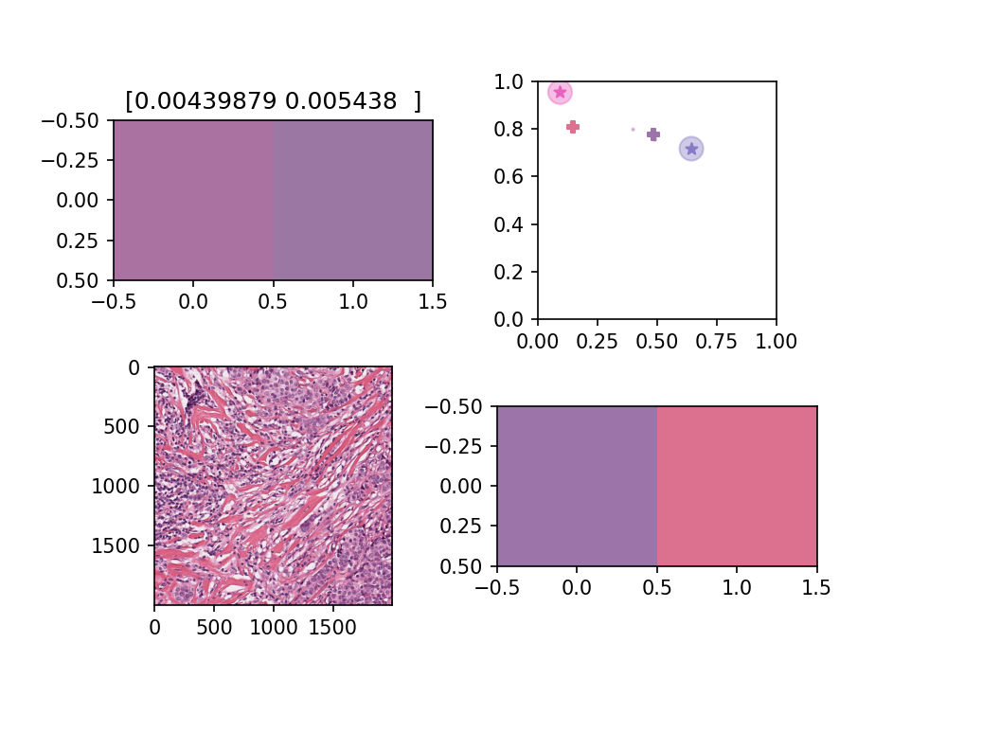

<IPython.core.display.Javascript object>


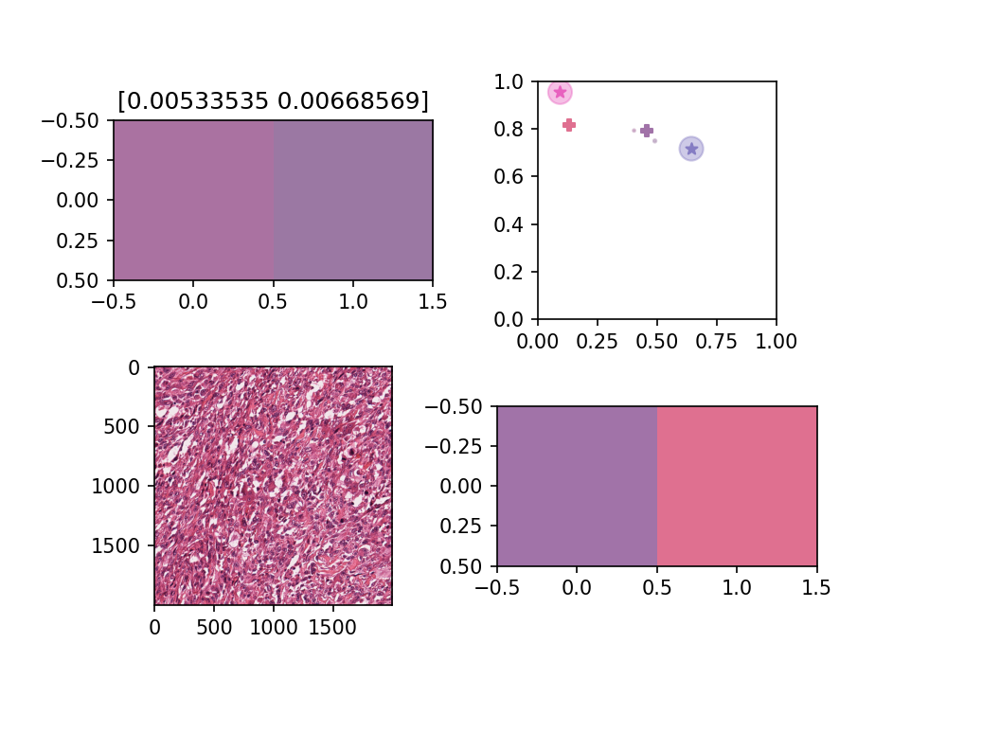

<IPython.core.display.Javascript object>


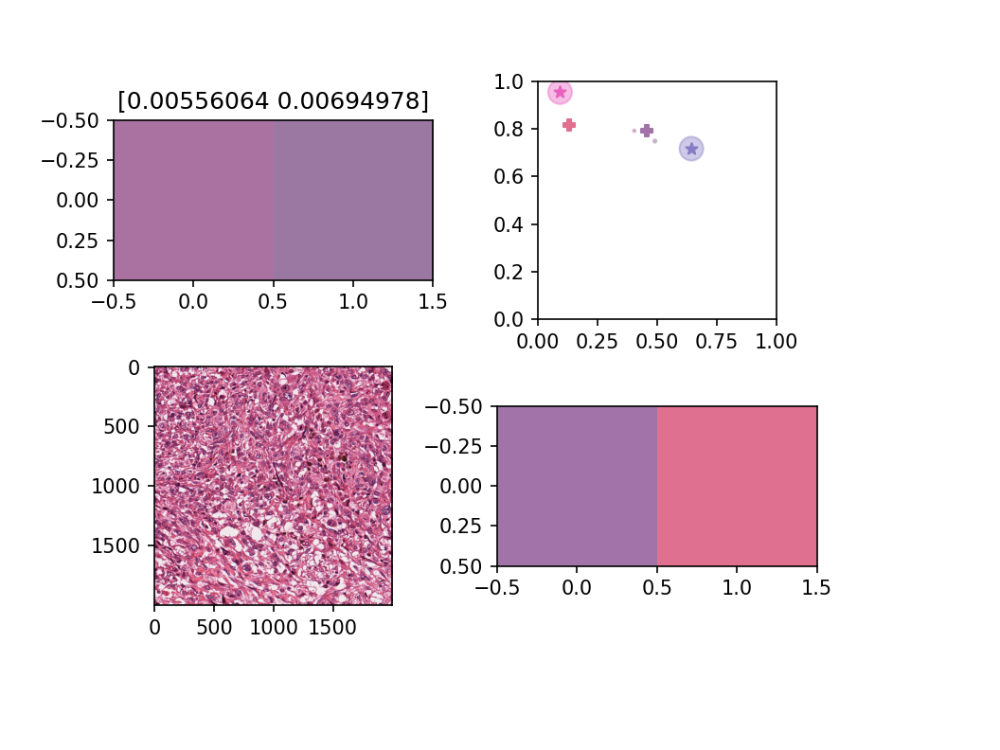

In [139]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_7/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2
for patch_file in image_patches[0:]:
    fig,ax= plt.subplots(2,2)
#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    
    
    h_circle=plt.Circle(M[0:2,0],sigma[0],color=od2rgb(M[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M[0:2,1],sigma[1],color=od2rgb(M[:,1])/255,alpha=0.4)

    
    
    patch = plt.imread(patch_file)
    
    GT_file=patch_file.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    patch_id=GT_file.rsplit('/',2)[1]
    M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
    Mdisp_GT=M_GT.T.reshape(1,ns,3)
    Mdisp_GT=od2rgb(Mdisp_GT).astype('int')
    
    
    
    #Showing eveerything
    ax[0,0].imshow(Mdisp)
    ax[0,0].set_title(sigma)
    
    ax[0,1].set_aspect(1)
    ax[0,1].add_artist(h_circle)
    ax[0,1].add_artist(e_circle)
    
    #Draw prior
    h_circle=plt.Circle(M_Ruifrok[0:2,0],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M_Ruifrok[0:2,1],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
    ax[0,1].add_artist(h_circle)
    ax[0,1].add_artist(e_circle)
    ax[0,1].scatter(M_Ruifrok[0,0],M_Ruifrok[1,0],marker='*',color=od2rgb(M_Ruifrok[:,0])/255)
    ax[0,1].scatter(M_Ruifrok[0,1],M_Ruifrok[1,1],marker='*',color=od2rgb(M_Ruifrok[:,1])/255)

    
    #Draw gt
    ax[0,1].scatter(M_GT[0,0],M_GT[1,0],marker='P',color=od2rgb(M_GT[:,0])/255)
    ax[0,1].scatter(M_GT[0,1],M_GT[1,1],marker='P',color=od2rgb(M_GT[:,1])/255)
    ax[0,1].set_xlim(0,1)
    ax[0,1].set_ylim(0,1)

    ax[1,0].imshow(patch)
    ax[1,1].imshow(Mdisp_GT)
    
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

In [1]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9pre/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2
fig,ax= plt.subplots()
ax.set_aspect(1)

ax.set_ylabel('OD channel 2 - inv green')
ax.set_xlabel('OD channel 1 - inverse red')

h_circle=plt.Circle(M_Ruifrok[0:2,0],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
e_circle=plt.Circle(M_Ruifrok[0:2,1],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
ax.add_artist(h_circle)
ax.add_artist(e_circle)
ax.scatter(M_Ruifrok[0,0],M_Ruifrok[1,0],marker='*',color=od2rgb(M_Ruifrok[:,0])/255)
ax.scatter(M_Ruifrok[0,1],M_Ruifrok[1,1],marker='*',color=od2rgb(M_Ruifrok[:,1])/255)
ax.set_xlim(0,0.8)
ax.set_ylim(0.6,1)
for patch_file in image_patches[0:]:

#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    
#     print(sigma)
    h_circle=plt.Circle(M[0:2,0],sigma[0],color=od2rgb(M[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M[0:2,1],sigma[1],color=od2rgb(M[:,1])/255,alpha=0.4)
#     h_circle=plt.Circle(M[0:2,0],0.01,color=od2rgb(M[:,0])/255,alpha=0.4)
#     e_circle=plt.Circle(M[0:2,1],0.01,color=od2rgb(M[:,1])/255,alpha=0.4)

    ax.add_artist(h_circle)
    ax.add_artist(e_circle)
    
    GT_file=patch_file.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    patch_id=GT_file.rsplit('/',2)[1]
    M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
    Mdisp_GT=M_GT.T.reshape(1,ns,3)
    Mdisp_GT=od2rgb(Mdisp_GT).astype('int')
    ax.scatter(M_GT[0,0],M_GT[1,0],marker='$H$',color=od2rgb(M_GT[:,0])/255)
    ax.scatter(M_GT[0,1],M_GT[1,1],marker='$E$',color=od2rgb(M_GT[:,1])/255)

r1=plt.Circle((0,0),1, fill=False)
ax.add_patch(r1)
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

NameError: name 'glob' is not defined

In [45]:
M_Ruifrok

array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

In [4]:
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'

M_GT_list=glob.glob(GT_dir+'/*/*/SV.mat')
Data=np.zeros([3,2*(len(M_GT_list)+1)])
for f,file in enumerate(M_GT_list):
    M_GT=loadmat(file)['Stains']
    Data[:,2*f]=M_GT[:,0]
    Data[:,2*f+1]=M_GT[:,1]

Data[:,-2]=M_Ruifrok[:,0]
Data[:,-1]=M_Ruifrok[:,1]
Data.T.shape

(26, 3)

<IPython.core.display.Javascript object>


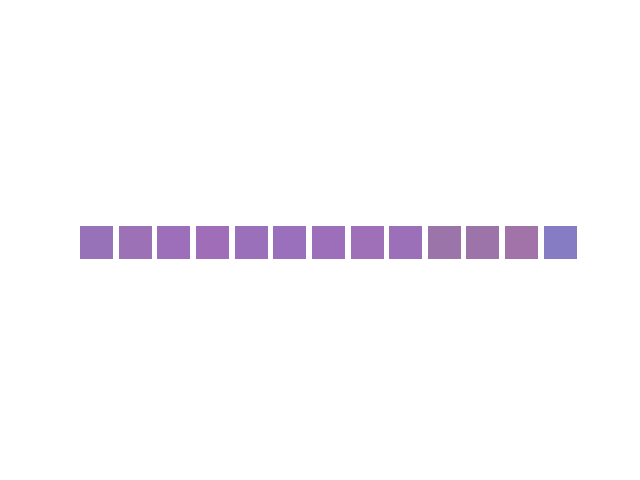

<IPython.core.display.Javascript object>


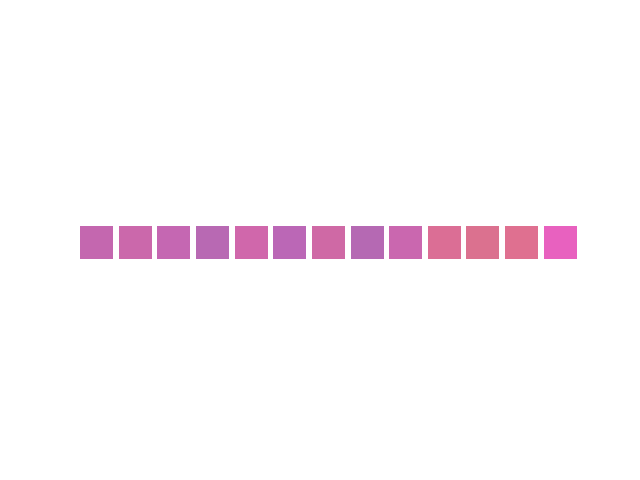

In [5]:
H=Data[:,0::2],
H=H[0]
E=Data[:,1::2],
E=E[0]

plt.figure()
for i in range(13):
    plt.subplot(1,13,i+1)
    display_M(H[:,i].reshape(3,1))
    plt.axis('off')
plt.figure()
for i in range(13):
    plt.subplot(1,13,i+1)
    display_M(E[:,i].reshape(3,1))
    plt.axis('off')

In [12]:
print(np.var(H,axis=1))
print(np.var(E,axis=1))

var_h=np.var(H,axis=1).reshape([1,3])
var_e=np.var(E,axis=1).reshape([1,3])

var_h.shape

[0.00207062 0.00089362 0.00191125]
[0.00531119 0.00139286 0.0075986 ]


(1, 3)

In [24]:
mse_wssb=np.array([[0.0174, 0.0175, 0.0172, 0.0177, 0.0176, 0.0177],
[0.0093, 0.0093, 0.0092, 0.0092, 0.0092, 0.0092],
[0.0067, 0.0067, 0.0066, 0.0066, 0.0065, 0.0072]])
np.set_printoptions(precision=4)
print(np.mean(mse_wssb,axis=0))


[0.0111 0.0112 0.011  0.0112 0.0111 0.0114]


<IPython.core.display.Javascript object>


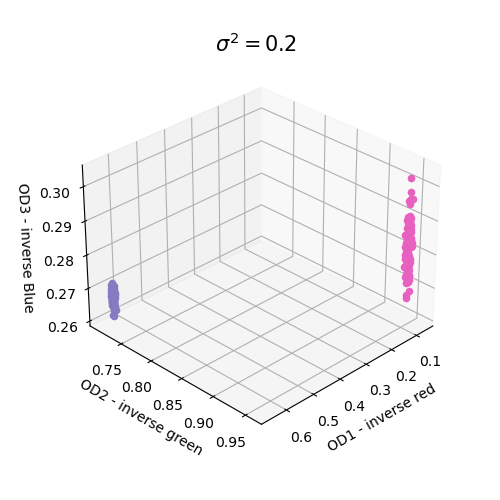

In [15]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
v1_list=[2e-1]

n_col=len(v1_list)
n_row=1
n_samples=100
# plt.figure(figsize=(10,10))
fig = plt.figure(figsize=(5, 5))
# ax = fig.add_subplot()
ax = fig.add_subplot(projection='3d')
ax.set_xlabel('OD1 - inverse red')
ax.set_ylabel('OD2 - inverse green')

# ax.set_xlim(-0.3,1)
# ax.set_ylim(-0.3,1)
# # 3D
ax.set_zlabel('OD3 - inverse Blue')
# ax.set_zlim(-0.3,1)

# plt.circle()

for v,v1 in enumerate(v1_list):
    eps=2*v1
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var_h).reshape([3,1]),-20,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
#         Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var_e).reshape([3,1]),-20,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
#         Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
#         ax.scatter(Mgauss[0,0],Mgauss[1,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
#         ax.scatter(Mgauss[0,1],Mgauss[1,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        
#         3D
        ax.scatter(Mgauss[0,0],Mgauss[1,0],Mgauss[2,0], color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[1,1],Mgauss[2,1], color=od2rgb(Mgauss[:,1])/255)
        
    ax.view_init(elev=30., azim=45)
#     ax.scatter(M_Ruifrok[0,0]+eps,M_Ruifrok[1,0]+eps,M_Ruifrok[2,0]+eps, marker='$H$', s=100, color='k')   # , facecolors='none', edgecolors='k'
#     ax.scatter(M_Ruifrok[0,1]+eps,M_Ruifrok[1,1]+eps,M_Ruifrok[2,1]+eps, marker='$E$', s=100, color='k')   # , facecolors='none', edgecolors='k'
        
    ax.set_title(r'$\sigma^2=$'+str(v1),fontsize=15)
#     fig.savefig('Prior_M_sig_' +str(v1)+ '.pdf', bbox_inches='tight')


In [8]:
var

array([[0.2, 0.2, 0.2]])

In [8]:
from sklearn.decomposition import PCA

pca= PCA(n_components=2)
Data_pca=pca.fit_transform(Data.T)

Data_pca.shape

(26, 2)

<IPython.core.display.Javascript object>


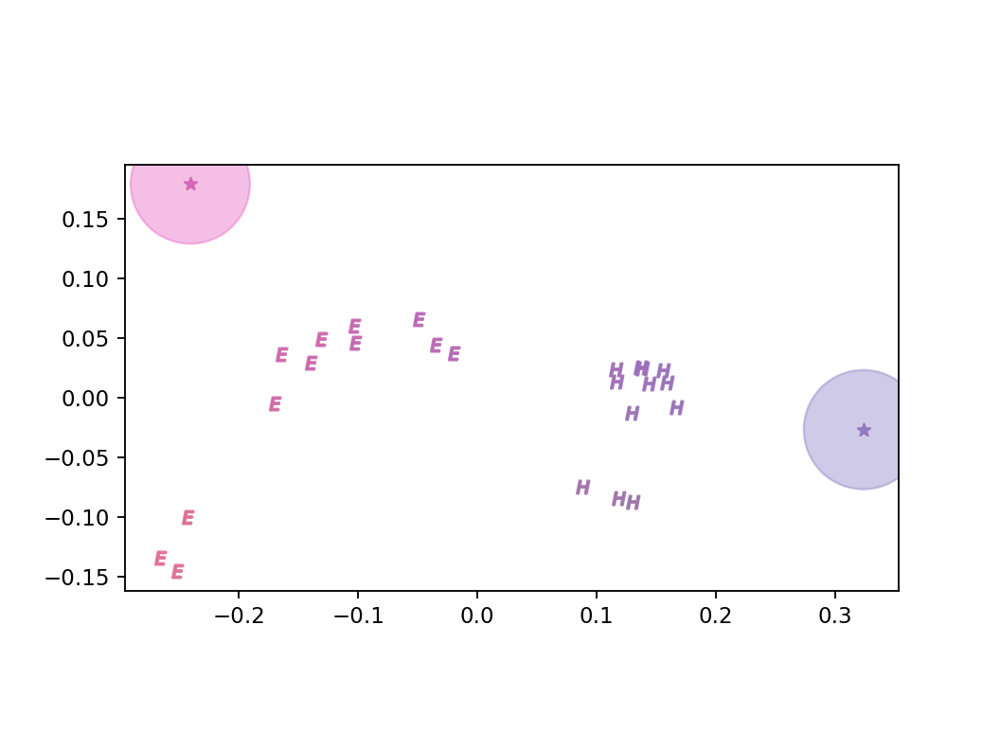

In [9]:
fig,ax= plt.subplots()
for i,M in enumerate(Data_pca[:-2,:]):
#     print(M[0],M[1])
    if i%2==0:
        ax.scatter(M[0],M[1],marker='$H$',color=od2rgb(Data[:,i])/255,alpha=0.9)
    else:
        ax.scatter(M[0],M[1],marker='$E$',color=od2rgb(Data[:,i])/255,alpha=0.9)
        
for i,M in enumerate(Data_pca[-2:,:]):
#     print(M[0],M[1])
    if i%2==0:
        ax.scatter(M[0],M[1],marker='*',color=od2rgb(Data[:,i])/255,alpha=0.9)
    else:
        ax.scatter(M[0],M[1],marker='*',color=od2rgb(Data[:,i])/255,alpha=0.9)
                
h_circle=plt.Circle(Data_pca[-2,:],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
e_circle=plt.Circle(Data_pca[-1,:],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
ax.add_artist(h_circle)
ax.add_artist(e_circle)
ax.set_aspect(1)

plt.show()

In [31]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2

DataMnet=np.zeros([3,2*(len(image_patches))])
DataSignet=np.zeros(2*len(image_patches))

for f,patch_file in enumerate(image_patches[0:]):

#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)

    DataMnet[:,2*f]=M[:,0]
    DataMnet[:,2*f+1]=M[:,1]
    DataSignet[2*f]=sigma[0]
    DataSignet[2*f+1]=sigma[1]
    

In [30]:
DataMnet_pca=pca.transform(DataMnet.T)

<IPython.core.display.Javascript object>


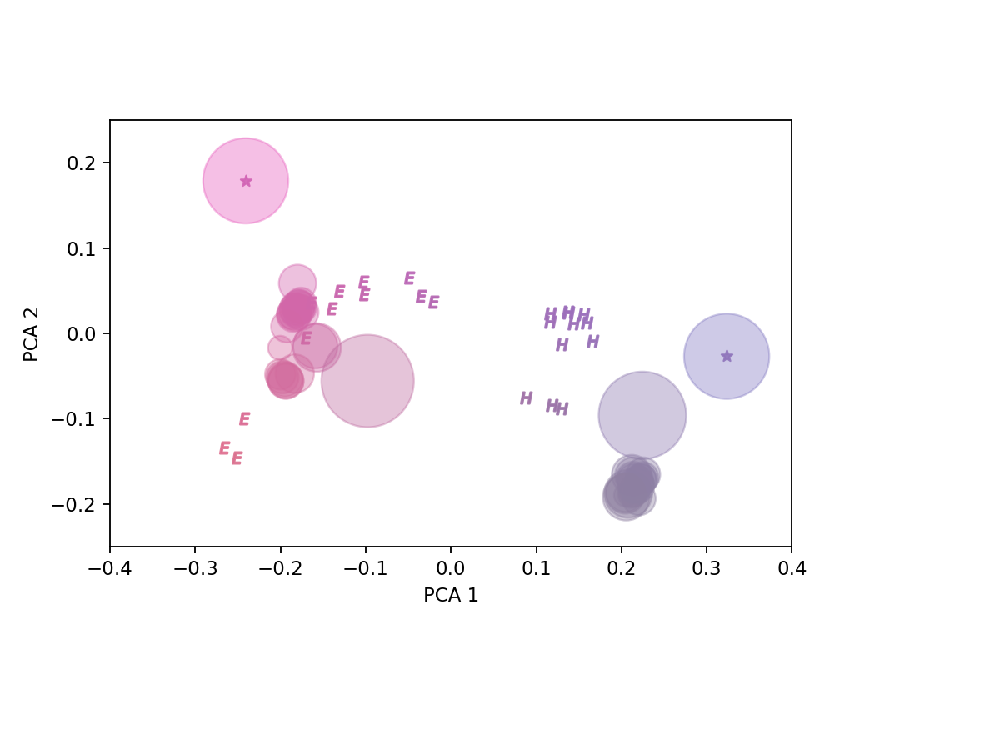

In [39]:
fig,ax= plt.subplots()

for i,M in enumerate(DataMnet_pca):
#     print(M[0],M[1])
    circle=plt.Circle(M,DataSignet[i],color=od2rgb(DataMnet[:,i])/255,alpha=0.4)
    ax.add_artist(circle)
        

for i,M in enumerate(Data_pca[:-2,:]):
#     print(M[0],M[1])
    if i%2==0:
        ax.scatter(M[0],M[1],marker='$H$',color=od2rgb(Data[:,i])/255,alpha=0.9)
    else:
        ax.scatter(M[0],M[1],marker='$E$',color=od2rgb(Data[:,i])/255,alpha=0.9)
        
for i,M in enumerate(Data_pca[-2:,:]):
#     print(M[0],M[1])
    if i%2==0:
        ax.scatter(M[0],M[1],marker='*',color=od2rgb(Data[:,i])/255,alpha=0.9)
    else:
        ax.scatter(M[0],M[1],marker='*',color=od2rgb(Data[:,i])/255,alpha=0.9)
                
h_circle=plt.Circle(Data_pca[-2,:],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
e_circle=plt.Circle(Data_pca[-1,:],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
ax.add_artist(h_circle)
ax.add_artist(e_circle)
ax.set_aspect(1)

ax.set_xlim(-0.4,0.4)
ax.set_ylim(-0.25,0.25)

ax.set_xlabel('PCA 1')
ax.set_ylabel('PCA 2')

plt.show()

In [66]:
import scipy.linalg

In [67]:
def Mcar2pol(M):
    #M is supposed to have norm 1 and positive values only M[3,ns=2]
    Mpol=np.zeros([2,2])
    #H
    h_t=np.arctan(np.linalg.norm(M[:2,0]))
    h_p=np.arctan(M[1,0]/M[0,0])
    #E
    e_t=np.arctan(np.linalg.norm(M[:2,1]))
    e_p=np.arctan(M[1,1]/M[0,1])
    
    Mpol[0,0]=h_t
    Mpol[1,0]=h_p
    Mpol[0,1]=e_t
    Mpol[1,1]=e_p
    return Mpol

<IPython.core.display.Javascript object>


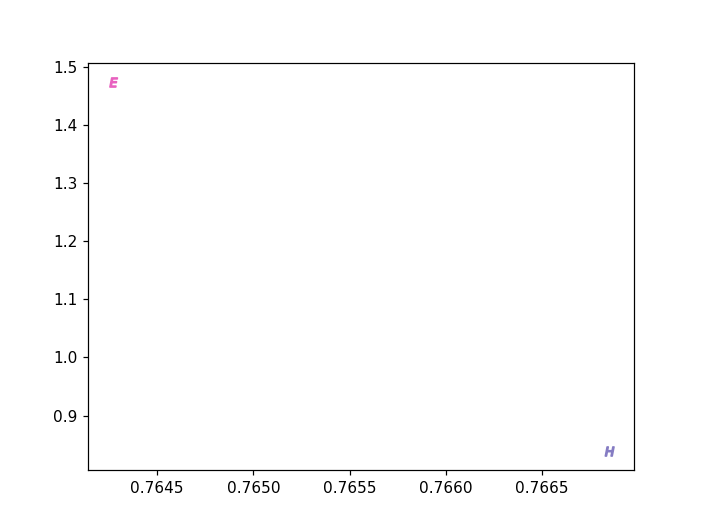

In [68]:
plt.figure()
Mpol_Rui=Mcar2pol(M_Ruifrok)
plt.scatter(Mpol_Rui[0,0],Mpol_Rui[1,0],marker='$H$',color=od2rgb(M_Ruifrok[:,0])/255)
plt.scatter(Mpol_Rui[0,1],Mpol_Rui[1,1],marker='$E$',color=od2rgb(M_Ruifrok[:,1])/255)
plt.show()

<IPython.core.display.Javascript object>


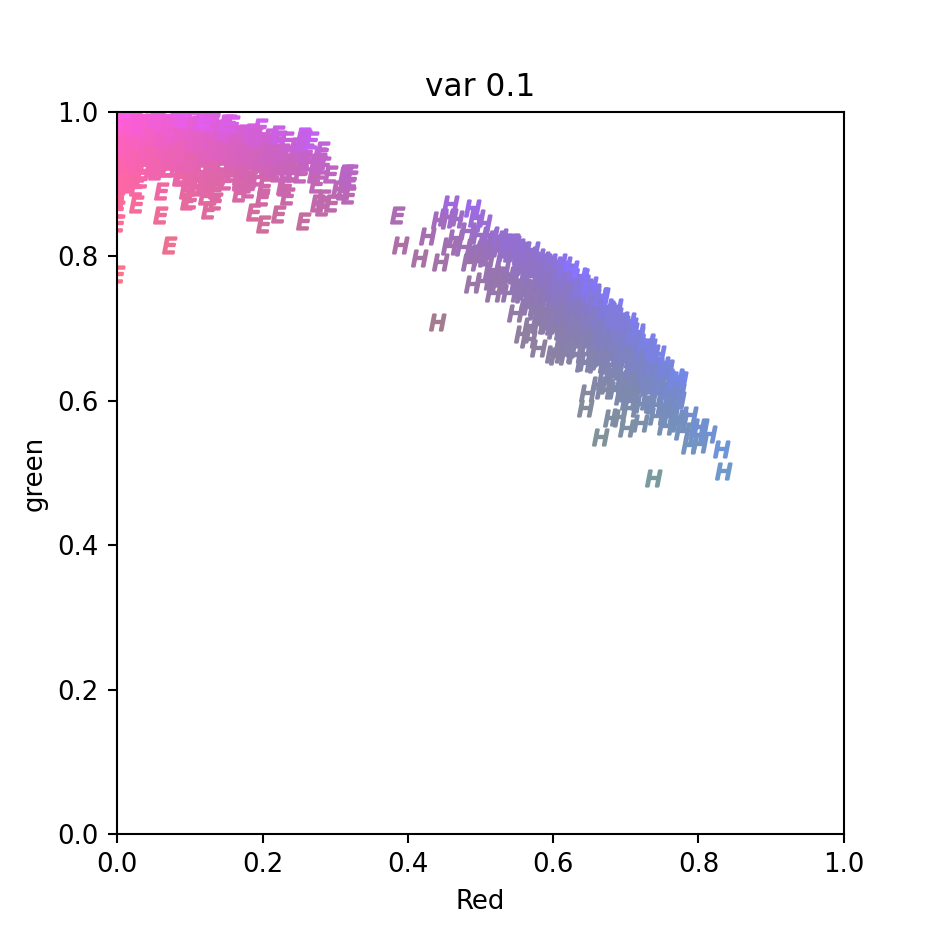

<IPython.core.display.Javascript object>


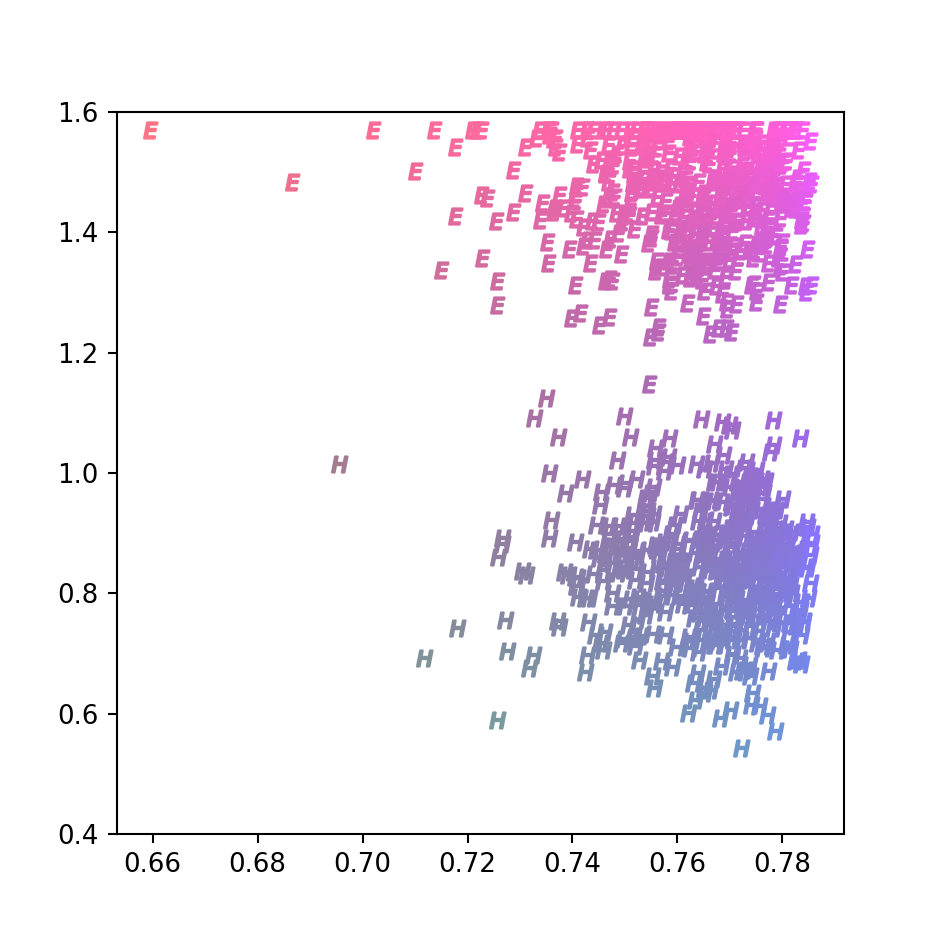

In [39]:
M_Ruifrok=np.array([[0.644211  , 0.092789  , 0.63598099],
       [0.716556  , 0.954111  , 0.        ],
       [0.266844  , 0.283111  , 0.77170472]])

#For the moment we will use only two of them (The first two correspond to H and E)
M_Ruifrok=M_Ruifrok[:,:2]
# For the gaussian distribution we have two options.
# The first one is to set M_Ruifrok as the mean, and sample from there
v1_list=[1e-3, 1e-2,5e-2, 1e-1, 5e-1,1e0]
v1_list=[1e-1]
n_col=len(v1_list)
n_row=1
n_samples=500
# plt.figure(figsize=(10,10))
fig = plt.figure(figsize=(5, 5))
ax = fig.add_subplot()
# ax = fig.add_subplot(projection='3d')
ax.set_xlabel('Red')
ax.set_ylabel('green')

ax.set_xlim(0,1)
ax.set_ylim(0,1)

fig2 = plt.figure(figsize=(5, 5))
ax2 = fig2.add_subplot()

# ax2.set_xlim(0.6,1)
ax2.set_ylim(0.4,1.6)

# 3D
# ax.set_zlabel('Blue')
# ax.set_zlim(0,1)
for v,v1 in enumerate(v1_list):
    var=v1*np.ones([1,3])
#     var[0,2]=0
    for i in range(n_samples):

        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),1e-6,None)      
#         Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)
        Hgauss=Hgauss/np.linalg.norm(Hgauss)
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),1e-6,None)
#         Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
        Egauss=Egauss/np.linalg.norm(Egauss)

        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
#         plt.subplot(n_row,n_col,index)
#         plt.figure()
        ax.scatter(Mgauss[0,0],Mgauss[1,0], marker='$H$', color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[1,1], marker='$E$', color=od2rgb(Mgauss[:,1])/255)
        ax.set_title('var '+str(v1))

        Mpol_GT=Mcar2pol(Mgauss)
        ax2.scatter(Mpol_GT[0,0],Mpol_GT[1,0],marker='$H$',color=od2rgb(Mgauss[:,0])/255)
        ax2.scatter(Mpol_GT[0,1],Mpol_GT[1,1],marker='$E$',color=od2rgb(Mgauss[:,1])/255)

<IPython.core.display.Javascript object>


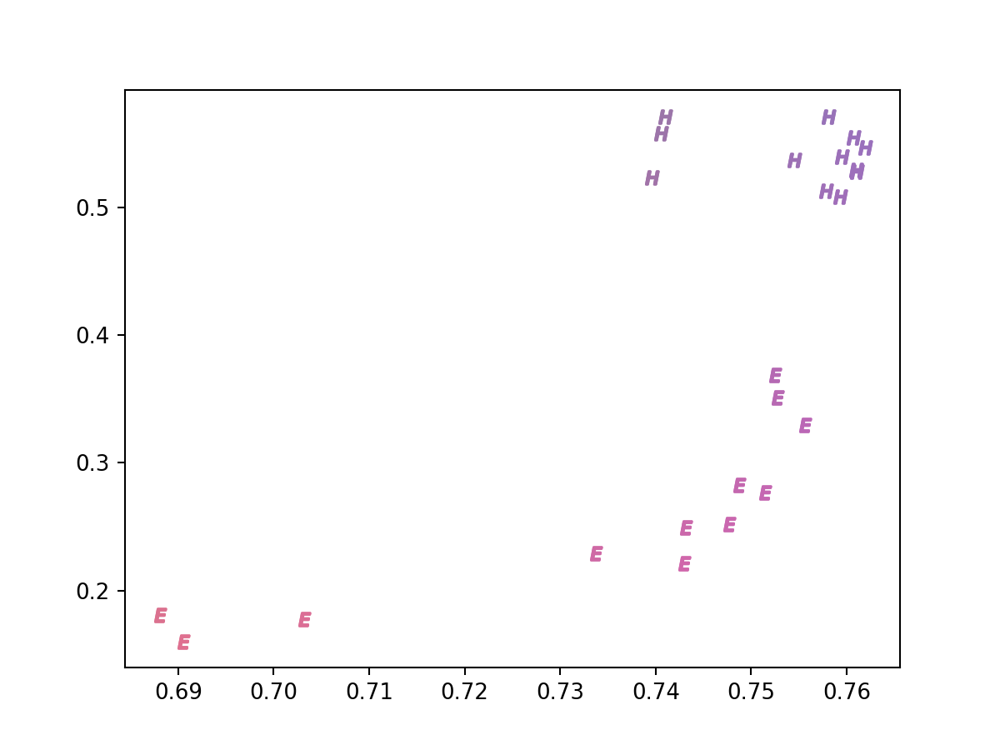

In [23]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2
fig,ax= plt.subplots()
# ax.set_aspect(1)

for patch_file in image_patches[0:]:

    
    GT_file=patch_file.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    patch_id=GT_file.rsplit('/',2)[1]
    M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
#     Mdisp_GT=M_GT.T.reshape(1,ns,3)
#     Mdisp_GT=od2rgb(Mdisp_GT).astype('int')
#     ax.scatter(M_GT[0,0],M_GT[1,0],marker='$H$',color=od2rgb(M_GT[:,0])/255)
#     ax.scatter(M_GT[0,1],M_GT[1,1],marker='$E$',color=od2rgb(M_GT[:,1])/255)
    
    Mpol_GT=Mcar2pol(M_GT)
    ax.scatter(Mpol_GT[0,0],Mpol_GT[1,0],marker='$H$',color=od2rgb(M_GT[:,0])/255)
    ax.scatter(Mpol_GT[0,1],Mpol_GT[1,1],marker='$E$',color=od2rgb(M_GT[:,1])/255)

    
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

# With pre-training

<IPython.core.display.Javascript object>


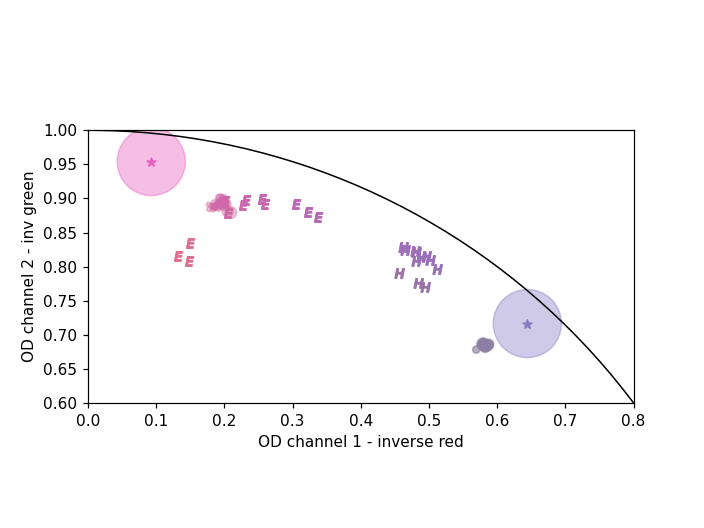

In [19]:
#Iterate through WSSB dataset
#Compare M_GT with M_net

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_7_pre/'
#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
ns=2
fig,ax= plt.subplots()
ax.set_aspect(1)

ax.set_ylabel('OD channel 2 - inv green')
ax.set_xlabel('OD channel 1 - inverse red')

h_circle=plt.Circle(M_Ruifrok[0:2,0],0.05,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
e_circle=plt.Circle(M_Ruifrok[0:2,1],0.05,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
ax.add_artist(h_circle)
ax.add_artist(e_circle)
ax.scatter(M_Ruifrok[0,0],M_Ruifrok[1,0],marker='*',color=od2rgb(M_Ruifrok[:,0])/255)
ax.scatter(M_Ruifrok[0,1],M_Ruifrok[1,1],marker='*',color=od2rgb(M_Ruifrok[:,1])/255)
ax.set_xlim(0,0.8)
ax.set_ylim(0.6,1)

data= np.zeros([len(image_patches),4])
i=0

for patch_file in image_patches[0:]:

#     patch = plt.imread(image_patches[0])

    #Read result
    R_path=patch_file.replace(RGB_dir,Result_dir)
    R_path=R_path.rsplit('/',1)[0]
    M, sigma = read_ysw(R_path)
    Mdisp=M.T.reshape(1,ns,3)
    Mdisp=od2rgb(Mdisp).astype('int')
    
#     print(sigma)
    h_circle=plt.Circle(M[0:2,0],sigma[0],color=od2rgb(M[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M[0:2,1],sigma[1],color=od2rgb(M[:,1])/255,alpha=0.4)
#     h_circle=plt.Circle(M[0:2,0],0.01,color=od2rgb(M[:,0])/255,alpha=0.4)
#     e_circle=plt.Circle(M[0:2,1],0.01,color=od2rgb(M[:,1])/255,alpha=0.4)

    ax.add_artist(h_circle)
    ax.add_artist(e_circle)
    
    GT_file=patch_file.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    patch_id=GT_file.rsplit('/',2)[1]
    M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
    Mdisp_GT=M_GT.T.reshape(1,ns,3)
    Mdisp_GT=od2rgb(Mdisp_GT).astype('int')
    ax.scatter(M_GT[0,0],M_GT[1,0],marker='$H$',color=od2rgb(M_GT[:,0])/255)
    ax.scatter(M_GT[0,1],M_GT[1,1],marker='$E$',color=od2rgb(M_GT[:,1])/255)
    
    data[i,0:2]=np.linalg.norm(M-M_GT,axis=0)
    data[i,2:]=np.linalg.norm(M-M_Ruifrok[:,0:2],axis=0)
    
    i+=1

r1=plt.Circle((0,0),1, fill=False)
ax.add_patch(r1)
# patch = plt.imread(image_patches[0])
# plt.figure(figsize=(10,8))
# plt.imshow(patch)
# print(patch.shape)
# plt.figure()
# M_GT=loadmat(glob.glob(GT_dir+tissue+'/'+image+'/*SV.mat')[0])['Stains']
# display_M(M_GT)

In [21]:
np.mean(data,axis=0)

array([0.18865241, 0.09790733, 0.18668232, 0.17470801])

In [11]:
print(np.linalg.norm(M-M_GT))
print(np.linalg.norm(M-M_GT,axis=0))
print(np.linalg.norm(M[:,0]-M_GT[:,0]),np.linalg.norm(M[:,1]-M_GT[:,1]))




0.2379130699972698
[0.16831611 0.16814374]
0.1683161063359364 0.1681437397687929


In [93]:
#Iterate through WSSB dataset
#Compare M_GT with M_net
def plotResults(Result_dir):
    RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
    GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
#     Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_7_pre/'
    #Cada iamgen tiene varios parches
    image_patches=glob.glob(RGB_dir+'/*/*/*/*')
    ns=2
    fig,ax= plt.subplots()
    ax.set_aspect(1)

    ax.set_ylabel('OD channel 2 - inv green', fontsize=15)
    ax.set_xlabel('OD channel 1 - inverse red', fontsize=15)
    
    var=0.05
    h_circle=plt.Circle(M_Ruifrok[0:2,0],2*var,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(M_Ruifrok[0:2,1],2*var,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
    ax.add_artist(h_circle)
    ax.add_artist(e_circle)
    ax.scatter(M_Ruifrok[0,0],M_Ruifrok[1,0],marker='*',s=80, color=od2rgb(M_Ruifrok[:,0])/255)
    ax.scatter(M_Ruifrok[0,1],M_Ruifrok[1,1],marker='*',s=80, color=od2rgb(M_Ruifrok[:,1])/255)
    
    n_samples=0
    for i in range(n_samples):
        #pintar distribución sin restricciones
        Hgauss=np.clip(np.random.normal(loc=M_Ruifrok[:,0], scale=var).reshape([3,1]),-20,None)      
        Egauss=np.clip(np.random.normal(loc=M_Ruifrok[:,1], scale=var).reshape([3,1]),-20,None)
        Mgauss=np.concatenate((Hgauss,Egauss),axis=1)
        
        ax.scatter(Mgauss[0,0],Mgauss[1,0], color=od2rgb(Mgauss[:,0])/255)    
        ax.scatter(Mgauss[0,1],Mgauss[1,1], color=od2rgb(Mgauss[:,1])/255)
    
    
    
    
    
    
    
#     ax.set_xlim(0,0.8)
#     ax.set_ylim(0.6,1)
    ax.set_xlim(0,0.8)
    ax.set_ylim(0.4,1)
    for patch_file in image_patches[0:]:

    #     patch = plt.imread(image_patches[0])

        #Read result
        R_path=patch_file.replace(RGB_dir,Result_dir)
        R_path=R_path.rsplit('/',1)[0]
        M, sigma = read_ysw(R_path)
        Mdisp=M.T.reshape(1,ns,3)
        Mdisp=od2rgb(Mdisp).astype('int')

#         print(sigma)
        if 2*sigma[0]>0.005:
            h_circle=plt.Circle(M[0:2,0],2*sigma[0],color=od2rgb(M[:,0])/255,alpha=0.4)
            ax.add_artist(h_circle)
        else:
            ax.scatter(M[0,0],M[1,0],marker='+',color=od2rgb(M[:,0])/255,alpha=0.8)
        if 2*sigma[1]>0.005:      
            e_circle=plt.Circle(M[0:2,1],2*sigma[1],color=od2rgb(M[:,1])/255,alpha=0.4)
            ax.add_artist(e_circle)
        else:
            ax.scatter(M[0,1],M[1,1],marker='x',color=od2rgb(M[:,1])/255,alpha=0.8)
    #     h_circle=plt.Circle(M[0:2,0],0.01,color=od2rgb(M[:,0])/255,alpha=0.4)
    #     e_circle=plt.Circle(M[0:2,1],0.01,color=od2rgb(M[:,1])/255,alpha=0.4)




        GT_file=patch_file.replace(RGB_dir,GT_dir)
        GT_file=GT_file.rsplit('/',2)[0]
        patch_id=GT_file.rsplit('/',2)[1]
        M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
        Mdisp_GT=M_GT.T.reshape(1,ns,3)
        Mdisp_GT=od2rgb(Mdisp_GT).astype('int')
        ax.scatter(M_GT[0,0],M_GT[1,0],marker='$H$',color=od2rgb(M_GT[:,0])/255,alpha=0.8)
        ax.scatter(M_GT[0,1],M_GT[1,1],marker='$E$',color=od2rgb(M_GT[:,1])/255,alpha=0.8)

    r1=plt.Circle((0,0),1, fill=False)
#     ax.add_patch(r1)
    ax.tick_params(axis='both', which='major', labelsize=15)
    ax.set_title(Result_dir.rsplit('/')[-2])

<IPython.core.display.Javascript object>


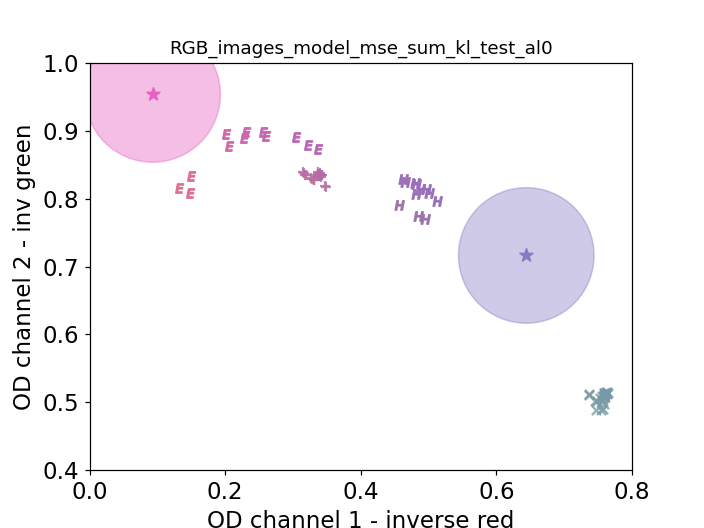

<IPython.core.display.Javascript object>


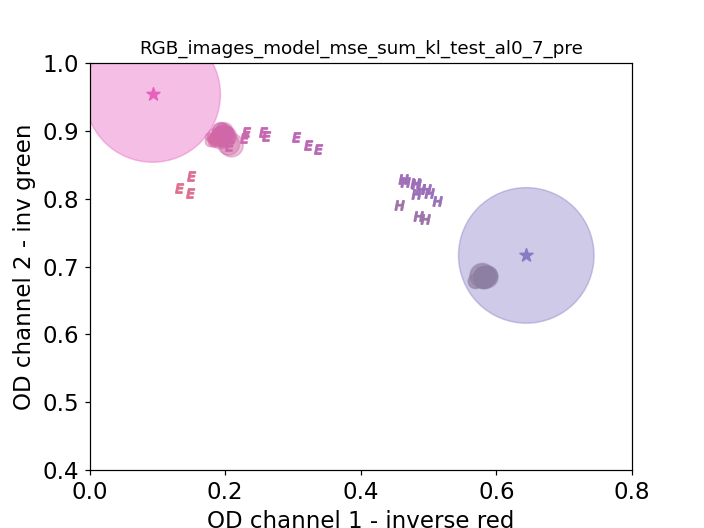

<IPython.core.display.Javascript object>


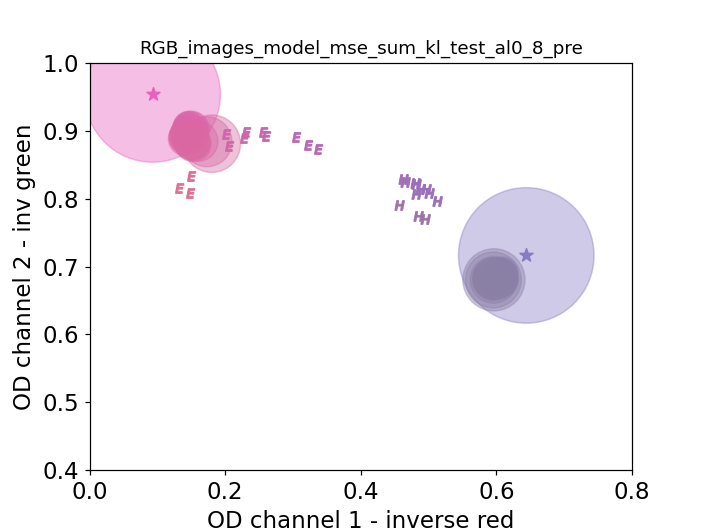

<IPython.core.display.Javascript object>


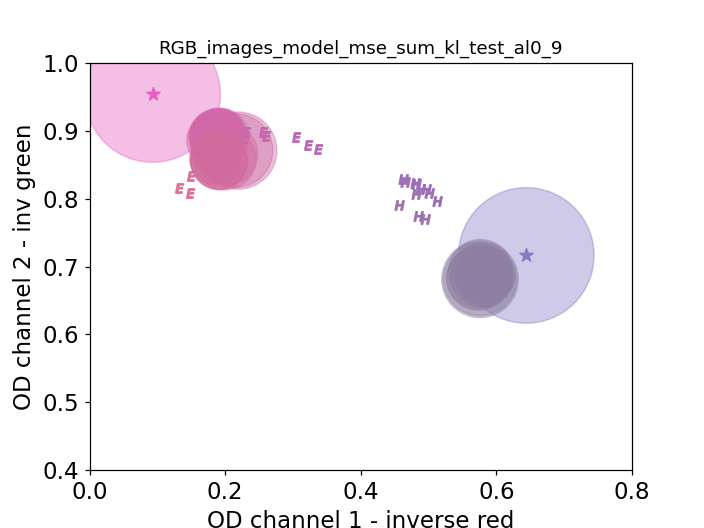

<IPython.core.display.Javascript object>


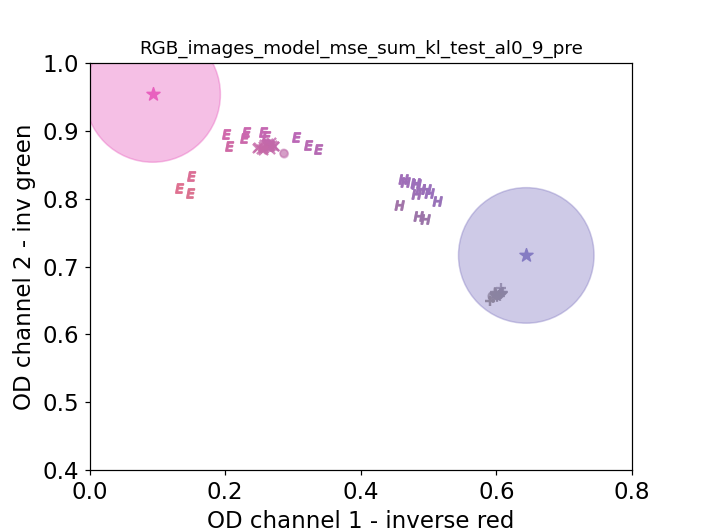

<IPython.core.display.Javascript object>


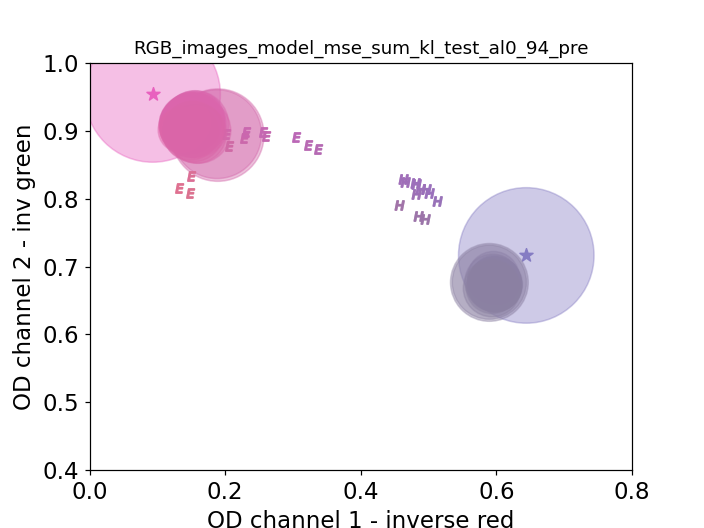

<IPython.core.display.Javascript object>


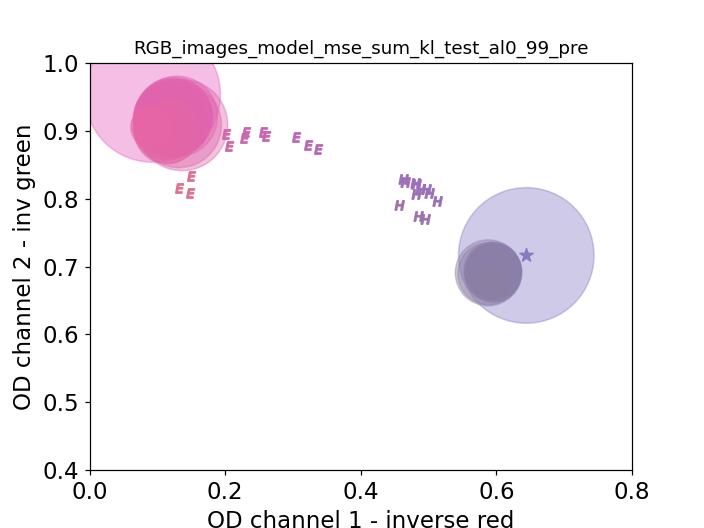

In [94]:
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0/'
plotResults(Result_dir)
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_7_pre/'
plotResults(Result_dir)
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_8_pre/'
plotResults(Result_dir)
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9/'
plotResults(Result_dir)
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_9_pre/'
plotResults(Result_dir)
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_94_pre/'
plotResults(Result_dir)
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_99_pre/'
plotResults(Result_dir)

# En esfericas

In [76]:
def Mcar2pol(M):
    #M is supposed to have norm 1 and positive values only M[3,ns=2]
    Mpol=np.zeros([2,2])
    #H
    h_t=np.arctan(np.linalg.norm(M[:2,0]))
    h_p=np.arctan(M[1,0]/M[0,0])
    #E
    e_t=np.arctan(np.linalg.norm(M[:2,1]))
    e_p=np.arctan(M[1,1]/M[0,1])
    
    Mpol[0,0]=h_t
    Mpol[1,0]=h_p
    Mpol[0,1]=e_t
    Mpol[1,1]=e_p
    return Mpol

#Iterate through WSSB dataset
#Compare M_GT with M_net
def plotResults_Pol(Result_dir):
    RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
    GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'
#     Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0_7_pre/'
    #Cada iamgen tiene varios parches
    image_patches=glob.glob(RGB_dir+'/*/*/*/*')
    ns=2
    fig,ax= plt.subplots()
#     ax.set_aspect(1)

    ax.set_ylabel('OD channel 2 - inv green', fontsize=15)
    ax.set_xlabel('OD channel 1 - inverse red', fontsize=15)
    
    Mpol_Rui=Mcar2pol(M_Ruifrok)
#     plt.scatter(Mpol_Rui[0,0],Mpol_Rui[1,0],marker='$H$',color=od2rgb(M_Ruifrok[:,0])/255)
#     plt.scatter(Mpol_Rui[0,1],Mpol_Rui[1,1],marker='$E$',color=od2rgb(M_Ruifrok[:,1])/255)
    
    var=0.05
    h_circle=plt.Circle(Mpol_Rui[0:2,0],var,color=od2rgb(M_Ruifrok[:,0])/255,alpha=0.4)
    e_circle=plt.Circle(Mpol_Rui[0:2,1],var,color=od2rgb(M_Ruifrok[:,1])/255,alpha=0.4)
    ax.add_artist(h_circle)
    ax.add_artist(e_circle)
    ax.scatter(Mpol_Rui[0,0],Mpol_Rui[1,0],marker='*',s=80, color=od2rgb(M_Ruifrok[:,0])/255)
    ax.scatter(Mpol_Rui[0,1],Mpol_Rui[1,1],marker='*',s=80, color=od2rgb(M_Ruifrok[:,1])/255)
#     ax.set_xlim(0,0.8)
#     ax.set_ylim(0.6,1)
#     ax.set_xlim(0,0.8)
#     ax.set_ylim(0.4,1)
    for patch_file in image_patches[0:]:

    #     patch = plt.imread(image_patches[0])

        #Read result
        R_path=patch_file.replace(RGB_dir,Result_dir)
        R_path=R_path.rsplit('/',1)[0]
        M, sigma = read_ysw(R_path)
#         Mdisp=M.T.reshape(1,ns,3)
#         Mdisp=od2rgb(Mdisp).astype('int')
        Mpol=Mcar2pol(M)

#         print(sigma)
        if sigma[0]>0.005:
            h_circle=plt.Circle(Mpol[0:2,0],sigma[0],color=od2rgb(M[:,0])/255,alpha=0.4)
            ax.add_artist(h_circle)
        else:
            ax.scatter(Mpol[0,0],Mpol[1,0],marker='+',color=od2rgb(M[:,0])/255,alpha=0.8)
        if sigma[1]>0.005:      
            e_circle=plt.Circle(Mpol[0:2,1],sigma[1],color=od2rgb(M[:,1])/255,alpha=0.4)
            ax.add_artist(e_circle)
        else:
            ax.scatter(Mpol[0,1],Mpol[1,1],marker='x',color=od2rgb(M[:,1])/255,alpha=0.8)
    #     h_circle=plt.Circle(M[0:2,0],0.01,color=od2rgb(M[:,0])/255,alpha=0.4)
    #     e_circle=plt.Circle(M[0:2,1],0.01,color=od2rgb(M[:,1])/255,alpha=0.4)




        GT_file=patch_file.replace(RGB_dir,GT_dir)
        GT_file=GT_file.rsplit('/',2)[0]
        patch_id=GT_file.rsplit('/',2)[1]
        M_GT=loadmat(glob.glob(GT_file+'/*SV.mat')[0])['Stains']
        M_GTpol=Mcar2pol(M_GT)
#         Mdisp_GT=M_GT.T.reshape(1,ns,3)
#         Mdisp_GT=od2rgb(Mdisp_GT).astype('int')
        ax.scatter(M_GTpol[0,0],M_GTpol[1,0],marker='$H$',color=od2rgb(M_GT[:,0])/255,alpha=0.8)
        ax.scatter(M_GTpol[0,1],M_GTpol[1,1],marker='$E$',color=od2rgb(M_GT[:,1])/255,alpha=0.8)

    r1=plt.Circle((0,0),1, fill=False)
#     ax.add_patch(r1)
    ax.tick_params(axis='both', which='major', labelsize=15)
#     ax.set_title(Result_dir.rsplit('/')[-2])

<IPython.core.display.Javascript object>


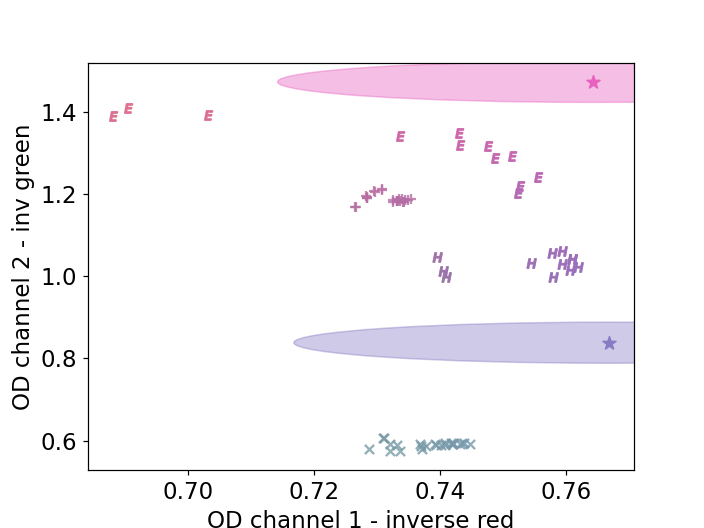

In [77]:
Result_dir = '/work/work_ysw/Deblur_Code/test_result/RGB_images_model_mse_sum_kl_test_al0/'
plotResults_Pol(Result_dir)

In [10]:
import glob
import matplotlib.pyplot as plt
from scipy.io import loadmat

RGB_dir= '/data/BasesDeDatos/Alsubaie/Data/RGB_images/'
GT_dir= '/data/BasesDeDatos/Alsubaie/Data/GroundTruth/'

#Cada iamgen tiene varios parches
image_patches=glob.glob(RGB_dir+'/*/*/*/*')
for image in image_patches[0:]:
    I_GT=plt.imread(image)
    GT_file=image.replace(RGB_dir,GT_dir)
    GT_file=GT_file.rsplit('/',2)[0]
    GT_file=glob.glob(GT_file+'/*SV.mat')[0]
    M_GT=loadmat(GT_file)
    print(image)
    print(GT_file)



/data/BasesDeDatos/Alsubaie/Data/RGB_images/Lung/2/01/01.png
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Lung/2/SV.mat
/data/BasesDeDatos/Alsubaie/Data/RGB_images/Lung/2/02/02.png
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Lung/2/SV.mat
/data/BasesDeDatos/Alsubaie/Data/RGB_images/Lung/1/01/01.png
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Lung/1/SV.mat
/data/BasesDeDatos/Alsubaie/Data/RGB_images/Lung/1/02/02.png
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Lung/1/SV.mat
/data/BasesDeDatos/Alsubaie/Data/RGB_images/Colon/7/01/01.bmp
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Colon/7/SV.mat
/data/BasesDeDatos/Alsubaie/Data/RGB_images/Colon/7/02/02.bmp
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Colon/7/SV.mat
/data/BasesDeDatos/Alsubaie/Data/RGB_images/Colon/6/01/01.bmp
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Colon/6/SV.mat
/data/BasesDeDatos/Alsubaie/Data/RGB_images/Colon/6/02/02.bmp
/data/BasesDeDatos/Alsubaie/Data/GroundTruth/Colon/6/SV.mat
/data/BasesDeDatos/Alsubaie/Data